# Chapter 14 - Adventures in Covariance

In [68]:
# setting up the environment
library(rethinking)
library(MASS)
library(ggplot2)
library(dagitty)
library(ape)

options(repr.plot.width = 16, repr.plot.height = 8)

Recall the robot from [[Chapter 13]] - it went to different cafes, ordered coffee, and recorded the wait times. That chapter focused on the fact that by using pooling, the robot could be more efficient at learning. We did that using [[Varying Intercepts Models]].

Now imagine that the wait time in the cafes is also influenced by what time you visit, morning or afternoon. We expect the wait time to be longer in the morning. The cafes will also vary in the *difference* between the morning and afternoon wait times. This is a question about the slope.

$$
\mu_i = \alpha_{\text{CAFE}[i]} + \beta_{\text{CAFE}[i]} A_i
$$

where $A_i$ is an indicator: 0 for morning, 1 for afternoon.

In the same way that the robot learned about the intercepts as it went along, we can also use pooling to learn about the different slopes.

Essence of the [[Varying Effects]] strategy: any batch of parameters with *exchangeable* index values can (and probably should) be pooled. *Exchangeable* indices just means that there's no real ordering; the indices are arbitrary numbers. In principle we could shuffle the intercepts and get the same results out of the model.

We can also get more information out of this, because cafes will *covary* in their intercepts and slopes. Why is this? Imagine a very busy cafe - in the morning it will be crazy busy with a long wait time, but in the afternoon not so much - there'll be a steep slope. For them, the slope is large and the intercept is high. But at a less busy cafe, the wait time will be short in the morning (it's not busy) and also in the afternoon (it remains not busy).

If we can figure out how to pool information across parameter types (sharing information between the slope and the intercept) then we can use information from e.g. the morning in order to improve our prediction about the afternoon. For instance, if the robot observes a very large wait at a particular cafe in the morning, then that should tell it something about the expected wait in the afternoon!

We'll see how to do this - specify the [[Varying Slopes]] along with the [[Varying Intercepts]] of [[Chapter 13]]. This approach will also help us to improve our intercepts model, since we can now use information from the slopes to add to our information about the intercepts (and vice versa).

Basically, varying slopes models are huge interaction machines - they allow everything in the model to have its own specific parameters while still borrowing information from the others.

We will use the same ideas later in the chapter to extend this to more subtle model types, including the use of continuous categories, using [[Gaussian Processes]]. Ordinary varying effects works only with discrete, unordered categories (like individuals, countries, or ponds). Each category is equally different from the others. However, we can use pooling with categories such as age or location - in these cases, some ages and some locations are more similar than others. We'll see how to model covariation among continuous categories of this kind, as well as how to generalize the strategy to seemingly unrelated types of models like phylogenetic and network regression. We'll also circle back to causal inference and go beyond what we learnt in [[Chapter 6]] by introducing [[Instrumental Variables]]. These are ways of inferring causes without closing backdoor paths.

> The material in this chapter is difficuly. So if it suddenly seems both conceptually and computationally much more difficult, that only means you are paying attention. Material like this requires repetition, discussion, and learning from mistakes. The struggle is definitely worth it. You don't have to understand it all at once.

## Varying slopes by construction

How should we pool the combined information? We want to model the *combined* population of slopes and intercepts. In a conventional [[Multilevel Model]] we would have two independent [[Normal]] distributions for the slope and the intercept. Instead, we're going to have a joint multivariate normal distribution for the varying effects, both slope and intercept.

We've secretly been working with multivariate normal distributions ever since [[Chapter 4]] - that's what the `quap` function did (fit a multivariate normal to the model). The variance-covariance matrix (`vcov`) for a fit model describes how each paramter's posterior is associated with those of the other parameters in the model.

let's simulate the coffee robot!

### Simulate the population

Let's define the population of cafes - average wait times in the morning and afternoon, as well as the correlation between them.

In [69]:
a <- 3.5 # average morning wait times
b <- -1 # average difference in the afternoon wait times
sigma_a <- 1 # std dev in intercepts
sigma_b <- 0.5 # std dev in slopes
rho <- -0.7 # correlation between intercepts and slopes

In order to make a multivariate normal distribution for the cafes, we need a vector of the two means as well as the variance-covariance matrix for the slope and intercept.

In [70]:
Mu <- c(a, b)

The variable `a` is the mean intercept (wait in the morning) and `b` is the mean slope, the difference in wait time between the morning and afternoon.

The variance-covariance matrix is a bit trickier:

$$
\left(
\begin{matrix}
\text{variance of intercepts} & \text{covariance of intercepts and slopes} \\
\text{covariance of intercepts and slopes} & \text{variance of slopes} \\
\end{matrix}
\right)
$$

or

$$
\left(
\begin{matrix}
\sigma_\alpha^2 & \sigma_\alpha \sigma_\beta \rho \\
\sigma_\alpha \sigma_\beta \rho & \sigma_\beta^2 \\
\end{matrix}
\right)
$$

There are two common ways to build a variance-covariance matrix; we'll use both. The first is to just use the `matrix` function. One thing to be aware of is that it builds the matrix column-first.

In [71]:
cov_ab <- sigma_a * sigma_b * rho
Sigma <- matrix(c(sigma_a ^ 2, cov_ab, sigma_b ^ 2, cov_ab), ncol = 2)

The other way to build the matrix is very useful because it treat the standard deviations and correlations separately and then multiplies them together to produce the variance-covariance matrix. This is useful later on when we're defining priors.

In [72]:
sigmas <- c(sigma_a, sigma_b) # standard deviations
Rho <- matrix(c(1, rho, rho, 1), nrow = 2) # correlation matrix

# matrix multiply to get the covariance matrix
Sigma <- diag(sigmas) %*% Rho %*% diag(sigmas)

`diag` puts the entries on the diagonal and 0s elsewhere:

In [73]:
diag(c(1, 2, 3))

1,0,0
0,2,0
0,0,3


So what we did above is

$$
\begin{align*}
    \overbrace{
    \begin{pmatrix}
        \sigma_a & 0 \\
        0 & \sigma_b
    \end{pmatrix}}^{\text{diag(sigmas)}}

    \ast

    \overbrace{
    \begin{pmatrix}
        1 & \rho \\
        \rho & 1
    \end{pmatrix}
    } ^ {\text{Rho}}

    \ast

    \overbrace{
    \begin{pmatrix}
        \sigma_a & 0 \\
        0 & \sigma_b
    \end{pmatrix}
    } ^ {\text{diag(sigmas)}}

    &=

    \begin{pmatrix}
    \sigma_\alpha & \rho \sigma_\alpha\\
    \sigma_\beta \rho & \sigma_\beta 
    \end{pmatrix}

    \ast

    \begin{pmatrix}
        \sigma_a & 0 \\
        0 & \sigma_b
    \end{pmatrix}

    \\

    &=
    \begin{pmatrix}
    \sigma_\alpha ^ 2 & \rho \sigma_\alpha \sigma_\beta \\
    \sigma_\alpha \sigma_\beta \rho & \sigma_\beta ^ 2
    \end{pmatrix}
\end{align*}
$$

Now we just need to simulate from the cafes

In [74]:
N_cafes <- 20

set.seed(5)
vary_effects <- mvrnorm(N_cafes, Mu, Sigma)
vary_effects

4.223962,-1.6093565
2.010498,-0.7517704
4.565811,-1.9482646
3.343635,-1.1926539
1.700971,-0.5855618
4.134373,-1.1444539
3.794469,-1.6264661
3.946598,-1.7152794
3.864267,-0.9071677
3.467614,-0.6804054
2.242875,-0.6181516


This is a matrix of 20 cafes (rows), each with an intercept and slope. For ease, let's slip these into nicelay named vectors:

In [75]:
a_cafe <- vary_effects[, 1]
b_cafe <- vary_effects[, 2]

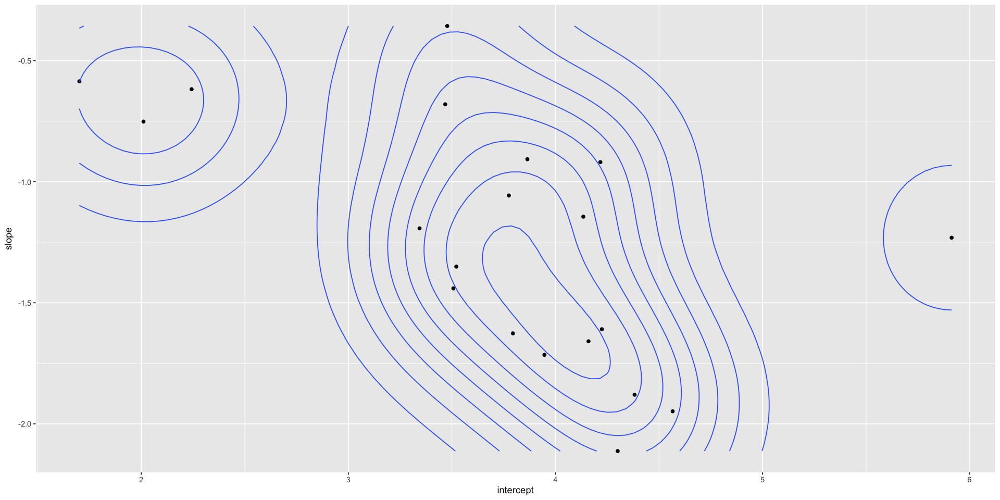

In [76]:
plot_df <- data.frame(
    intercept = a_cafe,
    slope = b_cafe
)

ggplot(plot_df, aes(intercept, slope)) +
    geom_point() +
    geom_density2d()

### Simulate observations

Now we want to simulate the robot gathering the data. We'll simulate 10 visits to each cafe, 5 in the morning and 5 in the afternoon.

In [77]:
set.seed(22)
N_visits <- 10
afternoon <- rep(0:1, N_visits * N_cafes / 2)
cafe_id <- rep(1:N_cafes, each = N_visits)
mu <- a_cafe[cafe_id] + b_cafe[cafe_id] * afternoon
sigma <- 0.5 # sd within cafes
wait <- rnorm(N_visits * N_cafes, mu, sigma)
d <- data.frame(cafe = cafe_id, afternoon = afternoon, wait = wait)

These data are obviously clusterable by cafe. We can estimate the intercept for the cluster as well as for the slope.

In this case the data are balanced (same number of visits to each cafe in the morning and afternoon), but there's no reason that would need to be the case.

### The varying slopes model

Now we play the process in reverse! Here's the model - it looks a bit different from the previous ones because we are using explicit vectors / matrices now.

$$
\begin{align*}
W_i &\sim \text{Normal}(\mu_i, \sigma) & \text{likelihood} \\
\mu_i &= \alpha_{\text{CAFE}[i]} + \beta_{\text{CAFE}[i]} A_i & \text{linear model} \\
\begin{pmatrix} \alpha_{\text{CAFE}} \\ \beta_{\text{CAFE}} \end{pmatrix} &\sim \text{MVNormal} \left( 
    \begin{pmatrix} \alpha \\ \beta \end{pmatrix}, \textbf{S}
\right) & \text{population of varying effects} \\
\textbf{S} &= \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} \textbf{R} \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} & \text{construct the covariance matrix} \\
\end{align*}
$$

This says that each cafe has an intercept $\alpha$ and a slope $\beta$ with a prior defined by a 2D multivariate normal distribution with means $\alpha$ and $\beta$ and a covariance matrix $\textbf{S}$.

> This statement of prior will adaptively regularize the individual intercepts, slopes, and the correlation among them.

The next like defines how we're constructing the correlation matrix $\textbf{S}$ by factoring it into the separate standard deviations $\sigma_\alpha$ and $\sigma_\beta$ and the correlation matrix $\textbf{R}$.

Now we'll add in the hyperpriors.

$$
\begin{align*}
\alpha &\sim \text{Normal}(5, 2) & \text{[prior for average intercept]} \\
\beta &\sim \text{Normal}(-1, 0.5) & \text{[prior for average slope]} \\
\sigma &\sim \text{Exponential}(1) & \text{[prior stddev within cafes]} \\
\sigma_\alpha &\sim \text{Exponential}(1) & \text{[prior stddev among intercepts]} \\
\sigma_\beta &\sim \text{Exponential}(1) & \text{[prior stddev among slopes]} \\
\textbf{R} &\sim \text{LKJcorr}(2) & \text{[prior for correlation matrix]} \\
\end{align*}
$$

That last line is really weird. We need a prior for the correlation matrix $\textbf{R}$. In many cases it will be very tricky, but for us it's pretty easy - the matrix just looks like

$$
\begin{pmatrix}
1 & \rho \\
\rho & 1 \\
\end{pmatrix}
$$

where $\rho$ is the correlation between intercepts and slopes. Really, we just have one parameter to define a prior over.

So what is LKJcorr? Essentially, it's a prior for correlation matrices. LKJcorr(2) is weakly informative on $\rho$ and is sceptical of correlations near 1 or -1. It's a regularizing prior for correlation matrices.

The LKJcorr distribution has a single parameter, $\eta$, which controls exactly how sceptical the distribution is of large correlations. LKJcorr(1) is flat; when $\eta > 1$, it is sceptical of large correlations.

In [78]:
R2 <- rlkjcorr(1e4, K = 2, eta = 2)
dims(R2)

[1] 3

In [79]:
length(R2)

[1] 40000

In [80]:
R2[1, , ]

1.0000000,0.3895492
0.3895492,1.0000000


So this is actually 1e4 2x2 correlation matrices.

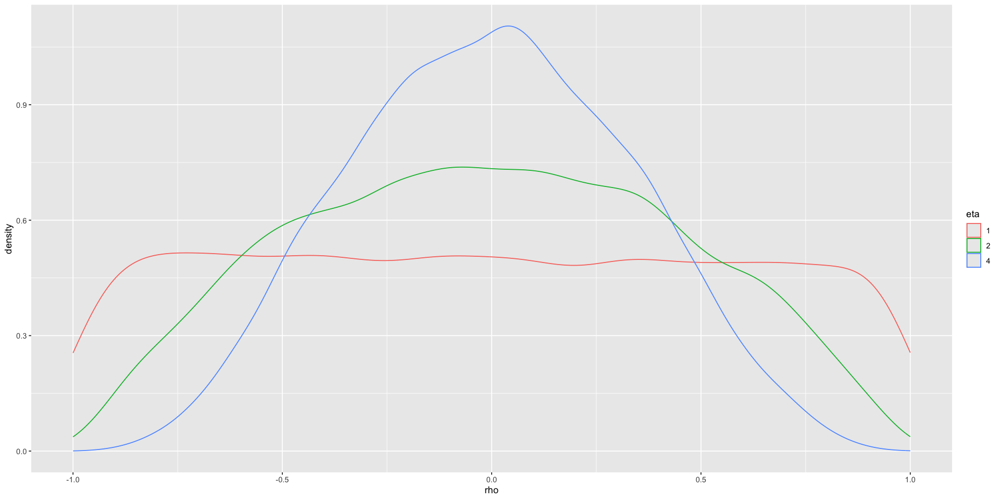

In [81]:
R1 <- rlkjcorr(1e4, K = 2, eta = 1)
R4 <- rlkjcorr(1e4, K = 2, eta = 4)

plot_df <- rbind(
    data.frame(rho = R1[, 1, 2], eta = 1),
    data.frame(rho = R2[, 1, 2], eta = 2),
    data.frame(rho = R4[, 1, 2], eta = 4)
)
plot_df$eta <- as.factor(plot_df$eta)
ggplot(plot_df, aes(rho, group = eta, colour = eta)) +
    geom_density()

In [82]:
# now let's fit the model!
set.seed(867530)
m14.1 <- ulam(
    alist(
        wait ~ normal(mu, sigma),
        mu <- a_cafe[cafe] + b_cafe[cafe] * afternoon,
        c(a_cafe, b_cafe)[cafe] ~ multi_normal(c(a, b), Rho, sigma_cafe),
        a ~ normal(5, 2),
        b ~ normal(-1, 0.5),
        sigma_cafe ~ exponential(1),
        sigma ~ exponential(1),
        Rho ~ lkj_corr(2)
    ),
    data = d,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1ed3b8db.stan', line 17, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 



Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1ed3b8db.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1ed3b8db.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1ed3b8db.stan', line 17, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1ed3b8db.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1ed3b8db.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 8

`multi_normal` is a multivariate normal which takes a vector of means, a correlation matrix, and a vector of standard deviations. It constructs the covariance matrix internally. The name `multi_normal` is what [[Stan]] uses internally; the equivalent R functions are `dmvnorm` and `dmvnorm2`.

In [83]:
stancode(m14.1)

data{
     vector[200] wait;
    array[200] int afternoon;
    array[200] int cafe;
}
parameters{
     vector[20] b_cafe;
     vector[20] a_cafe;
     real a;
     real b;
     vector<lower=0>[2] sigma_cafe;
     real<lower=0> sigma;
     corr_matrix[2] Rho;
}
model{
     vector[200] mu;
    Rho ~ lkj_corr( 2 );
    sigma ~ exponential( 1 );
    sigma_cafe ~ exponential( 1 );
    b ~ normal( -1 , 0.5 );
    a ~ normal( 5 , 2 );
    {
    array[20] vector[2] YY;
    vector[2] MU;
    MU = [ a , b ]';
    for ( j in 1:20 ) YY[j] = [ a_cafe[j] , b_cafe[j] ]';
    YY ~ multi_normal( MU , quad_form_diag(Rho , sigma_cafe) );
    }
    for ( i in 1:200 ) {
        mu[i] = a_cafe[cafe[i]] + b_cafe[cafe[i]] * afternoon[i];
    }
    wait ~ normal( mu , sigma );
}



Instead of looking at the posterior distributions, let's examine the posterior of the varying effects.

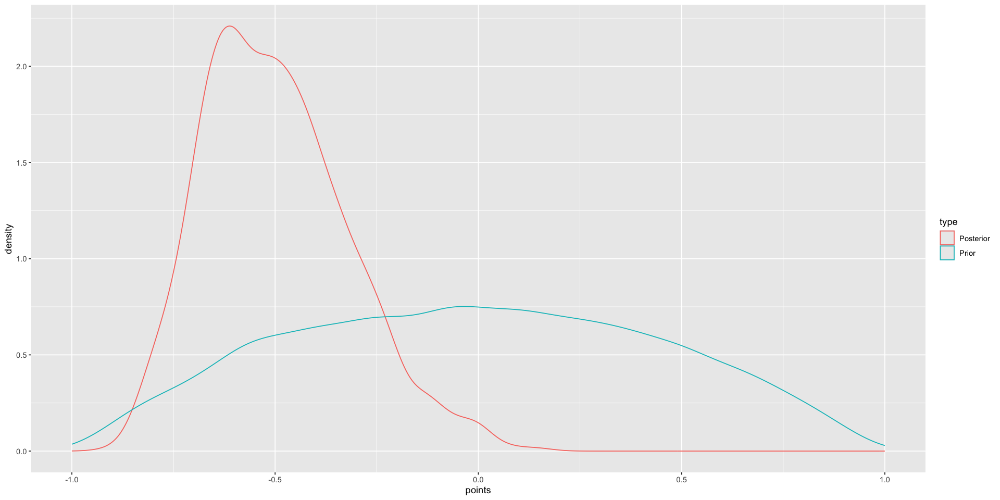

In [84]:
post <- extract.samples(m14.1)

prior_rho <- rlkjcorr(1e4, K = 2, eta = 2)

plot_df <- rbind(
    data.frame(points = post$Rho[, 1, 2], type = 'Posterior'),
    data.frame(points = prior_rho[, 1, 2], type = 'Prior')
)
ggplot(plot_df, aes(points, colour = type, group = type)) + 
    geom_density() + 
    scale_x_continuous(limits = c(-1, 1))

Since our true correlation value is -0.7, this looks like it's in the correct range!

Now let's look at the shrinkage. The multilevel model estimates posterior distributions for the intercepts and slopes of each cage. The correlation between these was used to pool information between the two cafes. This is the same kind of process as how the models shares information among the pooled intercepts and the pooled slopes. The variances and correlation deine and inferred multivariate Gaussian prior for the varying effects. This prior, which is learned from the data, adaptively regularizes both the intercepts and slopes.

To see the shrinkage, let's plot the posterior mean varying effects. Then we can compare them to raw, unpooled estimates. We'll also show the contours of the inferred prior - the population of intercepts and slopes - to help us visualize the shrinkage.

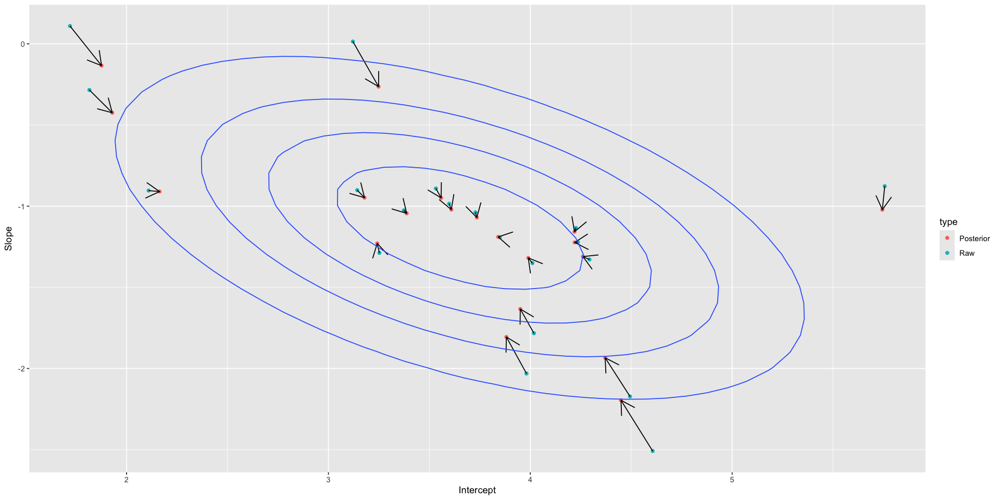

In [85]:
# unpooled estimates directly from the data
a1 <- sapply(1:N_cafes, function(i) mean(wait[cafe_id == i & afternoon == 0])) # intercept = morning wait time
b1 <- sapply(1:N_cafes, function(i) mean(wait[cafe_id == i & afternoon == 1])) - a1 # afternoon - morning

# extract the posterior means of the partially pooled estimates
post <- extract.samples(m14.1)
a2 <- apply(post$a_cafe, 2, mean)
b2 <- apply(post$b_cafe, 2, mean)

# getting the levels of the multivariate normal
Mu_est <- c(mean(post$a), mean(post$b))
rho_est <- mean(post$Rho[, 1, 2])
sa_est <- mean(post$sigma_cafe[, 1])
sb_est <- mean(post$sigma_cafe[, 2])
cov_ab <- sa_est * sb_est * rho_est
Sigma_est <- matrix(c(sa_est ^ 2, cov_ab, cov_ab, sb_est^2), ncol = 2)
prob_a <- seq(min(a2) - 1, max(a2) + 1, by = 0.1)
prob_b <- seq(min(b2) - 1, max(b2) + 1, by = 0.1)
prob_grid <- expand.grid(prob_a, prob_b)
probs <- dmvnorm(prob_grid, mean = Mu_est, sigma = Sigma_est)
probs_df <- data.frame(
    a = prob_grid[, 1],
    b = prob_grid[, 2],
    prob = probs
)

plot_df <- rbind(
    data.frame(a = a1, b = b1, type = "Raw"),
    data.frame(a = a2, b = b2, type = "Posterior")
)
ggplot(plot_df, aes(a, b)) +
    geom_point(aes(group = type, colour = type)) +
    geom_segment(data = data.frame(x = a1, y = b1, xend = a2, yend = b2), mapping = aes(x = x, y = y, xend = xend, yend = yend), arrow = arrow()) +
    geom_contour(data = probs_df, mapping = aes(z = prob), bins = 5) +
    labs(x = "Intercept", y = "Slope")

Just like before, we see shrinkage going from the raw to the posterior values. Values farther away from the mean are less plausible, and so they experience more shrinkage. However, notice that it's not just shrinking toward the mean. For instance, the cafe on the far right of the graph has an average slope but really high intercept. As the intercept shrinks, the correlation with the slope kicks in, resulting in the weird downward movement that we see.

We can create the same kind of graph on the outcome scale.

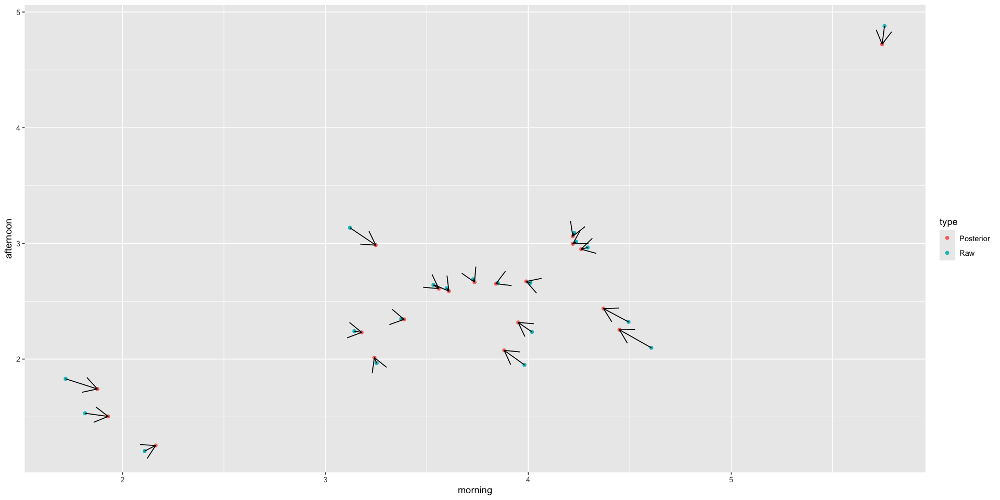

In [86]:
# convert varying effects to wait times
wait_morning_1 <- a1
wait_afternoon_1 <- a1 + b1
wait_morning_2 <- a2
wait_afternoon_2 <- a2 + b2

lines_df <- data.frame(
    wait_morning_1 = wait_morning_1,
    wait_afternoon_1 = wait_afternoon_1,
    wait_morning_2 = wait_morning_2,
    wait_afternoon_2 = wait_afternoon_2
)
plot_df <- rbind(
    data.frame(morning = wait_morning_1, afternoon = wait_afternoon_1, type = "Raw"),
    data.frame(morning = wait_morning_2, afternoon = wait_afternoon_2, type = "Posterior")
)

p <- ggplot(plot_df, aes(morning, afternoon)) +
    geom_point(aes(group = type, colour = type)) +
    geom_segment(data = lines_df, mapping = aes(x = wait_morning_1, y = wait_afternoon_1, xend = wait_morning_2, yend = wait_afternoon_2), arrow = arrow())
print(p)

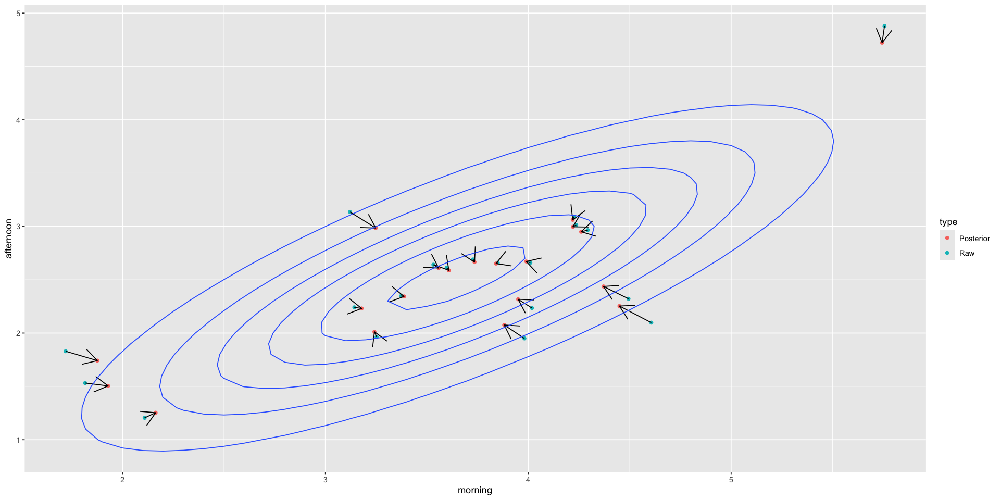

In [87]:
# now the shrinkage
v <- mvrnorm(1e4, Mu_est, Sigma_est)
v[, 2] <- v[, 1] + v[, 2] # calculating the afternoon wait
Sigma_est2 <- cov(v)
Mu_est2 <- Mu_est
Mu_est2[2] <- Mu_est[1] + Mu_est[2]

prob_a <- seq(1, 6, by = 0.1)
prob_b <- seq(0, 6, by = 0.1)
grid <- expand.grid(prob_a, prob_b)
probs <- dmvnorm(grid, Mu_est2, Sigma_est2)

probs_df <- data.frame(morning = grid[, 1], afternoon = grid[, 2], z = probs)

p + geom_contour(data = probs_df, mapping = aes(morning, afternoon, z = z))

## Advanced varying slopes

Now we're going to look at a model with more than two varying effects - varying intercepts plus more than one varying slope - plus more than one type of cluster. We'll look at the chimpanzee data again. Recall that we created a [[Cross-Classified Model]] with different clusters, one for the actor and one for the day that the testing took place. We also used two different slopes: one for the side with the prosocial option and the other for the interaction between the option and the presence of another chimpanzee.

This model will also highlight the importance of non-centred parameterizations.

Because this model is complex, we're going to break it down into sub-models by creating more than one linear model in the formulae.

$$
\begin{align*}
L_i &\sim \text{Binomial}(1, p_i) \\
\text{logit}(p_i) &= \gamma_{\text{TID}[i]} + \alpha_{\text{ACTOR}[i], \text{TID}[i]} + \beta_{\text{BLOCK}[i], \text{TID}[i]} \\
\end{align*}
$$

This linear model contains 
- an average log-odds for each treatment, $\gamma_{\text{TID}[i]}$
- an effect for each actor in each treatment $\alpha_{\text{ACTOR}[i], \text{TID}[i]}$
- an effect for each block in each treatment, $\beta_{\text{BLOCK}[i], \text{TID}[i]}$

This is an interaction model that allows the effect of each treatment to vary by actor and by block. That is, that average treatment effect can vary by block, and each individual chimpanzee can also respond (across blocks) to each treatment differently. That means that we have $4 + 7 \ast 4 + 6 \ast 4 = 56$ parameters for our model. Pooling is really needed here!

The next part of the model is the adaptive priors. Since we have two clusters, that means that we have two multivariate [[Gaussian]] priors. The priors are both 4-dimensional because there are four different treatments (left or right, other chimpanzee present or not). In general, you can have different varying effects in different cluster types. Here are the priors.

$$
\begin{bmatrix}
\alpha_{j, 1} \\
\alpha_{j, 2} \\
\alpha_{j, 3} \\
\alpha_{j, 4} \\
\end{bmatrix} \sim \text{MVNormal}\left( 
    \begin{bmatrix}
        0 \\ 0 \\ 0 \\ 0
    \end{bmatrix}, \textbf{S}_{\text{ACTOR}}
\right)
$$

and

$$
\begin{bmatrix}
\beta_{j, 1} \\
\beta_{j, 2} \\
\beta_{j, 3} \\
\beta_{j, 4} \\
\end{bmatrix} \sim \text{MVNormal}\left( 
    \begin{bmatrix}
        0 \\ 0 \\ 0 \\ 0
    \end{bmatrix}, \textbf{S}_{\text{BLOCK}}
\right)
$$

These priors encode the fact that we believe that the actors and blocks come from different statistical populations. Within each of these, the 4 features of each block / actor are related through a covariance matrix $\textbf{S}$ which is specific to that population (actors or blocks). The means for these are 0 because we already placed an average effect in $\gamma$.

The `ulam` code looks like you'd expect.

In [88]:
data(chimpanzees)
d <- chimpanzees
d$block_id <- d$block
d$treatment <- 1L + d$prosoc_left + 2L * d$condition

data <- list(
    L = d$pulled_left,
    tid = d$treatment,
    actor = d$actor,
    block_id = as.integer(d$block_id)
)

set.seed(4387510)

m14.2 <- ulam(
    alist(
        L ~ dbinom(1, p),
        logit(p) <- g[tid] + alpha[actor, tid] + beta[block_id, tid],

        # adaptive priors
        vector[4]:alpha[actor] ~ multi_normal(0, Rho_actor, sigma_actor),
        vector[4]:beta[block_id] ~ multi_normal(0, Rho_block, sigma_block),

        # fixed priors
        g[tid] ~ dnorm(0, 1),
        sigma_actor ~ dexp(1),
        Rho_actor ~ dlkjcorr(4),
        sigma_block ~ dexp(1),
        Rho_block ~ dlkjcorr(4)
    ),
    data = data,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 18, column 4 to column 30)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 18, column 4 to column 30)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable t

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 18, column 4 to column 30)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 18, column 4 to column 30)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 18, column 4 to column 30)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 18, column 4 to column 30)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable t

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 18, column 4 to column 30)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 18, column 4 to column 30)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[2,4] = 3.03383e+08, but Covariance matrix[4,2] = 3.03383e+08 (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e31ee0398.stan', line 23, column 4 to column 85)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 3 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 1 finished in 3

See https://mc-stan.org/misc/warnings for details.


See https://mc-stan.org/misc/warnings for details.




Waiting to draw page 2 of 7

Waiting to draw page 3 of 7



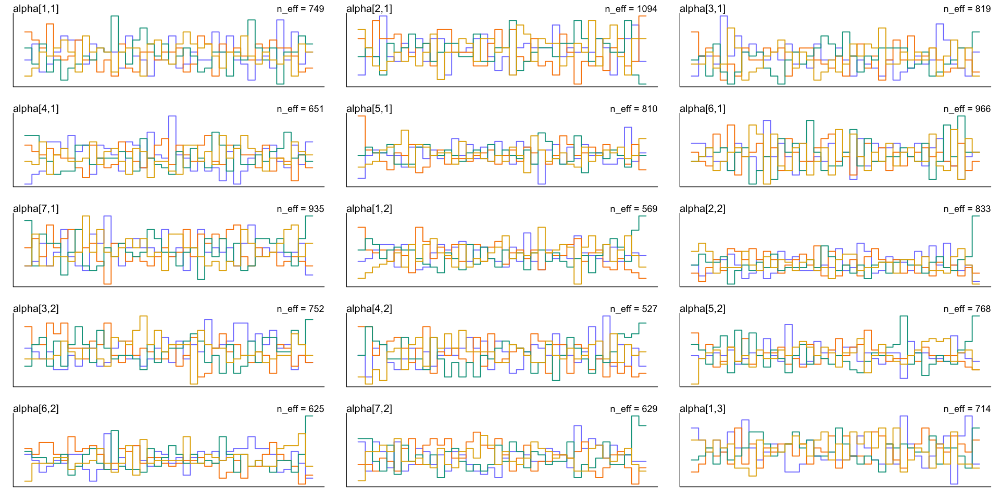

Waiting to draw page 4 of 7



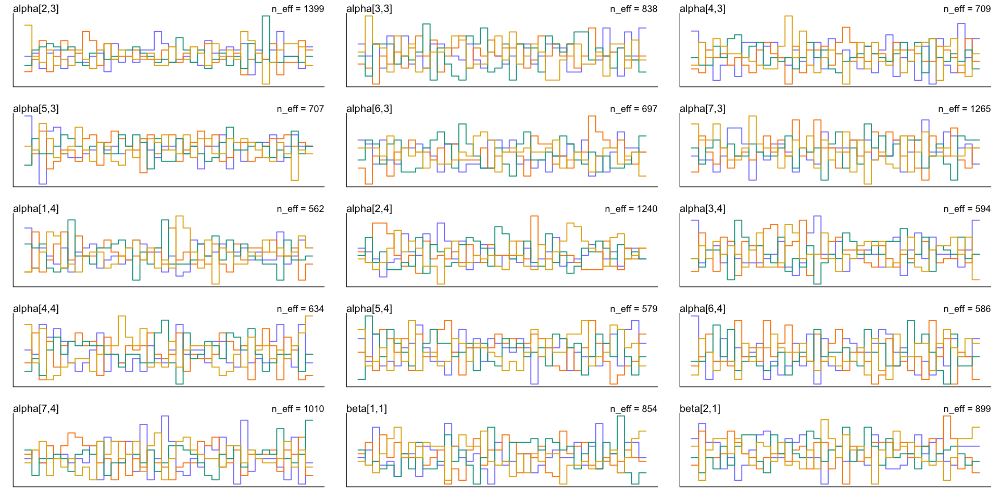

Waiting to draw page 5 of 7



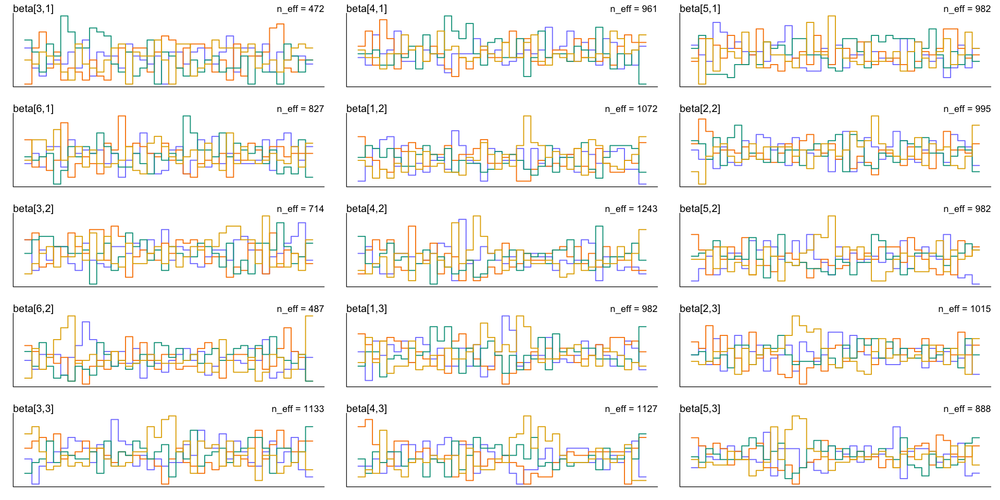

Waiting to draw page 6 of 7



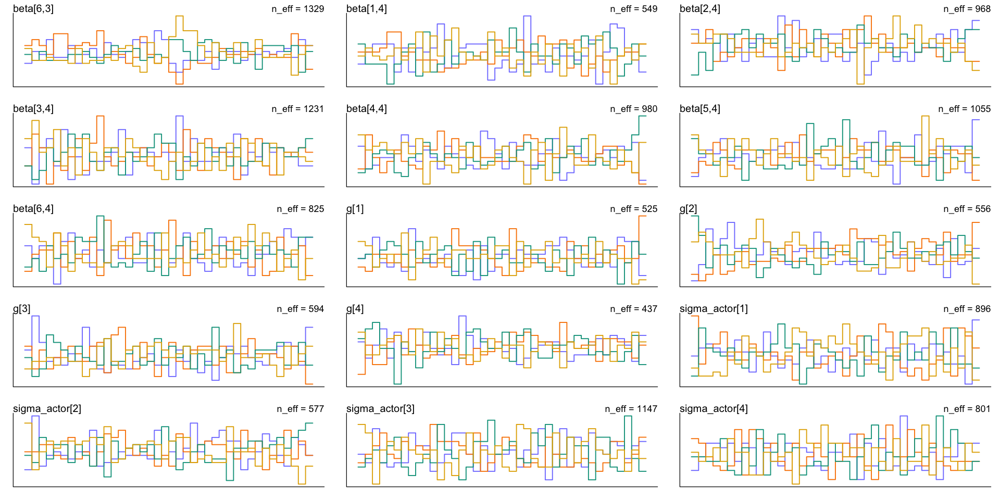

Waiting to draw page 7 of 7



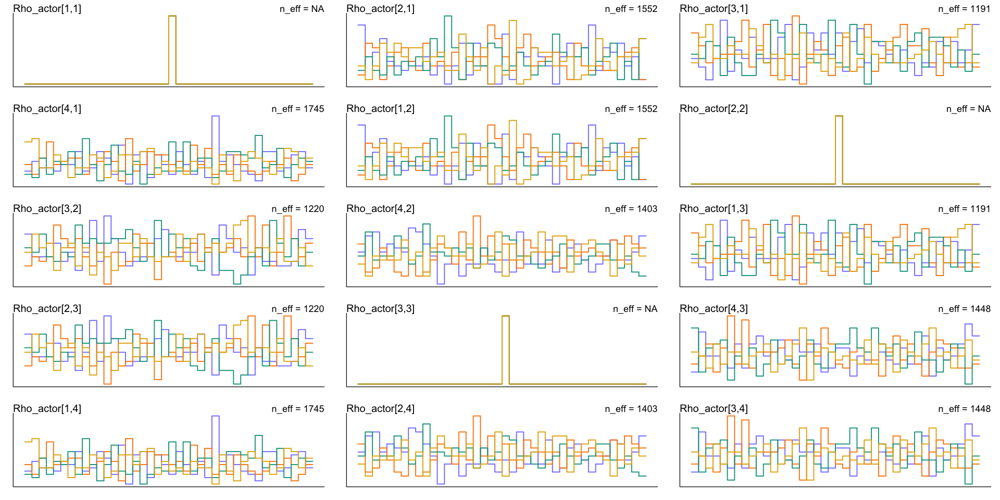

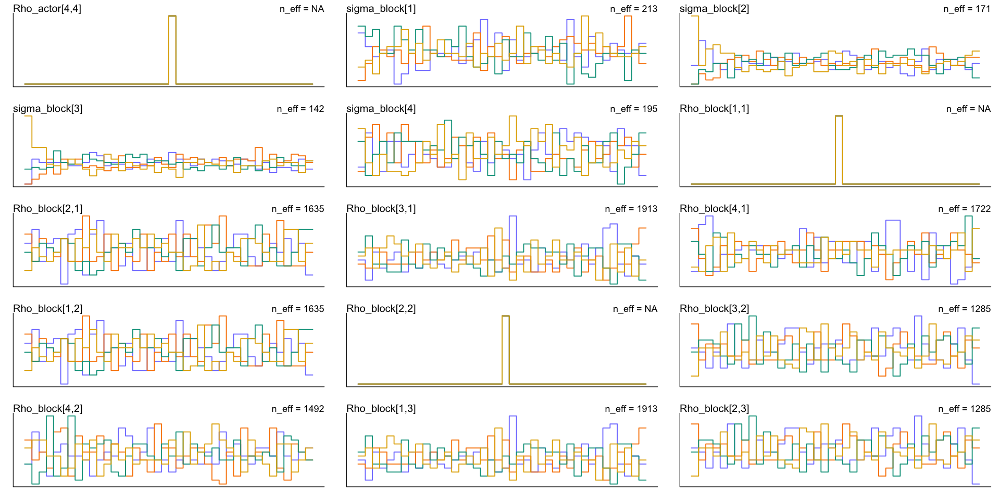

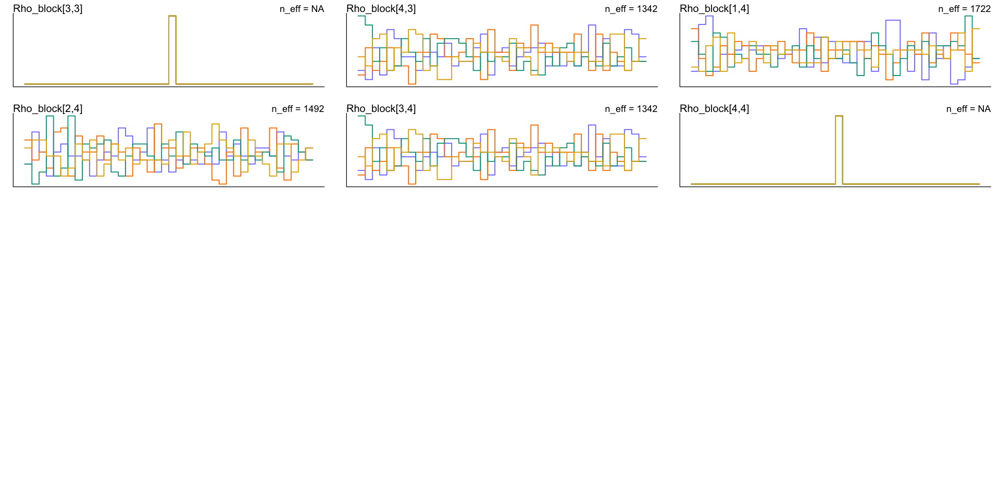

In [89]:
par(bg = 'white')
trankplot(m14.2)

Waiting to draw page 2 of 7

Waiting to draw page 3 of 7



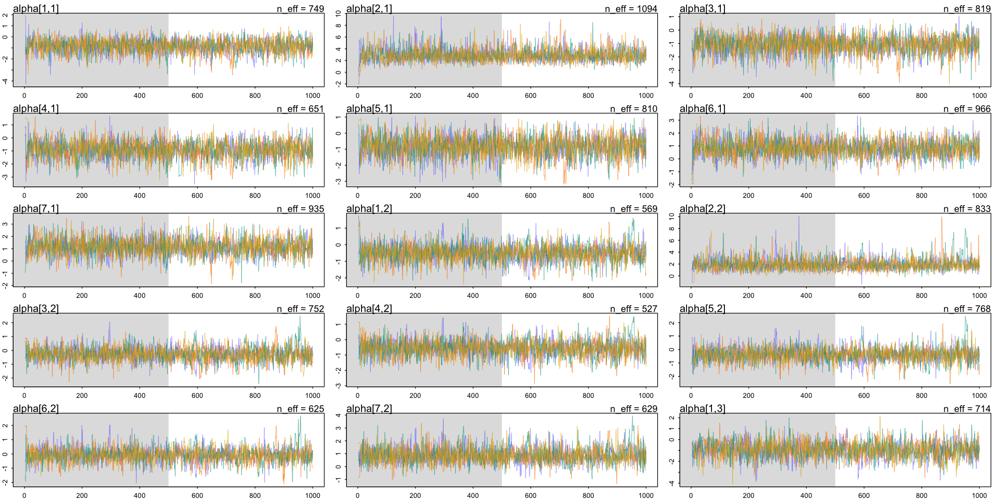

Waiting to draw page 4 of 7



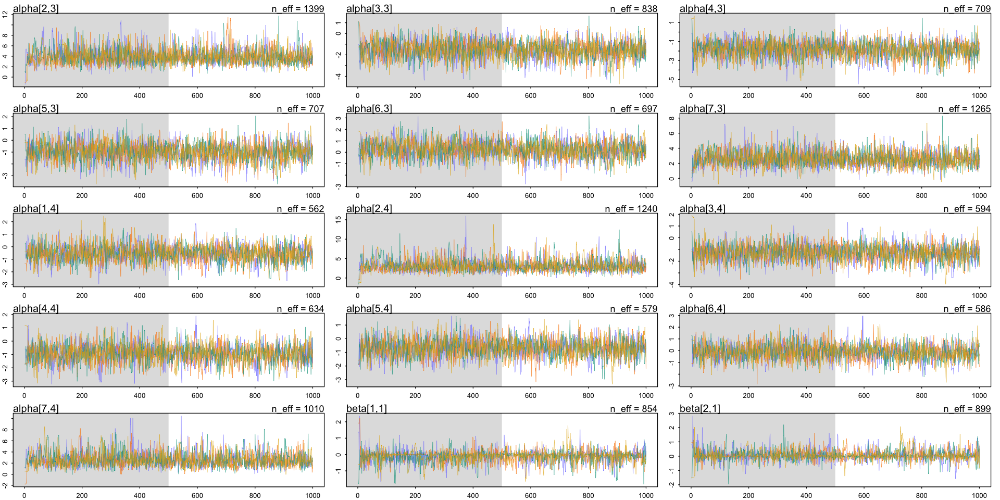

Waiting to draw page 5 of 7



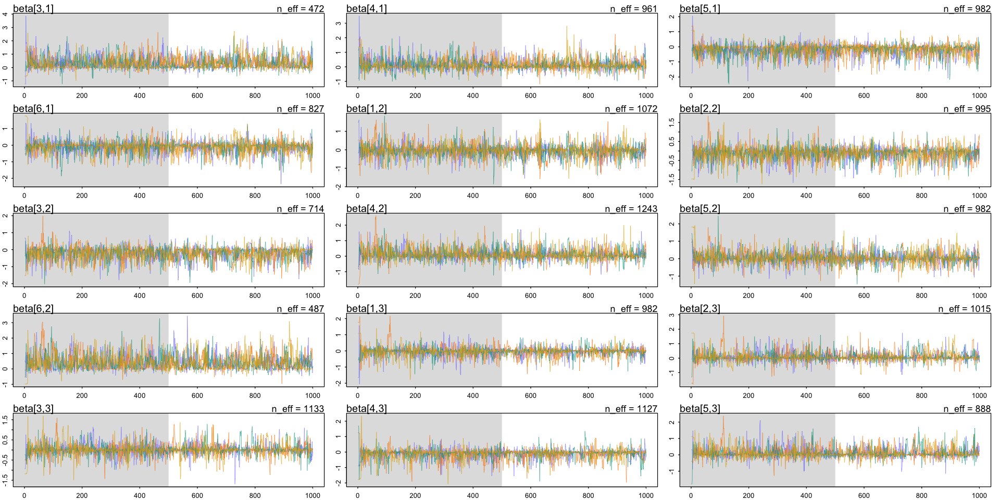

Waiting to draw page 6 of 7



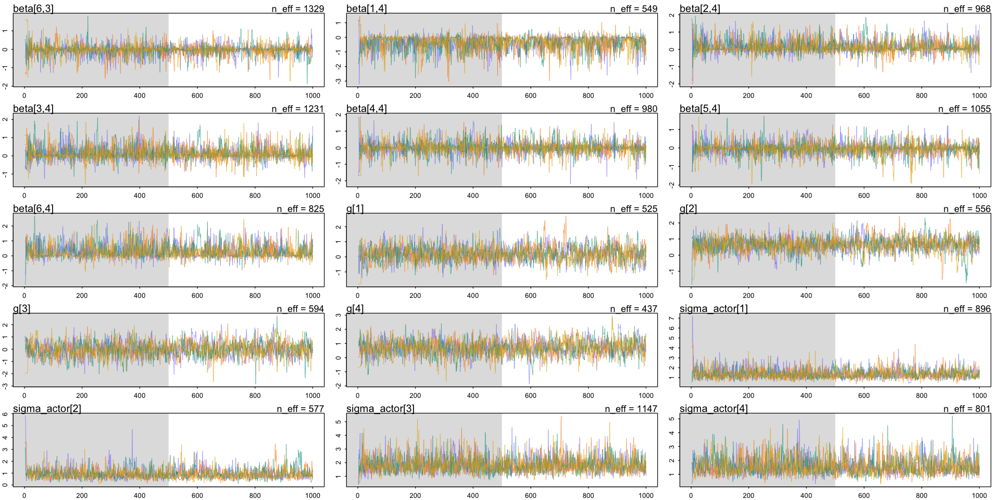

Waiting to draw page 7 of 7



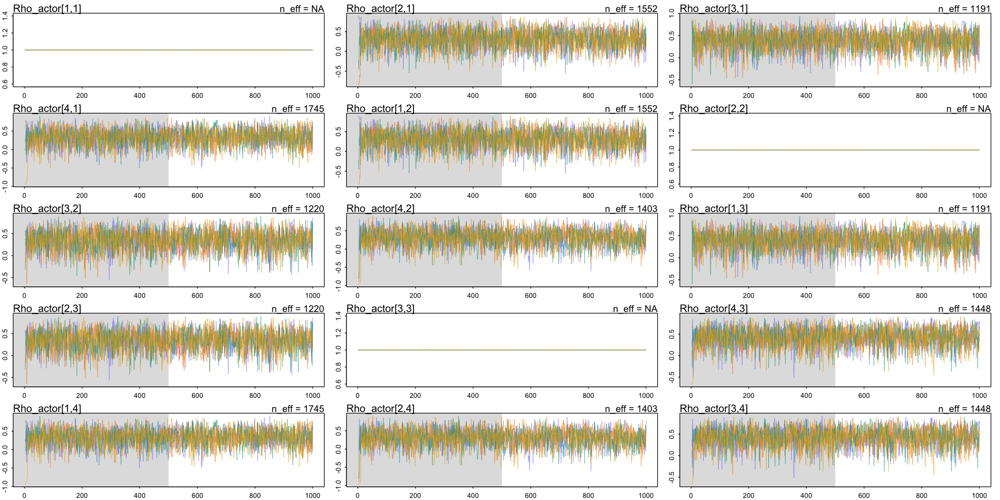

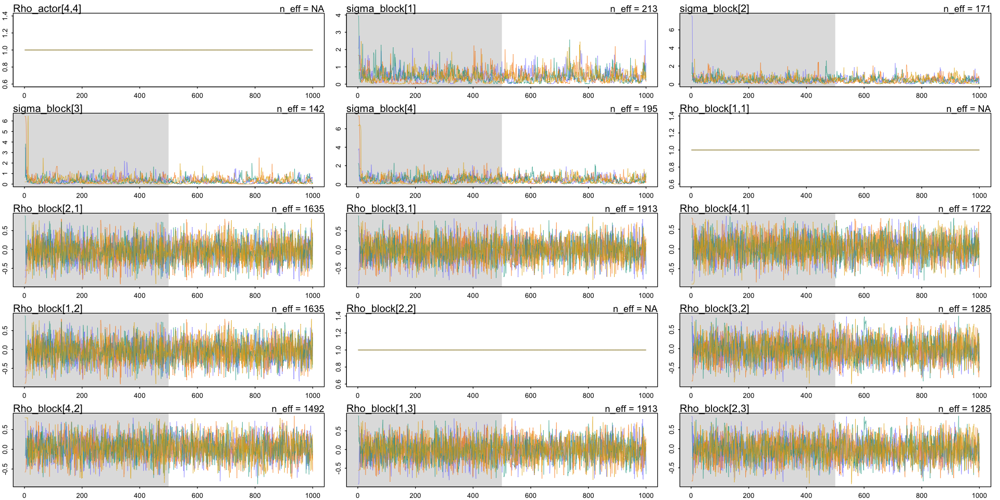

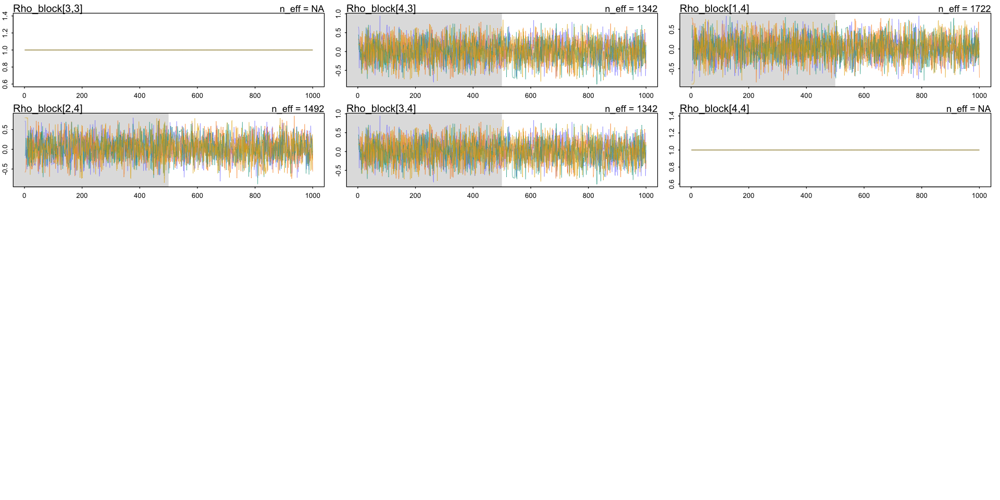

In [90]:
par(bg = 'white')
traceplot(m14.2)

There were a bunch of divergent transitions, and some of these plots (particularly the sigma ones) don't look like we have good mixing. Just like [[last chapter]], our plan here is going to be to factor all of the parameters out of the adaptive priors and put them into the linear model. But how do we do that now that there are covariance matrices involved?

Same basic idea, but now with matrices. Just like before, we're going to make $z$-scores for each random effect. But now we need a matrix of $z$ scores. Then we'll multiply those scores back into the covariance matrix so that we get back the random effects on the right scale.

There's a special matrix algebra trick for this, which `ulam` has encapsulated into `compose_noncentered`.

In [91]:
set.seed(4387510)

m14.3 <- ulam(
    alist(
        L ~ dbinom(1, p),
        logit(p) <- g[tid] + alpha[actor, tid] + beta[block_id, tid],

        # adaptive priors - non-centred
        # vector[4]:alpha[actor] ~ multi_normal(0, Rho_actor, sigma_actor),
        # vector[4]:beta[block_id] ~ multi_normal(0, Rho_block, sigma_block),
        transpars> matrix[actor, 4]:alpha <- compose_noncentered(sigma_actor, L_Rho_actor, z_actor),
        transpars> matrix[block_id,4]:beta <- compose_noncentered(sigma_block, L_Rho_block, z_block),
        matrix[4,actor]:z_actor ~ normal(0, 1),
        matrix[4,block_id]:z_block ~ normal(0, 1),

        # fixed priors
        g[tid] ~ dnorm(0, 1),
        # sigma_actor ~ dexp(1),
        vector[4]:sigma_actor ~ dexp(1),
        # Rho_actor ~ dlkjcorr(4),
        cholesky_factor_corr[4]:L_Rho_actor ~ lkj_corr_cholesky(2),
        # sigma_block ~ dexp(1),
        vector[4]:sigma_block ~ dexp(1),
        cholesky_factor_corr[4]:L_Rho_block ~ lkj_corr_cholesky(2),
        # Rho_block ~ dlkjcorr(4)

        # compute ordinary correlation matrices from Cholesky factors
        gq> matrix[4,4]:Rho_actor <<- Chol_to_Corr(L_Rho_actor),
        gq> matrix[4,4]:Rho_block <<- Chol_to_Corr(L_Rho_block)
    ),
    data = data,
    chains = 4,
    cores = 4,
    log_lik = TRUE
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_cholesky_lpdf: Random variable[4] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 24, column 4 to column 41)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_cholesky_lpdf: Random variable[4] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 24, column 4 to column 41)

Chain 1 If this warning occurs sporadically, such as for highly 

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_cholesky_lpdf: Random variable[3] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 24, column 4 to column 41)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_cholesky_lpdf: Random variable[3] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 24, column 4 to column 41)

Chain 2 If this warning occurs sporadically, such as for highly 

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 26, column 4 to column 41)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 26, column 4 to column 41)

Chain 3 If this warning occurs sporadically, such as for highly 

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_cholesky_lpdf: Random variable[4] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 24, column 4 to column 41)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_cholesky_lpdf: Random variable[4] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 24, column 4 to column 41)

Chain 4 If this warning occurs sporadically, such as for highly 

Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_cholesky_lpdf: Random variable[3] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 26, column 4 to column 41)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_cholesky_lpdf: Random variable[3] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6279af5e.stan', line 26, column 4 to column 41)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 4 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 2 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 4 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 4 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 2 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 3 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 2 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 4 

In [92]:
stancode(m14.3)

data{
    array[504] int L;
    array[504] int block_id;
    array[504] int actor;
    array[504] int tid;
}
parameters{
     matrix[4,7] z_actor;
     matrix[4,6] z_block;
     vector[4] g;
     vector<lower=0>[4] sigma_actor;
     cholesky_factor_corr[4] L_Rho_actor;
     vector<lower=0>[4] sigma_block;
     cholesky_factor_corr[4] L_Rho_block;
}
transformed parameters{
     matrix[7,4] alpha;
     matrix[6,4] beta;
    beta = (diag_pre_multiply(sigma_block, L_Rho_block) * z_block)';
    alpha = (diag_pre_multiply(sigma_actor, L_Rho_actor) * z_actor)';
}
model{
     vector[504] p;
    L_Rho_block ~ lkj_corr_cholesky( 2 );
    sigma_block ~ exponential( 1 );
    L_Rho_actor ~ lkj_corr_cholesky( 2 );
    sigma_actor ~ exponential( 1 );
    g ~ normal( 0 , 1 );
    to_vector( z_block ) ~ normal( 0 , 1 );
    to_vector( z_actor ) ~ normal( 0 , 1 );
    for ( i in 1:504 ) {
        p[i] = g[tid[i]] + alpha[actor[i], tid[i]] + beta[block_id[i], tid[i]];
        p[i] = inv_logit(p[i]);
    

So no more divergent transitions and the sampling time is down! A couple of things to note:
- The last two lines of the model compute the ordinary correlation matrices from the [[Cholesky factors]]
- The `gq>` tells [[Stan]] to do the calculation only at the end of each transition (for efficiency)

More details on what exactly is going on here later.

If you could see the `n_eff` for each of the models, you would see that they're consistently higher for the non-centred model.

We can inspect the standard deviation parameters to see how the varying effects are being regularized.

In [93]:
precis(m14.3, depth = 2, pars = c("sigma_actor", "sigma_block"))

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
sigma_actor[1],1.3817074,0.5021779,0.76991270,2.2438470,1.0021715,1156.9911
sigma_actor[2],0.9062417,0.4078890,0.42179091,1.6178676,1.0061085,970.2338
sigma_actor[3],1.8303486,0.5378559,1.12119865,2.7899465,1.0007552,1501.6205
sigma_actor[4],1.5638199,0.5907403,0.83591280,2.6255128,1.0007113,1464.7692
sigma_block[1],0.4244089,0.3324763,0.03395725,1.0092800,0.9998937,1095.3545
sigma_block[2],0.4309564,0.3369151,0.03487129,1.0474588,1.0053989,802.3675
sigma_block[3],0.2982851,0.2667096,0.02113108,0.7899849,1.0007218,1066.7296
sigma_block[4],0.4835285,0.3836698,0.04181097,1.1684285,1.0032682,1091.7644


From the small values we're seeing here (especially in `sigma_block`) we get the sense that the shrinkage is fairly aggressive.

This is a good example of how varying effects adapt to the data. The risk of overfitting is reduced as compared to a regular fixed effects model. It can be challenging to define and fit these models. If you don't check for variation in the slopes, you may never notice it. Even if the average slope is almost zero, there might be substantial variation in slopes across clusters.

Let's look at the posterior predictions against the average for each actor and each treatment, as we did in [[Chapter 11]]. We'll use block number 5 because it has almost zero effect and we want to average over blocks in this visualization.

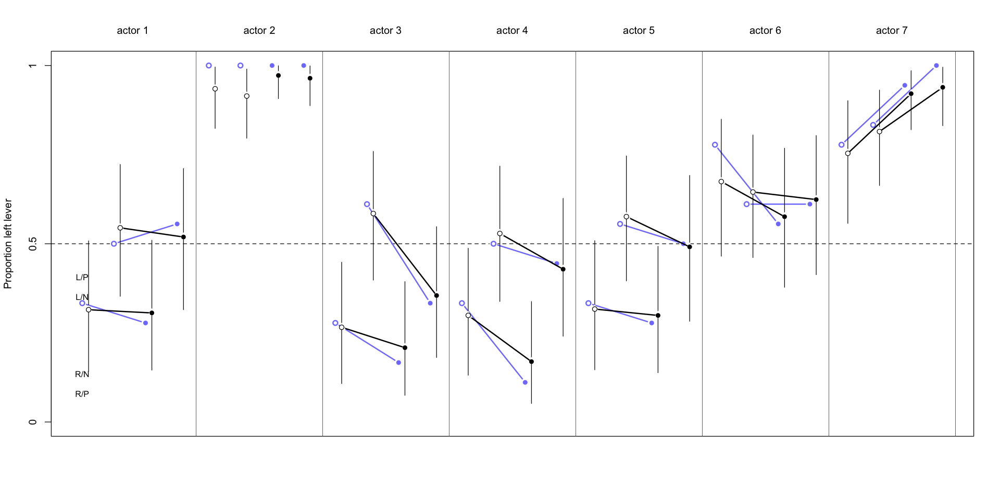

In [94]:
pl <- by(d$pulled_left, list(d$actor, d$treatment), mean)

# generate the posterior predictions using link
datp <- list(
    actor = rep(1:7, each = 4),
    tid = rep(1:4, times = 7),
    block_id = rep(5, times = 4 * 7)
)

p_post <- link(m14.3, data = datp)
p_mu <- apply(p_post, 2, mean)
p_ci <- apply(p_post, 2, PI)

# set up the plot
par(bg = 'white')
plot(NULL, xlim = c(1, 28), ylim = c(0, 1), xlab = "", ylab = "Proportion left lever", xaxt = "n", yaxt = "n")
axis(2, at = c(0, 0.5, 1), labels = c(0, 0.5, 1))
abline(h = 0.5, lty = 2)
for (j in 1:7) {
    abline(v = (j - 1) * 4 + 4.5, lwd = 0.5)
    text((j - 1) * 4 + 2.5, 1.1, concat("actor ", j), xpd = TRUE)
}
x0 <- 0.1 # offset distance

# raw
# the [-2] removes the index of 2 (so this is 1, 3, 4, 5, ...)
for (j in (1:7)[-2]) {
    lines((j - 1) * 4 + c(1, 3) - x0, pl[j, c(1, 3)], lwd = 2, col = rangi2)
    lines((j - 1) * 4 + c(2, 4) - x0, pl[j, c(2, 4)], lwd = 2, col = rangi2)
}
points(1:28 - x0, t(pl), pch = 16, col = 'white', cex = 1.7)
points(1:28 - x0, t(pl), pch = c(1, 1, 16, 16), col = rangi2, lwd = 2)

yoff <- 0.175
text(1 - x0, pl[1, 1] - yoff, "R/N", pos = 1, cex = 0.8)
text(1 - x0, pl[1, 2] - yoff, "L/N", pos = 3, cex = 0.8)
text(1 - x0, pl[1, 3] - yoff, "R/P", pos = 1, cex = 0.8)
text(1 - x0, pl[1, 4] - yoff, "L/P", pos = 3, cex = 0.8)

# posterior predictions
for (j in (1:7)[-2]) {
    lines( (j - 1) * 4 + c(1, 3) + x0, p_mu[(j - 1) * 4 + c(1, 3)], lwd = 2)
    lines( (j - 1) * 4 + c(2, 4) + x0, p_mu[(j - 1) * 4 + c(2, 4)], lwd = 2)
}

for (i in 1:28) {
    lines(c(i, i) + x0, p_ci[, i], lwd = 1)
}

points(1:28 + x0, p_mu, pch = 17, col = 'white', cex = 1.3)
points(1:28 + x0, p_mu, pch = c(1, 1, 16, 16))

Open circles are those without a partner and filled ones have a partner. The most obvious change from earlier iterations is that there is a lot more variation - allowing each actor to have their own parameter gives us a lot more variation. Notice also that there is some shrinkage here - espcially for actor 2 (the one that always pulled left). It's also interesting that some treatments, like 1 and 2, shrink more than the others - that's because there was less variation among the actors.

Our interpretation didn't change - the chimpanzees didn't act in a way that indicated prosociality. This model does have some advantages over the earlier one. Since it allows for some individuals to differ in how they respond to treatment, it could reveal a situation in which the treatment has no effect *on average*, but some individuals respond strongly. That wasn't the case here. But sometimes we are interested more in the distribution of cases than in the average response.

---

**Overthinkin: Non-centred parameterization of the multilevel model**

If the chains are inefficient, sometimes we can just run it for way longer to get a better sample size. However, this is inefficient and unreliable. Usually it is better to reparameterize the model for better sampling. So how can we do this with a correlation matrix?

Model `m14.3` uses something called [[Cholesky Decomposition]] to smuggle the covariance matrix out of the prior. The top part of the model is the same as the centred version, `m14.2`. The changes are the extra lines that construct the adaptive priors.

```
# adaptive priors - non-centred
transpars> matrix[actor, 4]:alpha <- compose_noncentered(sigma_actor, L_Rho_actor, z_actor),
transpars> matrix[block_id,4]:beta <- compose_noncentered(sigma_block, L_Rho_block, z_block),
matrix[4,actor]:z_actor ~ normal(0, 1),
matrix[4,block_id]:z_block ~ normal(0, 1),
```

The two lines that start with `transpars>` define the matrices of carying effects, $\alpha$ and $\beta$. Each one of these has a row for each actor / block and a column for each effect.

For convenience, `compose_noncentered` mixes the vector of standard deviations, the correlation matrix, and the `z`-scores together to make a pmatrix of parameters on the correct scale for the linear model. This allows us to to have the matrix of $z$ scores to just be `normal(0, 1)`. The other change that allows this to be non-centred is that we replace the correlation matrices with [[Cholesky Factor]]s using `cholesky_factor_corr`.

What is `compose_noncentered` doing? And what are [[Cholesky Factor]]s? A [[Cholesky Decomposition]] $\textbf{L}$ is a way to represent a square, symmetric matrix (like a correlation matrix) $\textbf{R}$ such that $\textbf{R} = \textbf{L}\textbf{L}^T$. It is kind of wild that you can then multiply $\textbf{L}$ by a matrix of uncorrelated samples (the $z$ scores) and get out the other end a correlated matrix of samples - the varying effects!

We sample that matrix of uncorrelated $z$ scores and multiply them by the [[Cholesky Factor]]s and the standard deviations to get the varying effects with the correct scale and correlation.

Let's look at the raw [[Stan]] code. The `transpars>` flag indicates that the quantity is to be put in the `transformed parameters` portion of the [[Stan]] model - [[Stan]] will include them in the posterior even though they're just a function of the existing parameters.

```stan
transformed parameters{
     matrix[7,4] alpha;
     matrix[6,4] beta;
    beta = (diag_pre_multiply(sigma_block, L_Rho_block) * z_block)';
    alpha = (diag_pre_multiply(sigma_actor, L_Rho_actor) * z_actor)';
}
```

These calculations merge in the vectors of standard deviations, `sigma_actor` and `sigma_block`, with the Cholesky correlation factors `L_Rho_actor` and `L_Rho_block`. The function `diag_pre_multiply` makes a diagonal matrix from the vector of standard deviations and multiplies it, producing a Cholesky factor for the right covariance matrix. Finally, we multiply that by the $z$ score. For convenience, we also take the transpose (that's what the ` at the end of each line is) so that we can access it by [actor, effect] instead of [effect, actor].

Once we've done that work `alpha` and `beta` are available in the model block.

```stan
model{
     vector[504] p;
    L_Rho_block ~ lkj_corr_cholesky( 2 );
    sigma_block ~ exponential( 1 );
    L_Rho_actor ~ lkj_corr_cholesky( 2 );
    sigma_actor ~ exponential( 1 );
    g ~ normal( 0 , 1 );
    to_vector( z_block ) ~ normal( 0 , 1 );
    to_vector( z_actor ) ~ normal( 0 , 1 );
    for ( i in 1:504 ) {
        p[i] = g[tid[i]] + alpha[actor[i], tid[i]] + beta[block_id[i], tid[i]];
        p[i] = inv_logit(p[i]);
    }
    L ~ binomial( 1 , p );
}
```

We declare a vector `p` to hold the linear model calculations for each case, then the priors are defined in terms of Cholesky correlation factors and vectors of standard deviations. The `z` score matrices are assigned their priors using `to_vector`, because `normal(0, 1)` applies to vectors, not matrices. The `z` score is still stored in matrix format - we just use `to_vector` to give each cell in the matrix the same prior. Finally, in the for loop we compute the values for `p`.

The last bit is the generated quantities, where we can calculate values which are functions of the posterior. We use it to transform the [[Cholesky Factor]]s into normal correlation matrices, as well as computing the log likelihood.

```stan
generated quantities{
    vector[504] log_lik;
    vector[504] p;
    matrix[4,4] Rho_actor;
    matrix[4,4] Rho_block;
    Rho_block = multiply_lower_tri_self_transpose(L_Rho_block);
    Rho_actor = multiply_lower_tri_self_transpose(L_Rho_actor);
    for ( i in 1:504 ) {
        p[i] = g[tid[i]] + alpha[actor[i], tid[i]] + beta[block_id[i], tid[i]];
        p[i] = inv_logit(p[i]);
    }
    for ( i in 1:504 ) log_lik[i] = binomial_lpmf( L[i] | 1 , p[i] );
}
```

The function `multiply_lower_tri_self_transpose` is a convenient and efficient way to perform the matrix algebra to turn the [[Cholesky Factor]] $\textbf{L}$ into the corresponding matrix: $\textbf{R} = \textbf{L} \textbf{L}^T$.

The obvious cost to this way of doing it is that it's confusing as all get out. This limits our ability to share code with others.

Also, this is not a silver buller - for some models, the centred version with the mean and standard deviation right in the prior will actually work better! So sometimes you just kind of need to try things out to see what works.

---

## Instruments and causal designs

Back in [[Chapter 6]], we learned about which variables to include in a model. The basic idea is that when we look at a [[DAG]], we want to leave open the causal paths but close the non-causal ones, while still not accidentally opening a path by including the wrong variable in the model.

Sometimes we can't close the non-causal paths. or rule our unobserved confounds. However, it turns out that we can sometimes do things to help! If we're lucky, there are ways to exploit a combination of natural experiments and clever modelling that allow causal inference even when non-causal paths can't be closed.

We'll start with the most famous, and possibly least intuitive, example, and then move on to describe some other approaches.

## Instrumental variables

What is the impace of education $E$ on wages $W$? Does more school improve future wages? If we regress wages on education we expect the inference to be biased by things that affect both, like maybe industrious people are more likely to get an education as well as to have higher wages. It's often difficult to measure (or even imagine) all of the possible confounds in a situation like this. We often end up with a [[DAG]] like this:

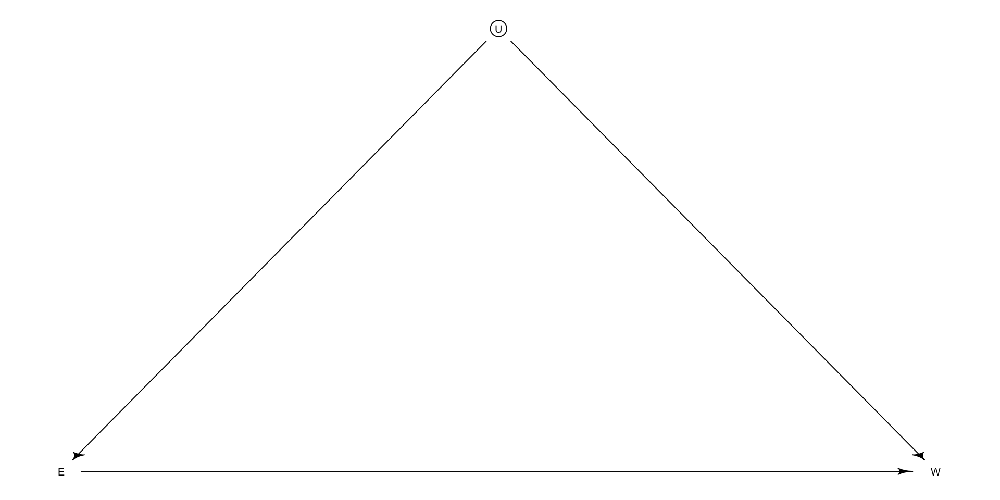

In [95]:
par(bg = 'white')
dag <- dagitty('dag {
U [unobserved, pos="0,-2"]
E[pos="-1,1"]
W[pos="1,1"]
E <- U -> W
E -> W
}')
drawdag(dag)

The backdoor path $E \leftarrow E \to W$ ruins our day!

We can't condition on $U$, since we haven't observed it. However, there might be something that we can do! If we can find a suitable [[Instrumental Variable]] $Q$, we might be able to find the effect of $E$ on $W$. An instrumental variable is one that acts like a natural experiment on $E$. There are three criteria:
1. Independent of $U$ ($Q \perp U$)
2. Not independent of $E$ ($Q \not\perp E$)
3. $Q$ cannot influence $W$ except through $E$

The last one is sometimes called the **Exclusion Restriction**. It can't strictly be tested, and is often implausble. Similarly, the first line can't strictly be tested. However, if you have a good understanding of the thing that you're studying, usually you can make a pretty good guess as to what would satisfy these criteria.

It's a bit easier to understand in a [[DAG]]:


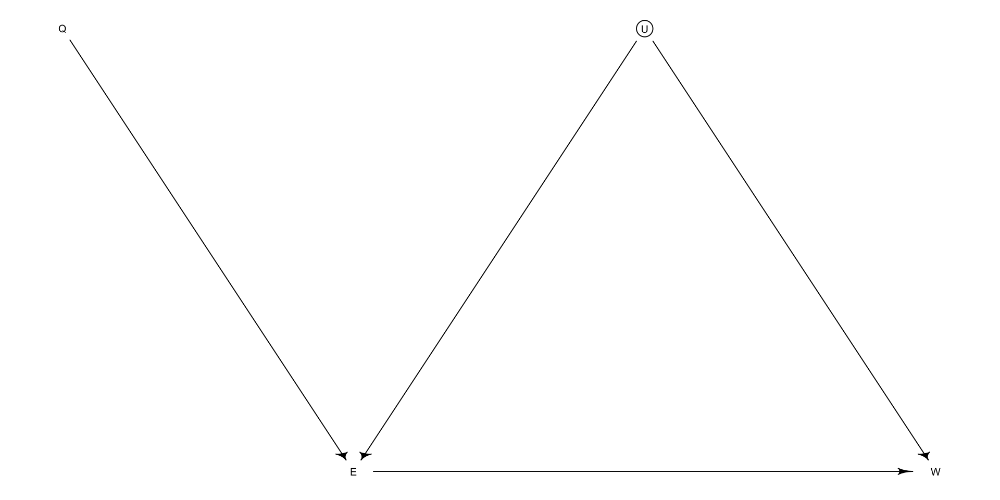

In [96]:
par(bg = 'white')
dag <- dagitty('dag {
U [unobserved, pos="0,-2"]
E[pos="-1,1"]
W[pos="1,1"]
Q[pos="-2,-2"]
E <- U -> W
E -> W
Q -> E
}')
drawdag(dag)

The instrument here is $Q$. If this [[DAG]] is correct, then $Q$ satisfies all three criteria above. Of course, it could be embedded in a much more complex [[DAG]], so if you can condition on different variables in such a way that it looks like this graph, then you can also use it as an instrumental variable.

So how do we use $Q$? We can't just add it to the regression like a normal variable - there's a non-causal path $Q \to E \leftarrow U \to W$. It's non-causal because changing $Q$ doesn't result in any change in $W$ through this path. However, since we're conditioning on $E$ in the same model and $E$ is a collider of $Q$ and $U$, the non-causal path is open. This confounds the coefficient on $Q$. It won't be zero - it'll pick up the association between $U$ and $W$. Used this way, an instrument like $Q$ is sometimes called a **Bias Amplifier**.

Let's look at a concrete example. Say $Q$ is the quarter of the year you were born in (spring, summer, fall, winter). This might influence education because depending on when you're born, you might be comparatively old or young compared to your classmates, giving you an advantage or disadvantage compared to them. So, if $Q$ influences $W$ only though $E$, and $Q$ is also not influenced by the confounds $U$, then $Q$ is an instrument, and we can use it in a special way to make a valid causal inference about $E \to W$ without measuring $U$.

This is based on a real study, but we'll simulate the data to keep things clean.

In [97]:
set.seed(73)
N <- 500
U_sim <- rnorm(N)
Q_sim <- sample(1:4, size = N, replace = TRUE)
E_sim <- rnorm(N, U_sim + Q_sim)
W_sim <- rnorm(N, U_sim + 0 * E_sim)

dat_sim <- list(
    W = standardize(W_sim),
    E = standardize(E_sim),
    Q = standardize(Q_sim)
)

The instrument $Q$ varies from 1 - 4. Larger values are associated with more education, through the addition of `Q_sim` to the mean os `E_sim`. We've assumed that the true influence of education on wages is 0, just for the sake of this example. However, $Q$ does influence education, so we can use it to discover $E \to W$.

Let's consider three models. In the first, we simply regress wages on education. We'll be confident that education causes higher wages, even though it doesn't:

In [98]:
m14.4 <- ulam(
    alist(
        W ~ dnorm(mu, sigma),
        mu <- aW + bEW * E,
        aW ~ dnorm(0, 0.2),
        bEW ~ dnorm(0, 0.5),
        sigma ~ dexp(1)
    ),
    data = dat_sim,
    chains = 4,
    cores = 4
)
precis(m14.4)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 1 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 1 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e46145b6b.stan', line 19, column 4 to column 29)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 3 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 3 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 3 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 4 Iteration: 700 

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
aW,0.0001752378,0.04188482,-0.06851846,0.06841825,1.001203,2055.373
bEW,0.3988908520,0.04219630,0.33340506,0.46491469,1.002261,1879.965
sigma,0.9196990615,0.02932086,0.87399580,0.96856511,1.004141,1955.128


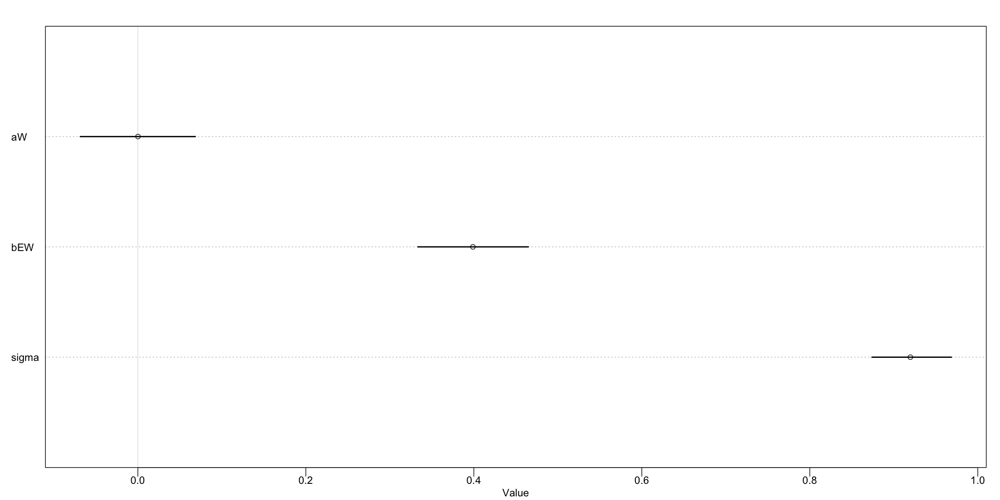

In [99]:
par(bg = 'white')
plot(precis(m14.4))

Our value of `bEW` is fairly firmly positive - we're convinced that education helps wages.

This is really not surprising - it's an ordinary confound where the unmeasured $U$ is messing up our measurement. Of course, if you have incentives to believe that education increases wages you might just report this finding and move on with your life.

Now let's add $Q$:

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 1 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 1 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e39eb802a.stan', line 21, column 4 to column 29)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 1 finished in 0.1 seconds.
Chain 2 finished in 0.1 seconds.
Chain 3 finished in 0.1 seconds.
Chain 4 finished in 0.1 seconds.

All 4 chains finished successfully.
Mean chain execution time: 0.1 seconds.
Total execution time: 0.2 seconds.



,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
aW,0.0003401712,0.03881971,-0.06247184,0.05980492,0.9994394,2287.380
bEW,0.6371251875,0.04685310,0.56202424,0.71213189,1.0006865,1392.984
bQW,-0.4072953935,0.04673787,-0.48594445,-0.33297087,1.0032293,1490.836
sigma,0.8582619625,0.02859026,0.81469174,0.90462382,1.0074893,1990.820


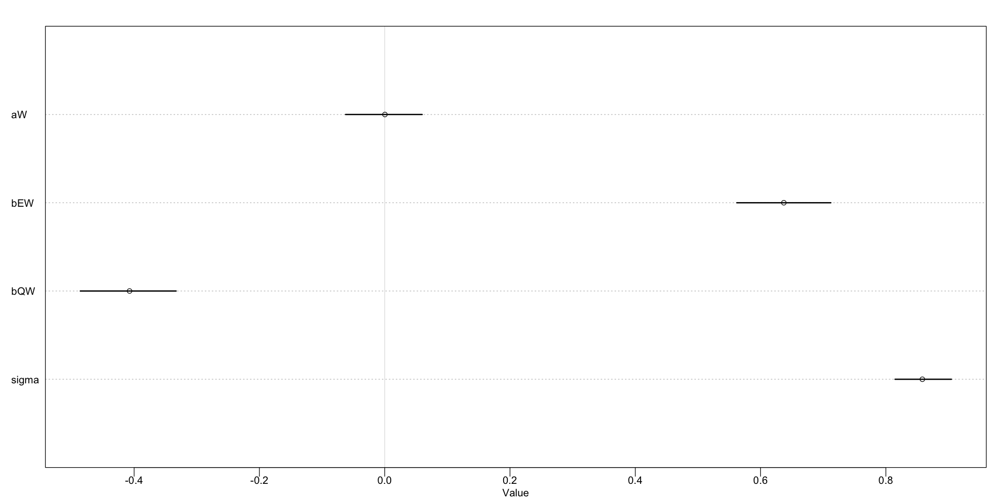

In [100]:
m14.5 <- ulam(
    alist(
        W ~ dnorm(mu, sigma),
        mu <- aW + bEW * E + bQW * Q,
        aW ~ dnorm(0, 0.2),
        bEW ~ dnorm(0, 0.5),
        bQW ~ dnorm(0, 0.5),
        sigma ~ dexp(1)
    ),
    data = dat_sim,
    chains = 4,
    cores = 4
)
precis(m14.5)
par(bg = 'white')
plot(precis(m14.5))

Whoa! So now we're even more convinced the education increases wages - bias amplification!

Now we're going to see how to correctly use $Q$. We'll use the generative model. Let's write a generative version of the [[DAG]]. There are 4 sub-models.

First, how wages are caused by education and the unobserved confound $U$.

$$
\begin{align*}
W_i &\sim \text{Normal}(\mu_{w,i} \sigma_w) \\
\mu_{w,i} &= \alpha_w + \beta_{EW}E_i + U_i
\end{align*}
$$

Next we have a model for how education levels are caused by the quarter of the birth, $Q$ (the instrumental variable) and the same unobserved confound $U$.

$$
\begin{align*}
E_i &\sim \text{Normal}(\mu_E, \sigma_E) \\
\mu_E &= \alpha_E + \beta_{QE} Q_i + U_i
\end{align*}
$$

The third model is for $Q$; that one just says that a quarter of all people are born in each quarter of the year.

$$
Q_i \sim \text{Categorical}([0.25, 0.25, 0.25, 0.25])
$$

And finally the fourth model says that the unobserved confound is normally distributed with mean 0 and sd 1

$$
U_i \sim \text{Normal}(0, 1)
$$

In principle $U$ could have some other distribution, but this is what we're modelling for now.

Now we have to translate this into a statistical model. One option would be to use brute force - treating the $U$ values as missing data and imputing them. That's a task for the next chapter [[Chapter 15]]. For now, we'll average over them and estimate a covariance between $W$ and $E$; that is, we'll say that $E$ and $W$ come from a common multivariate normal distribution.

$$
\begin{align*}
\begin{pmatrix} W_i \\ E_i \end{pmatrix} &\sim \text{MVNormal}\left( \begin{pmatrix}\mu_{w,i} \\ \mu_{E,i} \end{pmatrix}, \textbf{S} \right) & \text{[Joint wage and education model]}\\
\mu_{W,i} &= \alpha_W + \beta_{EW} E_i \\
\mu_{E,i} &= \alpha_E + \beta_{QE} Q_i
\end{align*}
$$

The matrix $\textbf{S}$ is the error covariance between wages and education. It's not the descriptive covariance but instead the equivalent of the usual $\sigma$ that we use in a normal distribution, just in matrix form. The model above is a [[Multivariate Linear Model]], a regression with multiple outcomes all modelled with a joint error structure.

Each variable gets its own linear model, yielding the two $\mu$ definitions.

It's a bit weird that $E$ is both a predictor and outcome of wages, but that's what the [[DAG]] is telling us. There's nothing mathematically incorrect about it. Basically, it's the mathematical formulation of the fact that $E$ might influence $W$ and also at the same time that pairs of $E, W$ might have some residual correlation. That correlation arises through the influence of $U$.

Of course, the full model needs priors.

In [101]:
m14.6 <- ulam(
    alist(
        c(W, E) ~ multi_normal(c(muW, muE), Rho, Sigma),
        muW <- aW + bEW * E,
        muE <- aE + bQE * Q,
        c(aW, aE) ~ normal(0, 0.2),
        c(bEW, bQE) ~ normal(0, 0.5),
        Rho ~ lkj_corr(2),
        Sigma ~ exponential(1)
    ),
    data = dat_sim,
    chains = 4,
    cores = 4
)
precis(m14.6, depth = 3)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450ec6a4141.stan', line 18, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450ec6a4141.stan', line 18, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450ec6a4141.stan', line 18, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450ec6a4141.stan', line 18, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450ec6a4141.stan', line 18, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450ec6a4141.stan', line 18, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450ec6a4141.stan', line 18, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450ec6a4141.stan', line 18, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 500 / 1000 [ 50%]

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
aE,-0.001402817,0.03486172,-0.05540136,0.05552245,1.0011172,1194.9639
aW,-0.002216349,0.04368891,-0.06985150,0.06814822,1.0004388,1317.8924
bQE,0.590909858,0.03501421,0.53566063,0.64652179,0.9998191,1413.6120
bEW,-0.044459630,0.07791536,-0.16894350,0.07642510,1.0028805,886.6020
"Rho[1,1]",1.000000000,0.00000000,1.00000000,1.00000000,NA,NA
"Rho[2,1]",0.538272687,0.05380655,0.45139746,0.62321142,1.0025543,920.7540
"Rho[1,2]",0.538272687,0.05380655,0.45139746,0.62321142,1.0025543,920.7540
"Rho[2,2]",1.000000000,0.00000000,1.00000000,1.00000000,NA,NA
Sigma[1],1.021505480,0.04769767,0.95032186,1.10118000,1.0010653,947.5917


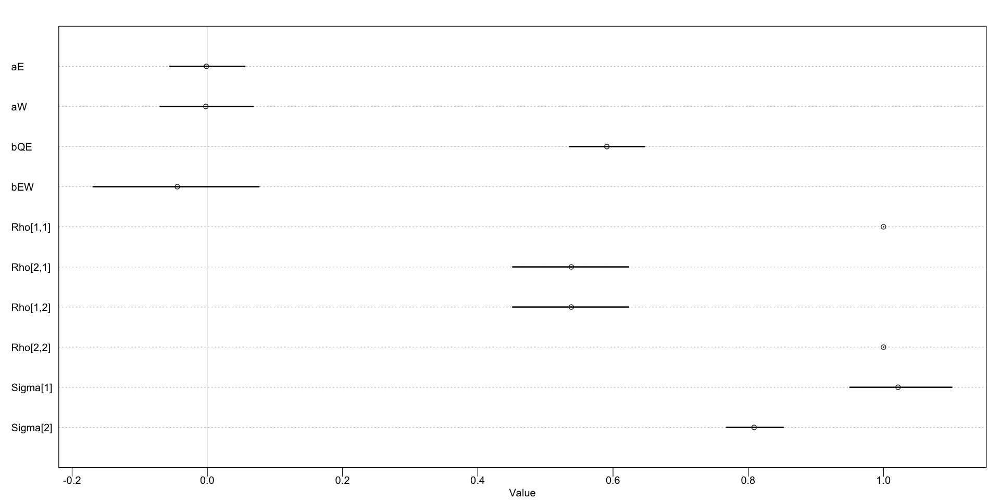

In [102]:
par(bg = 'white')
plot(precis(m14.6, depth = 3))

Let's take this a piece at a time:
1. `bEW`, the effect of education on wages: this is small and straddles 0, which we know is the correct causal inference.
2. The correlation `Rho[1, 2]` between education and wages is reliably positive - that reflects the influence of the confound $U$. Remember that this is **not** the raw empirical correlation; it's conditional on $E$ (for $W$) and on $Q$ (for $E$).

It's a good idea to adjust the simulation and try other scenarios.

For instance, maybe the education has a postitive influence but the confound hides it:

In [103]:
U_sim <- rnorm(N)
Q_sim <- sample(1:4, size = N, replace = TRUE)
E_sim <- rnorm(N, U_sim + Q_sim)
W_sim <- rnorm(N, -U_sim + 0.2 * E_sim)
dat_sim <- list(
    W = standardize(W_sim),
    E = standardize(E_sim),
    Q = standardize(Q_sim)
)
# this re-uses the model from m14.6 but with different data, meaning we don't need to recompile
m14.6.1 <- ulam(m14.6, data = dat_sim, chains = 4, cores = 4)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e29300dc.stan', line 18, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e29300dc.stan', line 18, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e29300dc.stan', line 18, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e29300dc.stan', line 18, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e29300dc.stan', line 18, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e29300dc.stan', line 18, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e29300dc.stan', line 18, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e29300dc.stan', line 18, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 500 / 1000 [ 50%]

                  mean         sd        5.5%       94.5%     rhat ess_bulk
aE       -0.0001025765 0.03396885 -0.05481493  0.05475730 1.000270 1662.464
aW        0.0004242763 0.04516014 -0.07201214  0.06967385 1.001896 1568.525
bQE       0.5970477645 0.03528767  0.54050989  0.65142502 1.000670 1699.056
bEW       0.3104397582 0.07832538  0.18633343  0.44007371 1.000209 1382.574
Rho[1,1]  1.0000000000 0.00000000  1.00000000  1.00000000       NA       NA
Rho[2,1] -0.4669376570 0.05595136 -0.55555355 -0.37441811 1.001095 1317.607
Rho[1,2] -0.4669376570 0.05595136 -0.55555355 -0.37441811 1.001095 1317.607
Rho[2,2]  1.0000000000 0.00000000  1.00000000  1.00000000       NA       NA
Sigma[1]  1.0780222815 0.04516947  1.01023340  1.15643495 1.000912 1475.101
Sigma[2]  0.8033062655 0.02571546  0.76349375  0.84505226 1.004044 1889.278


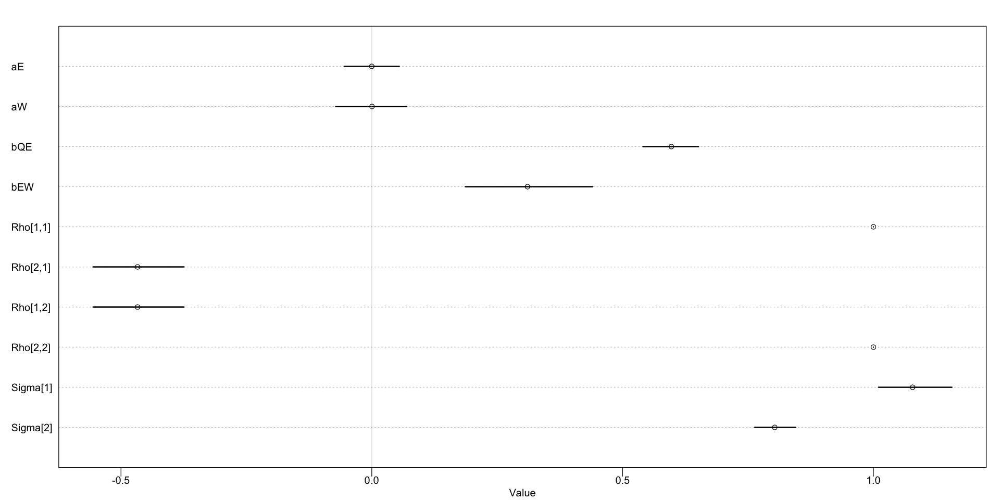

In [104]:
par(bg = 'white')
prec <- precis(m14.6.1, depth = 3)
print(prec)
plot(prec)

Instrumental variables are hard to understand. Luckily, there are tools to help! For instance, `dagitty` has a function `instrumentalVariables` that will find variables for you, if they're present. For instance, we could define the [[DAG]] and look for the instrumental variable this way:

In [105]:
dagIV <- dagitty("dag {Q -> E <- U -> W <- E}")
instrumentalVariables(dagIV, exposure = "E", outcome = "W")

 Q

That hardest part about instrumental variables is believing that they are instrumental variables. If you completely believe your [[DAG]] then you can find them, but often there's some doubt as to whether the [[DAG]] is correct.

As an example, a study of islands employed wind direction as an instrument for inferring the impact of colonialism on economic development. Colonial history and economic performance are confounded by many things, like the natural resources of an island. If wind direction influences colonization (because sailing ships depend so heavily on the wind direction) but not economic performance directly, then it should serve as an instrument. It's a clever idea, but it's also easy to imagine that the wind direction could influence other things about the island, like the pre-colonial history of contact and the ecology, and those variables cound influence the current economy.

A more common kind of instrument is distance to some service. Say we want to estimate the effect of health care on mothers. It's not easy (or ethical) to randomize healthcare among mothers. But **if** mothers naturally vary in their distance to health care, and **if** these distances are random with respect to pre-existing health conditions, then distance might be an instrument that influences use of health care but does not influence health directly. However, it's also easy to think of ways that distance from a hospital could be associated with factors influencing health, which would violate the exclusion restriction.

In general, it's not possible to statistically prove that a variable is a good instrument. We need scientific knowledge (outside of the data) to make that determination.

### Other Designs

Instrumental variables are natural experiments that impersonate randomized experiments. In the previous example, the quarter of the birth is like a natural manipulation of education $E$, which allows us to estimate the impact of the external shock and thus derive a causal estimate.

Instrumental variables are not the only ways to find natural experiments.

In addition to the backdoor criterion from [[Chapter 6]], there's also a [[Frontdoor Criterion]] that is relevant to a [[DAG]] that looks like this:

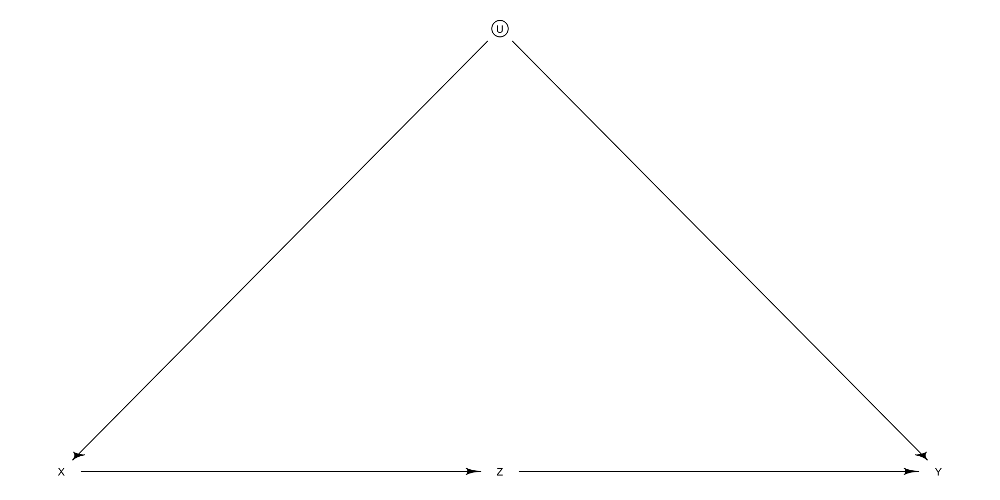

In [106]:
dag <- dagitty('dag {
U[unobserved, pos="0, -2"]
X[pos="-1, 0"]
Y[pos="1, 0"]
Z[pos="0, 0"]
Y <- U -> X -> Z -> Y
}')
par(bg = 'white')
drawdag(dag)

We want to know the causal effect of $X$ on $Y$. As usual, there is an annoying unobserved variable $U$. If we can't find a perfect mediator $Z$, then we can possibly estimate the causal effect of $X$ on $Y$. If you have a believable $Z$ variable, then the causal effect of $X$ on $Y$ is estimated by expressing the generative model as a statistical model, much as we did with the instrumental variable earlier.

The front-door criterion is not used much. This could be because it is relatively new or because believable $Z$ variables are rare. One possible example is the influence of social ties formed in college on voting behaviour in the US senate. The question is whether senators who went to the same college vote more similarly, because their social ties produce coordinated votes. 

The pure association between attending the same college and voting the same way is obviously confounded by a lot of things; the trick to is find some mechanism through which the social ties must act. In the case of the senate, it could be who sits next to whom. Luckily, junior senate members are assigned seats basically at random, which produces a nice natural experiment; sometimes people who went to the same college will be close to each other and some will be far away.

A more common design is [[Regression Discontinuity]] (or RDD). Suppose that we want to estimate the effect of winning the academy award on future success. This is confounded by things like ability. So instead, we look at individuals that were *just above* and *just below* the award cutoff. For people very close to the cutoff, it's like the award was awarded at random, which produces a great natural experiment. In practice, you fit one trend for people just above and other for those just below, and then the estimate of the effect is the difference in the two observed trends.

## Social relations as correlated varying effects

Once you graps the basic strategy of using covariance matrices to represent populations of correlated effects, you can accomplish a lot of different and scientifically relevant modelling goals. The following is an example that constructs a custom covariance matrix with special scientific meaning.

In [107]:
data(KosterLeckie)
head(kl_dyads)
head(kl_households)

,hidA,hidB,did,giftsAB,giftsBA,offset,drel1,drel2,drel3,drel4,dlndist,dass,d0125
,<int>,<int>,<int>,<int>,<int>,<dbl>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<int>
1,1,2,1,0,4,0.000,0,0,1,0,-2.790,0.000,0
2,1,3,2,6,31,-0.003,0,1,0,0,-2.817,0.044,0
3,1,4,3,2,5,-0.019,0,1,0,0,-1.886,0.025,0
4,1,5,4,4,2,0.000,0,1,0,0,-1.892,0.011,0
5,1,6,5,8,2,-0.003,1,0,0,0,-3.499,0.022,0
6,1,7,6,2,1,0.000,0,0,0,0,-1.853,0.071,0


,hid,hgame,hfish,hpigs,hwealth,hpastor
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,1,0.05,0.06,0.00,14.162,0
2,2,0.25,0.17,1.75,27.405,0
3,3,2.29,0.66,5.75,9.900,0
4,4,0.04,0.43,1.50,7.267,0
5,5,0.07,0.12,1.25,9.982,0
6,6,0.03,0.20,2.50,16.186,0


Right now we're interested in `kl_dyads`. Each row is a dyad of households from a community in Nicaragua. We want to model gift exchanges among these households. The outcome variables `giftsAB` and `giftsBA` in each row are the count of gifts in each direction within each dyad. The variables `hidA` and `hidB` tells us the dyad ids.

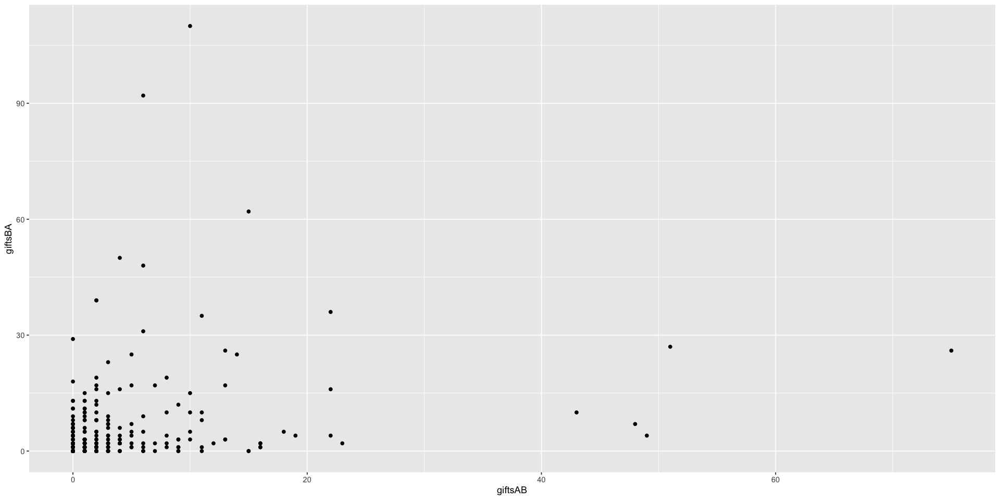

In [108]:
ggplot(kl_dyads, aes(giftsAB, giftsBA)) +
    geom_point()

In [109]:
cor.test(kl_dyads$giftsAB, kl_dyads$giftsBA)


	Pearson's product-moment correlation

data:  kl_dyads$giftsAB and kl_dyads$giftsBA
t = 4.2518, df = 298, p-value = 2.84e-05
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.1294190 0.3431037
sample estimates:
      cor 
0.2391549 


So looking at the raw data, it's a bit of a mess. We have a correlation of about 0.24 between gifts given and received. However, that doesn't really mean anything. The labels are arbitrary, so if we shuffle the data we'll get a different number here without changing anything fundamental about the data.

The generative model we want to use in the background is that the gifts can be explained both by the special relationship between dyads (some households exchange gifts with each other frequently) and by the fact the some households give or receive gifts at a high rate irrespective of relationship. For instance, a poorer household might receive a lot of gifts irrespective of the relationship with other households.

We need a model that accounts for both of these. We'll use a **Social Relations Model**, or **SRM**.

Specifically, we'll model gifts from household A to household B as a combination of varying effects specific to the household as well to the dyad. The number of gifts is a [[Poisson]] variable - there's no clear upper bound. We'll use a log link, just like in previous chapters.

$$
\begin{align*}
y_{A \to B} &\sim \text{Poisson}(\lambda_{AB}) \\
\log \lambda_{AB} &= \alpha + g_A + r_B + d_{AB}
\end{align*}
$$

- $\alpha$ is the average gift-giving rate (on a log scale) across all dyads
- $g_A$ is the generalized gift-giving tendency of household $A$, regardless of dyad
- $r_B$ is the generalized gift-receiving tendency of household $B$, regardless of dyad
- $d_{AB}$ is the dyad-specific rate that $A$ gives to $B$.

There's a corresponding model for the other interaction within the same dyad

$$
\begin{align*}
y_{B \to A} &\sim \text{Poisson}(\lambda_{BA}) \\
\log \lambda_{BA} &= \alpha + g_B + r_A + d_{BA}
\end{align*}
$$

So each household needs two varying effects $g_A$ and $r_A$. In addition, each dyad has two varying effects, $d_{AB}$ and $d_{BA}$. We want to allow $r$ and $g$ to be correlated - do people who give a lot also receive a lot? We also want to allow the $d$s to be correlated - is there balance in gift-giving within the dyad? We can do this with two different related multi_normal priors.

The first represent the population of household effects:

$$
\begin{pmatrix} g_i \\ r_i \end{pmatrix} \sim \text{MVNormal}\left(\begin{pmatrix} 0 \\ 0 \end{pmatrix}, \begin{pmatrix} \sigma_g^2 & \sigma_g \sigma_r \rho_{gr} \\ \sigma_g \sigma_r \rho_{gr} & \sigma_r^2 \end{pmatrix} \right)
$$

The second represents the population of dyad effects:

$$
\begin{pmatrix} d_{ij} \\ d_{ji} \end{pmatrix} \sim \text{MVNormal}\left(\begin{pmatrix} 0 \\ 0 \end{pmatrix}, \begin{pmatrix} \sigma_d^2 & \sigma_d^2 \rho_{d} \\ \sigma_d^2 \rho_{d} & \sigma_d^2 \end{pmatrix} \right)
$$

This last one is a bit weird - there's only the one parameter? Why? Basically, because the labels on the parameters are arbitrary. It doesn't mean anything which house comes first or second. Thus, both parameters must have the same variance. We do want to estimate their correlation, which is what $\rho_d$ does. If it is positive, then a house that gives a lot will also tend to receive a lot, and if it's negative then a house that gives a lot will tend to receive very little. If $\rho_d$ is close to zero, then we don't really see a relationship between those two.

We'll need to be very carfule when building the model to index everything correctly.

In [110]:
kl_data <- list(
    N = nrow(kl_dyads),
    N_households = max(kl_dyads$hidB),
    did = kl_dyads$did,
    hidA = kl_dyads$hidA,
    hidB = kl_dyads$hidB,
    giftsAB = kl_dyads$giftsAB,
    giftsBA = kl_dyads$giftsBA
)

m14.7 <- ulam(
    alist(
        giftsAB ~ poisson(lambdaAB),
        giftsBA ~ poisson(lambdaBA),
        log(lambdaAB) <- a + gr[hidA, 1] + gr[hidB, 2] + d[did, 1],
        log(lambdaBA) <- a + gr[hidB, 1] + gr[hidA, 2] + d[did, 2],
        a ~ normal(0, 1),

        # gr matrix of the varying effects
        vector[2]: gr[N_households] ~ multi_normal(0, Rho_gr, sigma_gr),
        Rho_gr ~ lkj_corr(4),
        sigma_gr ~ exponential(1),

        # dyad effects
        transpars> matrix[N,2]:d <- compose_noncentered(rep_vector(sigma_d, 2), L_Rho_d, z),
        matrix[2, N]:z ~ normal(0, 1),
        cholesky_factor_corr[2]: L_Rho_d ~ lkj_corr_cholesky(8),
        sigma_d ~ exponential(1),

        # compute the correlation matrix for the dyads
        gq> matrix[2, 2]: Rho_d <<- Chol_to_Corr(L_Rho_d)
    ),
    data = kl_data,
    chains = 4,
    cores = 4,
    iter = 4000
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:    1 / 4000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e9cd3e4d.stan', line 27, column 4 to column 37)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e9cd3e4d.stan', line 27, column 4 to column 37)

Chain 1 If this warning occurs sporadically, such as for highly co

Chain 2 Iteration:    1 / 4000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e9cd3e4d.stan', line 27, column 4 to column 37)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e9cd3e4d.stan', line 27, column 4 to column 37)

Chain 2 If this warning occurs sporadically, such as for highly co

Chain 3 Iteration:    1 / 4000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e9cd3e4d.stan', line 27, column 4 to column 37)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e9cd3e4d.stan', line 27, column 4 to column 37)

Chain 3 If this warning occurs sporadically, such as for highly co

Chain 4 Iteration:    1 / 4000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e9cd3e4d.stan', line 27, column 4 to column 37)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e9cd3e4d.stan', line 27, column 4 to column 37)

Chain 4 If this warning occurs sporadically, such as for highly co

Chain 2 Iteration:  100 / 4000 [  2%]  (Warmup) 
Chain 1 Iteration:  100 / 4000 [  2%]  (Warmup) 
Chain 3 Iteration:  100 / 4000 [  2%]  (Warmup) 
Chain 4 Iteration:  100 / 4000 [  2%]  (Warmup) 
Chain 2 Iteration:  200 / 4000 [  5%]  (Warmup) 
Chain 1 Iteration:  200 / 4000 [  5%]  (Warmup) 
Chain 4 Iteration:  200 / 4000 [  5%]  (Warmup) 
Chain 3 Iteration:  200 / 4000 [  5%]  (Warmup) 
Chain 4 Iteration:  300 / 4000 [  7%]  (Warmup) 
Chain 2 Iteration:  300 / 4000 [  7%]  (Warmup) 
Chain 1 Iteration:  300 / 4000 [  7%]  (Warmup) 
Chain 3 Iteration:  300 / 4000 [  7%]  (Warmup) 
Chain 4 Iteration:  400 / 4000 [ 10%]  (Warmup) 
Chain 2 Iteration:  400 / 4000 [ 10%]  (Warmup) 
Chain 1 Iteration:  400 / 4000 [ 10%]  (Warmup) 
Chain 3 Iteration:  400 / 4000 [ 10%]  (Warmup) 
Chain 2 Iteration:  500 / 4000 [ 12%]  (Warmup) 
Chain 4 Iteration:  500 / 4000 [ 12%]  (Warmup) 
Chain 1 Iteration:  500 / 4000 [ 12%]  (Warmup) 
Chain 3 Iteration:  500 / 4000 [ 12%]  (Warmup) 
Chain 2 Iteration:  

The top section is the two outcomes, the gift giving in each direction in the dyad. Then is the effect for the household, `gr[hidA, 1]`. The 1 is for the first column for the `gr` matrix. The next bit is the receiving effect, `gr[hidA, 2]`, where again the 2 is the for the second column of the matrix. The last term is the dyad effect, where we somewhat arbitrarily put household A in the first column and housegold B in the second.

The next bit defines the matrix of giving / receiving effects. The matrix `gr` will have a row for each household and two columns, the giving effect and the receiving effect.

The third chunk defines the matrix of dyad-specific effects. These are non-centred, for the sake of efficient mixing. The special piece is the `rep_vector(sigma_d, 2)`. This copies the standard diviation in a vector of length 2 and then composes the covariance matrix from there.

Finally, there's a line at the bottom that computes the covariance matrix for the dyads. This is necessary because the model is parameterized by using a [[Cholesky Factor]]. If we want to interpret the correlations among the effects, then this is a useful thing to do! The `gq>` at the start of the block tells [[Stan]] to put that in the generated quantities block, which is where we put quantities that are calculated after each transition; anything that we want to be calculated from each sample should be tagged this way. It will show up in the posterior.

This contains a lot of parameters! There are about 600 dyad parameters, for example.

In [111]:
stancode(m14.7)

data{
     int N_households;
     int N;
    array[300] int giftsAB;
    array[300] int giftsBA;
    array[300] int did;
    array[300] int hidA;
    array[300] int hidB;
}
parameters{
     real a;
    array[N_households] vector[2] gr;
     corr_matrix[2] Rho_gr;
     vector<lower=0>[2] sigma_gr;
     matrix[2,N] z;
     cholesky_factor_corr[2] L_Rho_d;
     real<lower=0> sigma_d;
}
transformed parameters{
     matrix[N,2] d;
    d = (diag_pre_multiply(rep_vector(sigma_d, 2), L_Rho_d) * z)';
}
model{
     vector[300] lambdaAB;
     vector[300] lambdaBA;
    sigma_d ~ exponential( 1 );
    L_Rho_d ~ lkj_corr_cholesky( 8 );
    to_vector( z ) ~ normal( 0 , 1 );
    sigma_gr ~ exponential( 1 );
    Rho_gr ~ lkj_corr( 4 );
    gr ~ multi_normal( rep_vector(0,2) , quad_form_diag(Rho_gr , sigma_gr) );
    a ~ normal( 0 , 1 );
    for ( i in 1:300 ) {
        lambdaBA[i] = a + gr[hidB[i], 1] + gr[hidA[i], 2] + d[did[i], 2];
        lambdaBA[i] = exp(lambdaBA[i]);
    }
    for ( i in 1:300 ) 

In [112]:
precis(m14.7, depth = 3, pars=c("Rho_gr", "sigma_gr"))

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
"Rho_gr[1,1]",1.0000000,0.00000000,1.0000000,1.00000000,NA,NA
"Rho_gr[2,1]",-0.4178579,0.19958873,-0.7143417,-0.08239627,1.000312,2966.470
"Rho_gr[1,2]",-0.4178579,0.19958873,-0.7143417,-0.08239627,1.000312,2966.470
"Rho_gr[2,2]",1.0000000,0.00000000,1.0000000,1.00000000,NA,NA
sigma_gr[1],0.8271179,0.13603871,0.6386920,1.06230110,1.000816,5195.544
sigma_gr[2],0.4225083,0.09194142,0.2884134,0.58076123,1.000213,2333.808


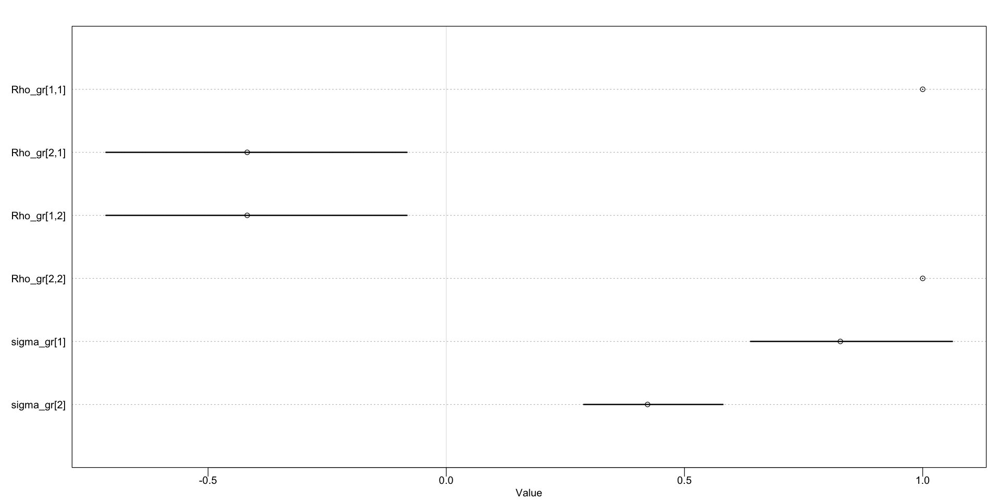

In [113]:
par(bg = 'white')
plot(precis(m14.7, depth = 3, pars = c("Rho_gr", "sigma_gr")))

We see that the correlation between giving and receiving, `Rho_gr[1, 2]` and `Rho_gr[2, 1]` (they are the same!) is about -0.7 to -0.1, which would indicate that those who give more tend to receive less. We also see that rates of giving (`sigma_gr[1]`) are more variable than rates of receiving (`sigma_gr[2]`).

Let's look at the giving and receiving effects. We're going to calculate the posterior predictive giving and receiving rates across all dayds.

In [114]:
post <- extract.samples(m14.7)
g <- sapply(1:25, function(i) post$a + post$gr[, i, 1])
r <- sapply(1:25, function(i) post$a + post$gr[, i, 2])
Eg_mu <- apply(exp(g), 2, mean)
Er_mu <- apply(exp(r), 2, mean)

The variable `g` is a matrix of 4000 rows (samples) and 25 columns (households). Then we just take the means of the samples across each household to get an overall giving rate, which of course has to be exponentiated.

First let's just plot these values to get a sense of what's going on here.

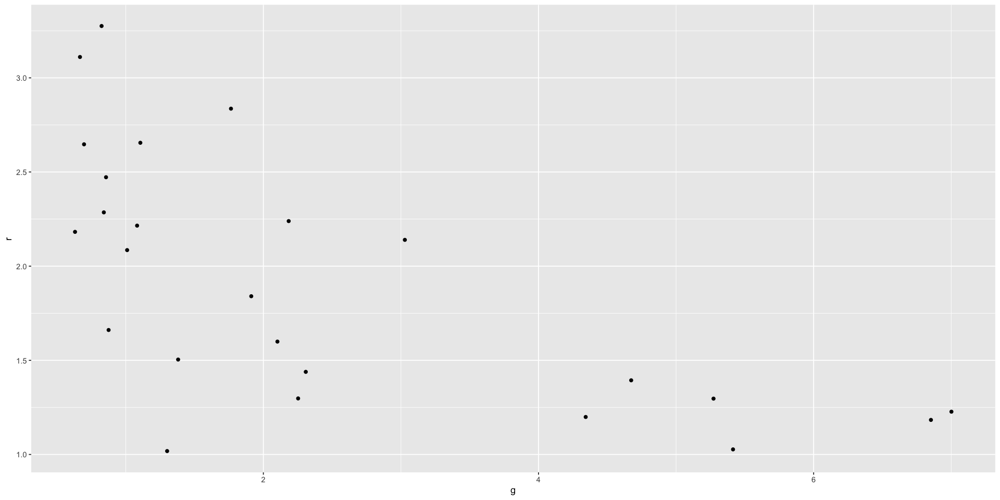

In [115]:
plot_df <- data.frame(g = Eg_mu, r = Er_mu)
p <- ggplot() +
    geom_point(data = plot_df, mapping = aes(g, r))
print(p)

This is interesting, but we'd also like an idea of the uncertainty around this. After all, each $g, r$ pair comes from a multivariate normal distribution; we should be able to plot at least some portion of that distribution around the point.

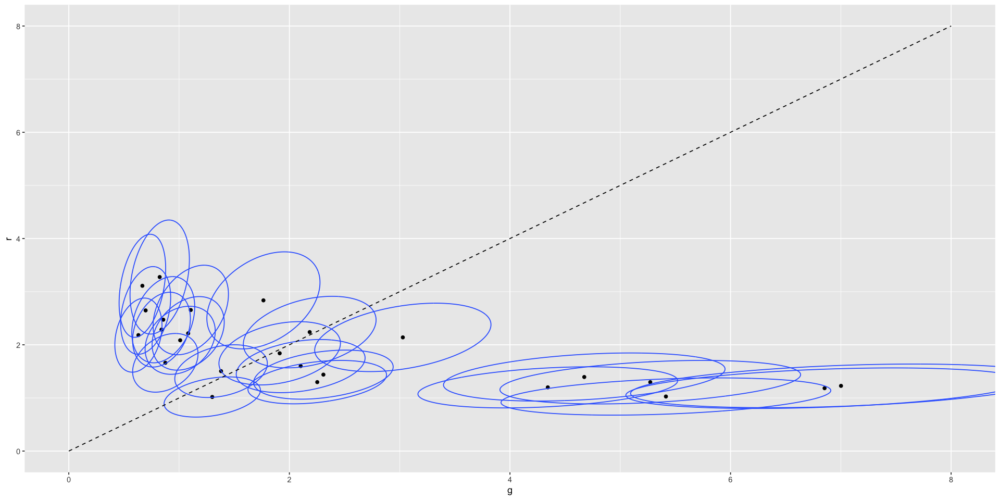

In [116]:
exp_g <- exp(g)
exp_r <- exp(r)
uncertainty_plot <- p
for (household in 1:25) {
    gs <- exp_g[, household]
    rs <- exp_r[, household]
    Mu <- c(mean(gs), mean(rs))
    Sigma <- cov(cbind(gs, rs))
    prob_grid <- expand.grid(g = seq(mean(gs) - 2, mean(gs) + 2, by = 0.01), r = seq(mean(rs) - 2, mean(rs) + 2, by = 0.01))
    probs <- dmvnorm(prob_grid, Mu, Sigma)
    probs <- unlist(probs)
    probs_data <- data.frame(g = prob_grid[, 1], r = prob_grid[, 2], prob = probs)
    uncertainty_plot <- uncertainty_plot + geom_contour(data = probs_data, mapping = aes(g, r, z = prob), bins = 2)
}
uncertainty_plot <- uncertainty_plot + 
    geom_segment(data = data.frame(x = 0, y = 0, xend = 8, yend = 8), mapping = aes(x = x, y = y, xend = xend, yend = yend), linetype = 'dashed') +
    coord_cartesian(xlim = c(0, 8), ylim = c(0, 8))
print(uncertainty_plot)

So we see that the households with the highest rates of receiving have the lowest rates of giving, probably reflecting needs-based gifts. On the other hand, the households with the largest rates of giving have low rates of receiving. This reflects what we saw in the precis.

What about the dyad effects? Let's look at the covariance matrix.

In [117]:
precis(m14.7, depth = 3, pars = c("Rho_d", "sigma_d"))

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
"Rho_d[1,1]",1.0000000,0.00000000,1.0000000,1.000000,NA,NA
"Rho_d[2,1]",0.8814973,0.03332732,0.8239282,0.929826,1.001445,2474.883
"Rho_d[1,2]",0.8814973,0.03332732,0.8239282,0.929826,1.001445,2474.883
"Rho_d[2,2]",1.0000000,0.00000000,1.0000000,1.000000,NA,NA
sigma_d,1.1018486,0.05729620,1.0141050,1.195189,1.000907,2162.071


From `Rho_d[1, 2]` we can see that the correlation between the rates of giving / receiving within dyads ($A \to B$ and $B \to A$) is positive and strong.

There is also more variation among *dyads* than there is among *households*. This implies that levels of giving within a dyad are balanced - if one household gives a lot of gifts, then the other probably will as well.

Let's plot the raw dyad values to see how strong the pattern is.

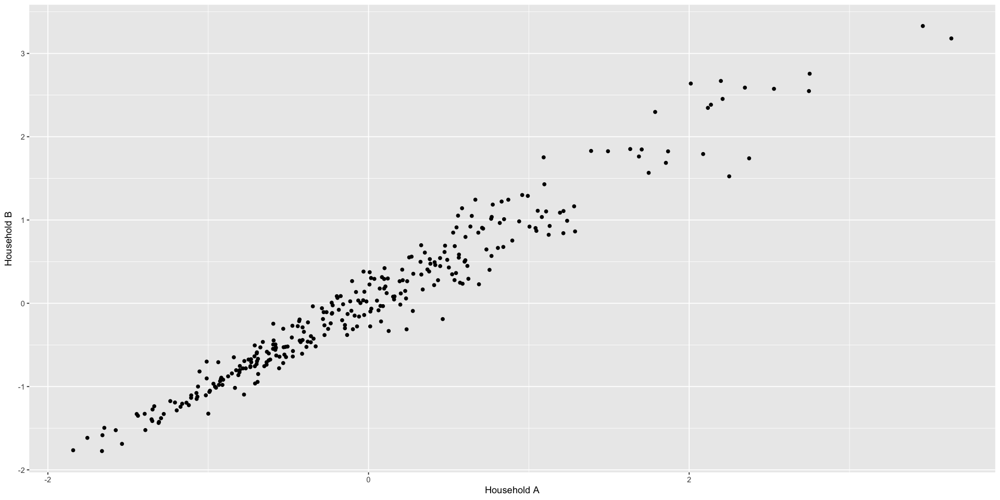

In [118]:
dy_1 <- apply(post$d[,,1 ], 2, mean)
dy_2 <- apply(post$d[,,2 ], 2, mean)

plot_df <- data.frame(dy_1 = dy_1, dy_2 = dy_2)
ggplot(plot_df, aes(dy_1, dy_2)) +
    geom_point() +
    labs(x = "Household A", y = "Household B")

This looks like a pretty strong relationship! This could reflect reciprocity, some other relationship (like family groups), or something else.

The full dataset includes lots of other covariates that we could use to explain the effects, like economic activities, relationships, distances between households, &c. We woul really like to add some of this information to a causal model to understand what's going on.

One important thing that's missing in this model is the idea of transitivity. That is, if household $A$ is friends with $B$, and $B$ is friends with $C$, then that makes it more likely that $A$ is also friends with $C$. We could fit this using something called a [[Stochastic Block Model]], but we need some techniques from [[Chapter 15]] to do this properly.

## Continuous Categories and the Gaussian Process

All of the varying effects so far have been defined over discrete, unordered categories: cafe 1 vs. 2, households $A$ and $B$, tadpole ponds, &c. Pooling across clusters gives us a bunch of advantages, as we've seen. but what about continuous categories? Something like age, income, or stature? We expect people of similar, e.g., ages to behave relatively similarly to people who are close in age. We expect the covariation to fall off as the ages get more and more different.

Luckily, there is a way to apply the same kind of varying effects approach to continuous categories which will allow us to estimate a unique intercept for each age while still allowing for information sharing between ages. The approach is known as [[Gaussian Process Regression]].

The basic idea is to define some dimension (say, age) along which people differ. We then measure the distance between each pair of ages. The model then estimates a function for the covariance between pairs of cases at different distances. This covariance function provides on continuous category generalization of the varying effects approach.

### Example: Spatial autocorrelation in Oceanic tools

Looking at the complexity of tools in Oceanic societies ([[Chapter 11]]), we used a crude binary contact predictor as a proxy for exchange between societies. However, that's pretty unsatisfying. First, it doesn't account for *which* societies you had contact with; if you're a small island with contact only with other small islands, that's very different than if you had contact with a large island. Secondly, islands close to one another may have similarities in natural resources (stone types, shells, &c.) which would naturally lead to similar tools. If islands are close then they probably exchanged tools among themselves.

So, we have a continuously varying covariate (distance between societies) which has some influence on the outcome we're looking at - a classic [[Gaussian Process Regression]] problem! We'll define a distance matrix between societies and use that to help predict tool use, incorporating both ordinary effects and varying effects.

In [119]:
data(islandsDistMatrix)

# distances, measured in thousands of kilometres
Dmat <- islandsDistMatrix
# since this is a symmetrical matrix, we are just setting the column names to the short form of the island names...
colnames(Dmat) <- c("Ml", "Ti", "SC", "Ya", "Fi", "Tr", "Ch", "Mn", "To", "Ha")
round(Dmat, 1)

,Ml,Ti,SC,Ya,Fi,Tr,Ch,Mn,To,Ha
Malekula,0.0,0.5,0.6,4.4,1.2,2.0,3.2,2.8,1.9,5.7
Tikopia,0.5,0.0,0.3,4.2,1.2,2.0,2.9,2.7,2.0,5.3
Santa Cruz,0.6,0.3,0.0,3.9,1.6,1.7,2.6,2.4,2.3,5.4
Yap,4.4,4.2,3.9,0.0,5.4,2.5,1.6,1.6,6.1,7.2
Lau Fiji,1.2,1.2,1.6,5.4,0.0,3.2,4.0,3.9,0.8,4.9
Trobriand,2.0,2.0,1.7,2.5,3.2,0.0,1.8,0.8,3.9,6.7
Chuuk,3.2,2.9,2.6,1.6,4.0,1.8,0.0,1.2,4.8,5.8
Manus,2.8,2.7,2.4,1.6,3.9,0.8,1.2,0.0,4.6,6.7
Tonga,1.9,2.0,2.3,6.1,0.8,3.9,4.8,4.6,0.0,5.0
Hawaii,5.7,5.3,5.4,7.2,4.9,6.7,5.8,6.7,5.0,0.0


We'll use the distances distances as a measure of similarity of technological exposure, allowing us to estimate a carying effect for each society that accounts for non-independence as a function of their geographic similarity.

We'll use the scientific tool model from [[Chapter 11]]. The first part is

$$
\begin{align*}
T_i &\sim \text{Poisson}(\lambda_i) \\
\lambda_i &= \alpha P^{\beta}_{i} / \gamma
\end{align*}
$$

We'd like to have $\lambda$ adjusted by a varying intercept parameter. We could create an additive term, but then it might be positive. We'll multiply it in instead.

$$
\begin{align*}
T_i &\sim \text{Poisson}(\lambda_i) \\
\lambda_i &= \text{exp}(k_{\text{society}[i]}) \alpha P^{\beta}_{i} / \gamma
\end{align*}
$$

Where $k_{\text{society}[i]}$ is the varying parameter. Unlike previous varying intercepts, we'll estimate it based off of the continuously varying distance rather than a discrete category.

The heart of the Gaussian process is the multivariate prior for the intercepts:

$$
\begin{align*}
    \begin{pmatrix} k_1 \\ k_2 \\ k_3 \\ \vdots \\ k_{10} \end{pmatrix} &\sim \text{MVNormal} \left( \begin{pmatrix} 0 \\ 0 \\ 0 \\ \vdots \\ 0 \end{pmatrix}, \textbf{K} \right) & [\text{prior for intercepts}] \\
    \textbf{K}_{ij} &= \eta^2 \text{exp}(-\rho^2 D_{ij}^2) + \delta_{ij} \sigma^2 & [\text{define the covariance matrix}] \\
\end{align*}
$$

The first line is the 10-dimensional Gaussian prior for the intercepts (one dimension for each society in the distance matrix). The mean is 0 so that each society will on average multiply the intercept by $e^0 = 1$. Negative $k$ values will decrease $\lambda$ and positive ones will increase it.

The covariance matrix $\textbf{K}$ defines the covariance between islands $i$ and $j$ as $\textbf{K}_{ij}$. The individual covariance uses three parameters: $\eta$, $\rho$, and $\sigma$.

The shape of the covariance model is given by $\text{exp}(-\rho^2 D^2_{i,j})$. This says that the covariance between two societies declines exponentially with the square of the distance between them. The parameter $\rho$ controls how fast this is - large $\rho$ means that the decline is steep, while small $\rho$ means that it is comparatively small.

Why do we square the distance? It's a choice, for sure. However, it's common for a few reasons. It is easy to fit to the data and it's realistic to assume that things drop off very rapidly with distance. We can also just compare it to e.g. a linear alternative.

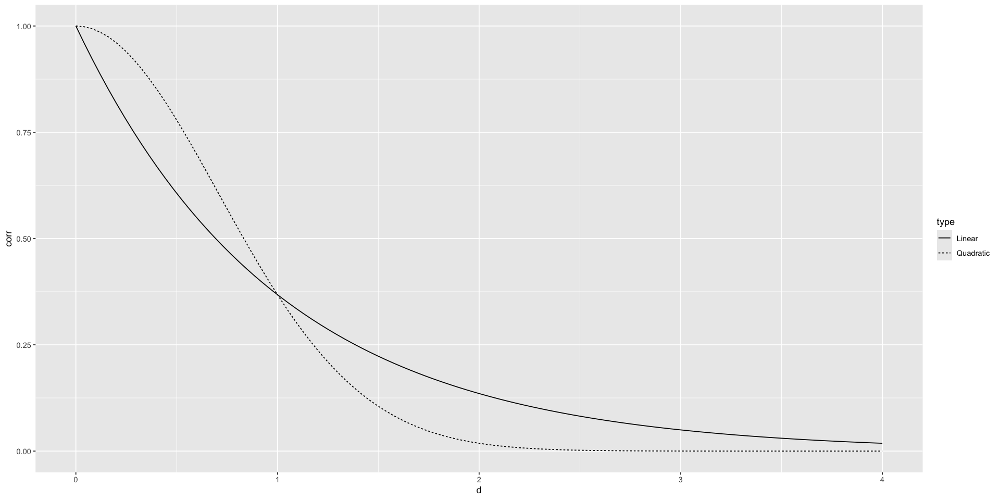

In [120]:
rho <- 1
linear_corr <- function(d) exp(-rho^2 * d)
quadratic_corr <- function(d) exp(-rho^2 * d^2)

distances <- seq(from = 0, to = 4, length.out = 100)
plot_df <- rbind(
    data.frame(d = distances, corr = linear_corr(distances), type = "Linear"),
    data.frame(d = distances, corr = quadratic_corr(distances), type = "Quadratic")
)

ggplot(plot_df, aes(d, corr)) +
    geom_line(aes(linetype = type))

The vertical axis is part of the total covariance - we can think of it as the proportion of the maximum correlation. The quadratic is basically a half-Gaussian.

The other parts of the Gaussian process formula as simpler. The variable $\eta^2$ is the maximum correlation between covariance between any two islands. The term on the end, $\delta_{ij} \sigma^2$, provides for extra correlation when $i = j$; $\delta_{ij}$ is the delta function which is 1 when $i = j$ and 0 otherwise. For our data it doesn't matter (we only have one observation for each society) but if we had more we would need this term. If we had more than one observation, $\sigma$ would describe how the measurements covaried.

So now we need priors for $\rho$, $\eta$, and $\sigma$. For our model we don't need $\sigma$, so we'll fix it to some arbitrary constant.

$$
\begin{align*}
\eta^2 &\sim \text{Exponential}(2)
\rho^2 &\sim \text{Exponential}(0.5)
\end{align*}
$$

When writing the model, we use the `GPL2` prior to signify that we're using the squared distance Gaussian process.

In [121]:
data(Kline2)
d <- Kline2
d$society <- 1:10 # index observations
dat_list <- list(
    T = d$total_tools,
    P = d$population,
    society = d$society,
    Dmat = islandsDistMatrix
)

m14.8 <- ulam(
    alist(
        T ~ dpois(lambda),
        lambda <- (a * P ^ b / g) * exp(k[society]),
        vector[10]: k ~ multi_normal(0, SIGMA),
        matrix[10, 10]:SIGMA <- cov_GPL2(Dmat, etasq, rhosq, 0.01),
        c(a, b, g) ~ dexp(1),
        etasq ~ dexp(2),
        rhosq ~ dexp(0.5)
    ),
    data = dat_list,
    chains = 4,
    cores = 4,
    iter = 2000
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 1 Iteration:  100 / 2000 [  5%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1fc8b18f.stan', line 41, column 4 to column 49)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 



Chain 2 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 2 Iteration:  100 / 2000 [  5%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[1] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1fc8b18f.stan', line 45, column 4 to column 26)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 3 Iteration:  100 / 2000 [  5%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: poisson_lpmf: Rate parameter[6] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1fc8b18f.stan', line 45, column 4 to column 26)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 4 Iteration:  100 / 2000 [  5%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1fc8b18f.stan', line 41, column 4 to column 49)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 1 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 1 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 2 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 3 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 4 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 1 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 2 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 4 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 4 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 1 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 2 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 3 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 4 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 1 Iteration:  600 / 2000 [ 30%]  (Warmup) 
Chain 1 Iteration:  700 / 2000 [ 35%]  (Warmup) 
Chain 2 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 2 Iteration:  600 / 2000 [ 30%]  (Warmup) 
Chain 3 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 4 Iteration:  600 / 2000 [ 30%]  (Warmup) 
Chain 1 Iteration:  800 / 2000 [ 40%]  (Warmup) 
Chain 2 Iteration:  

In [122]:
precis(m14.8, depth = 3)

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
k[1],-0.16815446,0.3229627,-0.66958648,0.319018440,1.004988,769.6391
k[2],-0.02325732,0.3172386,-0.51243989,0.456110590,1.003626,720.1772
k[3],-0.07279113,0.3028563,-0.54797807,0.367693510,1.001890,754.5765
k[4],0.34660638,0.2799665,-0.05424580,0.760836495,1.003067,746.3595
k[5],0.07307116,0.2736339,-0.34202868,0.487377420,1.005098,698.2332
k[6],-0.38941292,0.2868350,-0.84206789,0.006416007,1.001749,809.0617
k[7],0.13871434,0.2702791,-0.25217855,0.535673760,1.002718,735.4102
k[8],-0.21722265,0.2735997,-0.64429906,0.170102460,1.002919,765.0588
k[9],0.25925439,0.2602217,-0.12073189,0.631562260,1.003674,736.2765


The coefficient for log population is basically the same as before the GP stuff, which suggests that it's hard to explain all of the association between tool counts and population as a side effect of geographic contact.

The variables related to the Gaussian process, $k$, are the society-specific varying intercepts. They're on the log-count scale so are hard to interpret.

To understand the parameters that describe the covariance with distance, `rhosq` and `etasq`, we should plot the functions they imply.

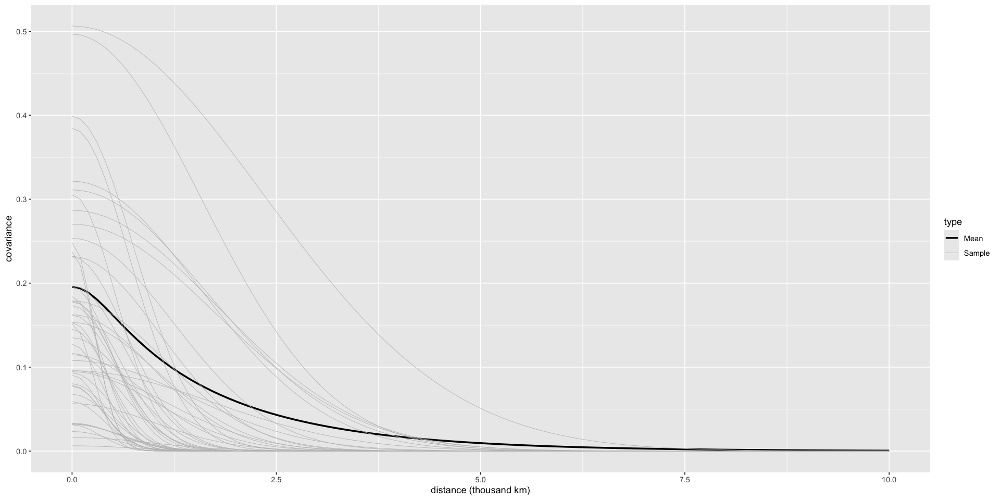

In [123]:
post <- extract.samples(m14.8)

x_seq <- seq(from = 0, to = 10, length.out = 100)
pmcov <- sapply(x_seq, function(x) post$etasq * exp(-post$rhosq * x^2))
pmcov_mu <- apply(pmcov, 2, mean)

plot_df <- data.frame(x = x_seq, y = pmcov_mu, type = "Mean")

p <- ggplot() +
    geom_line(data = plot_df, mapping = aes(x, y, linewidth = type))

for (i in 1:50) {
    sample_plot_df <- data.frame(
        x = x_seq,
        y = post$etasq[i] * exp(-post$rhosq[i] * x_seq ^ 2),
        type = "Sample"
    )
    p <- p + geom_line(data = sample_plot_df, mapping = aes(x, y, linewidth = type), colour = 'grey')
}
p <- p +
    scale_linewidth_manual(values = c("Mean" = 1, "Sample" = 0.25)) +
    labs(x = "distance (thousand km)", y = "covariance")
print(p)

So there's a lot of uncertainty about the spatial effect. There's a lot of uncertainty, but almost all of the curves decline to basically zero by the 4000 km mark.

It's hard to interpret these directly, since they're on the log-count scale. So let's consider the correlations among societies implied by the posterior median.

In [124]:
# compute posterior median covariance
K <- matrix(0, nrow = 10, ncol = 10)
for (i in 1:10) {
    for (j in 1:10) {
        K[i, j] <- median(post$etasq) * exp(-median(post$rhosq) * islandsDistMatrix[i, j] ^ 2)
    }
}
diag(K) <- median(post$etasq) + 0.01

# now convert to a correlation matrix
Rho <- round(cov2cor(K), 2)
# column and row names
cols <- c("Ml", "Ti", "SC", "Ya", "Fi", "Tr", "Ch", "Mn", "To", "Ha")
colnames(Rho) <- cols 
rownames(Rho) <- colnames(Rho)
Rho

,Ml,Ti,SC,Ya,Fi,Tr,Ch,Mn,To,Ha
Ml,1.00,0.79,0.70,0.00,0.31,0.05,0.00,0.00,0.08,0
Ti,0.79,1.00,0.87,0.00,0.31,0.05,0.00,0.01,0.06,0
SC,0.70,0.87,1.00,0.00,0.17,0.12,0.01,0.02,0.02,0
Ya,0.00,0.00,0.00,1.00,0.00,0.01,0.16,0.14,0.00,0
Fi,0.31,0.31,0.17,0.00,1.00,0.00,0.00,0.00,0.61,0
Tr,0.05,0.05,0.12,0.01,0.00,1.00,0.09,0.55,0.00,0
Ch,0.00,0.00,0.01,0.16,0.00,0.09,1.00,0.32,0.00,0
Mn,0.00,0.01,0.02,0.14,0.00,0.55,0.32,1.00,0.00,0
To,0.08,0.06,0.02,0.00,0.61,0.00,0.00,0.00,1.00,0
Ha,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1


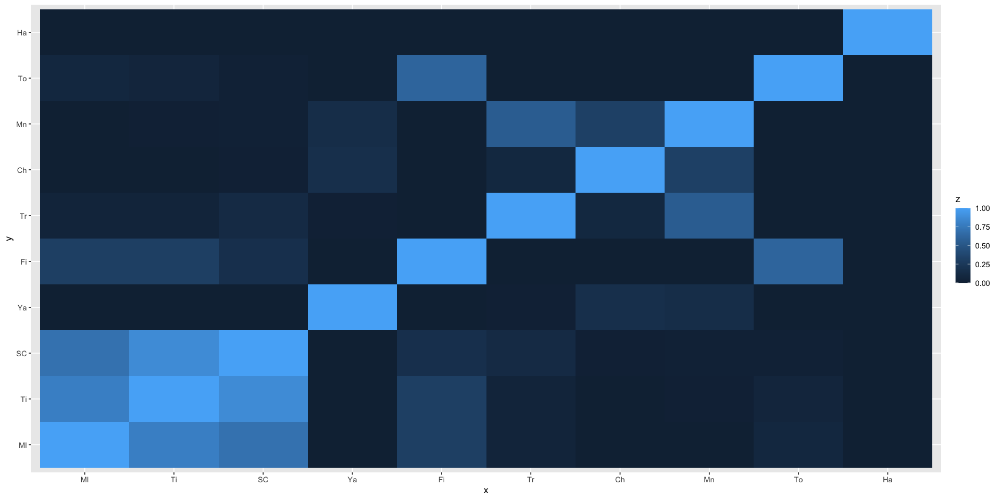

In [125]:
island_correlation_data <- expand.grid(x = cols, y = cols)
island_correlation_plot_df <- data.frame(
    x = island_correlation_data$x,
    y = island_correlation_data$y,
    z = apply(island_correlation_data, 1, function(row) Rho[row['x'], row['y']])
)
ggplot(island_correlation_plot_df, aes(x, y, fill = z)) +
    geom_tile()

So we have a cluster of societies that are highly correlated with each other. We'll also see in a sec that they are very close to each other geographically and also have similar tool totals. On the other end there's Hawai'i, which is so far from every other island that the correlations have basically faded to 0.

Let's plot where the islands are in relation to each other!

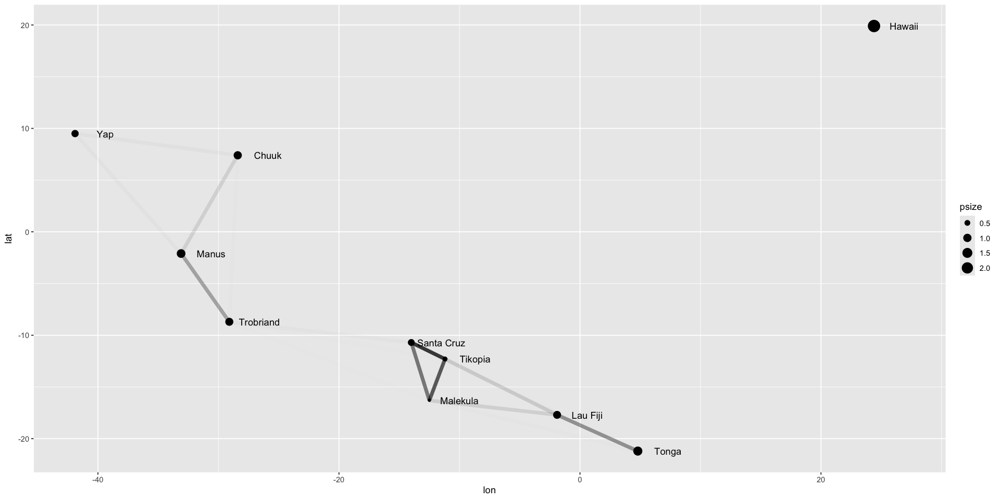

In [126]:
psize <- d$logpop / max(d$logpop)
psize <- exp(psize * 1.5) - 2

island_position_df <- data.frame(lon = d$lon2, lat = d$lat, name = d$culture, psize = psize)
p <- ggplot() +
    geom_point(data = island_position_df, mapping = aes(lon, lat, size = psize)) +
    geom_text(data = island_position_df, mapping = aes(lon, lat, label = name), nudge_x = 2.5)

# now overlay the correlations
for (i in 1:10) {
    for (j in 1:10) {
        if (i < j) {
            df <- data.frame(x = d$lon2[i], y = d$lat[i], xend = d$lon2[j], yend = d$lat[j])
            p <- p + geom_segment(data = df, mapping = aes(x, y, xend = xend, yend = yend), linewidth = 2, alpha = Rho[i, j]^2)
        }
    }
}
print(p)

So here we can see the correlation between the islands. The three islands of Makeluka, Santa Cruz, and Tikopia stand out as being closely correlated. However, since we don't have the number of tools on this plot it's not clear what we expect to see.

Let's compare against the simultaneous relationship between tools and log population. We'll plot the average posterior predictive relationship between log population and toal tools with the shaded correlation lines for each pair of societies.

NULL

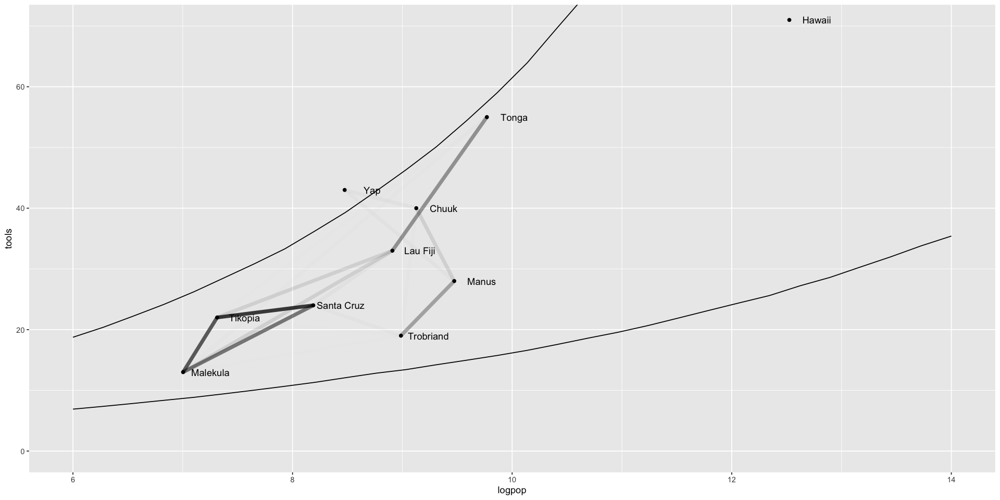

In [127]:
# Compute the posterior meduan relationship without distance
logpop.seq <- seq(from = 6, to = 14, length.out = 30)
post$bp
lambda <- sapply(logpop.seq, function(lp) exp(post$a + post$b * lp))
lambda.median <- apply(lambda, 2, median)
lambda.PI80 <- apply(lambda, 2, PI, prob = 0.8)

plot_df <- data.frame(
    logpop = d$logpop,
    tools = d$total_tools,
    name = d$culture
)

lines_df <- rbind(
    data.frame(
        logpop = logpop.seq,
        lambda = lambda.median,
        type = "Median"
    ),
    data.frame(
        logpop = logpop.seq,
        lambda = lambda.PI80[1, ],
        type = "Lower"
    ),
    data.frame(
        logpop = logpop.seq,
        lambda = lambda.PI80[2, ],
        type = "Upper"
    )
)

p <- ggplot() +
    geom_point(data = plot_df, mapping = aes(logpop, tools)) +
    geom_text(data = plot_df, mapping = aes(logpop, tools, label = name), nudge_x = 0.25) +
    geom_line(data = lines_df, mapping = aes(logpop, lambda, group = type)) +
    coord_cartesian(ylim = c(0, 70))

# overlay the correlations
for (i in 1:10) {
    for (j in i:10) {
        if (i < j) {
            df <- data.frame(x = d$logpop[i], y = d$total_tools[i], xend = d$logpop[j], yend = d$total_tools[j])
            p <- p + geom_segment(data = df, mapping = aes(x, y, xend = xend, yend = yend), alpha = Rho[i, j]^2, linewidth = 2)
        }
    }
}

print(p)

This makes it a bit easier to see that the correlation among the three islands (Malekula, Tikopia, and Santa Cruz) is because they're all below the expected value. This, along with their spatial closeness, is consistent with spatial covariance.

Of course, the correlations here could be the result of other factors (such as ecology or geology). As always, the output is consistent with other causal explanations.

Note that this model uses a regular [[Poisson]] likelihood, meaning that it is sensitive to outliers like Hawai'i. We could use a [[gamma-Poisson]] likelihood instead (like in [[Chapter 12]]). However, the use of varying effects already induces additional dispersion around the mean.

---

Overthinking: non-centred islands

To build a non-centred Gaussian process, we can use the same general trick of converting the covariance matrix to a Cholesky factor and then multiplying by the $z$-score of the varying effect.

In [128]:
m14.8nc <- ulam(
    alist(
        T ~ dpois(lambda),
        lambda <- (a * P ^ b / g) * exp(k[society]),

        #non-centred Gaussian Process prior
        transpars> vector[10]: k <<- L_SIGMA * z,
        vector[10]: z ~ normal(0, 1),
        transpars> matrix[10, 10]: L_SIGMA <<- cholesky_decompose(SIGMA),
        transpars> matrix[10, 10]: SIGMA <- cov_GPL2(Dmat, etasq, rhosq, 0.01) ,

        c(a, b, g) ~ dexp(1),
        etasq ~ dexp(2),
        rhosq ~ dexp(0.5)
    ),
    data = dat_list,
    chains = 4,
    cores = 4,
    iter = 2000
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...



Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 1 If this warning occurs sporadically, such as for highly constrained 

Chain 2 Iteration:    1 / 2000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 2 If this warning occurs sporadically, such as for highly constrained 

Chain 4 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 4 Iteration:  100 / 2000 [  5%]  (Warmup) 
Chain 4 Iteration:  200 / 2000 [ 10%]  (Warmup) 


Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4

Chain 2 Iteration:  100 / 2000 [  5%]  (Warmup) 
Chain 2 Iteration:  200 / 2000 [ 10%]  (Warmup) 


Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4

Chain 3 Iteration:    1 / 2000 [  0%]  (Warmup) 


Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 37, column 4 to column 40)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Ex

Chain 4 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 4 Iteration:  400 / 2000 [ 20%]  (Warmup) 


Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exceptio

Chain 2 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 2 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 3 Iteration:  100 / 2000 [  5%]  (Warmup) 


Chain 3 Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 37, column 4 to column 40)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 37, column 4 to column 40)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often

Chain 4 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 1 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 1 Iteration:  100 / 2000 [  5%]  (Warmup) 
Chain 1 Iteration:  200 / 2000 [ 10%]  (Warmup) 


Chain 1 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e4c92a0c0.stan', line 51, column 4 to column 26)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your m

Chain 2 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 2 Iteration:  600 / 2000 [ 30%]  (Warmup) 
Chain 4 Iteration:  600 / 2000 [ 30%]  (Warmup) 
Chain 4 Iteration:  700 / 2000 [ 35%]  (Warmup) 
Chain 2 Iteration:  700 / 2000 [ 35%]  (Warmup) 
Chain 3 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 4 Iteration:  800 / 2000 [ 40%]  (Warmup) 
Chain 2 Iteration:  800 / 2000 [ 40%]  (Warmup) 
Chain 2 Iteration:  900 / 2000 [ 45%]  (Warmup) 
Chain 3 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 4 Iteration:  900 / 2000 [ 45%]  (Warmup) 
Chain 1 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 3 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 4 Iteration: 1000 / 2000 [ 50%]  (Warmup) 
Chain 4 Iteration: 1001 / 2000 [ 50%]  (Sampling) 
Chain 1 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 2 Iteration: 1000 / 2000 [ 50%]  (Warmup) 
Chain 2 Iteration: 1001 / 2000 [ 50%]  (Sampling) 
Chain 3 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 4 Iteration: 1100 / 2000 [ 55%]  (Sampling) 
Chain 1 Iterat

Apparently this is more efficient, with the cost of it being more difficult to parse (by humans).

We didn't need it in this case, but if you have a large `SIGMA` matrix (like in the next example) it'll be necessary.

---

### Example: Phylogenetic Distance

Species can also be thought of like islands, in that they have a distance from one another. However, in this case the distance is temporal; that is, the time since their last common ancestor. If species have a more recent common ancestor, then in general they'll share more traits in common.

Phylogenetic distance has two important causal influences
1. Species that separated only recently tend to be more similar, assuming that the traits are not maintained by selection but drifing around randonly ([[Brownian Motion Model]]).
1. The second influence is indirect. Phylogenetic distance is a proxy for unovserved variables taht generate covariation among species, even when selection matters. For example, all mammals nurse their young with milk. Similarly, flight in birds influences many other traits.These discrete, life history altering traits can have a strong influence on other traits. When not observed, phylogenetic distance is a potentially useful proxy for these variables, byt only if the trat model captures the right details. These methods do not just work aytomatically, as they are too often presented in journals.

For instance, consider the effect of group size $G$ on brain size $B$. It's common to hypothesize a connection between them because we are unusual in both. Most primates live in social groups, but most other mammals do not. Second, primates have relatively large brains. There's a family of hypotheses linking these two.

Suppose, for example, that group living helps select for larger brains (say because when you live with others then you need to keep track of social dynamics). This would imply a causal time series.

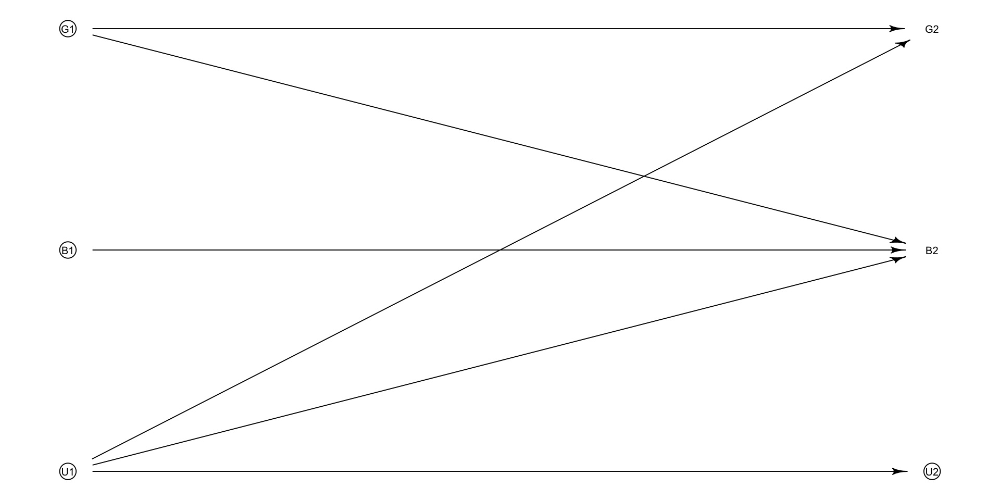

In [129]:
par(bg = 'white')
brain_group_dag <- dagitty('dag {
    G1[latent, pos="0,0"]
    G2[pos="1,0"]
    B1[latent, pos="0,1"]
    B2[pos="1,1"]
    U1[latent, pos="0,2"]
    U2[latent, pos="1,2"]
    G1 -> G2
    G1 -> B2
    B1 -> B2
    U1 -> U2
    U1 -> B2
    U1 -> G2
}')
drawdag(brain_group_dag)

The subscripts are time points in the history of different populations. For instance, $G_1$ is the group size at time 1, &c. There are plausibly many, many confounds, shown here as $U_1$ and $U_2$. Each variable influences itself at the next time interval. There is also a causal influence of $G_1$ on $B_2$ - a species' recent group size affects its brain size. That's what we'd like to estimate. However, the confounds $U_1$ and $U_2$ potentialy affect everything. Since we can't observe $U_1$, we can't just condition on it.We also don't even have $G_1$ to use in the model!

Since we didn't observe the past, we need a way to estimate its effect. This is where the branching history of species can come in. Phylogeny is associated with the patterns of covariance across species because the more recently in time two species diverged, the more association we expect to see. We should be able to use this fact to help us reconstruct the confounds. This depends on both having a good phylogeny and a good model of the relationship between phylogenetic distance and trait evolution. Neither is trivial, but at least the approach is justified in theory, if not always in practice.

The approach looks like this.

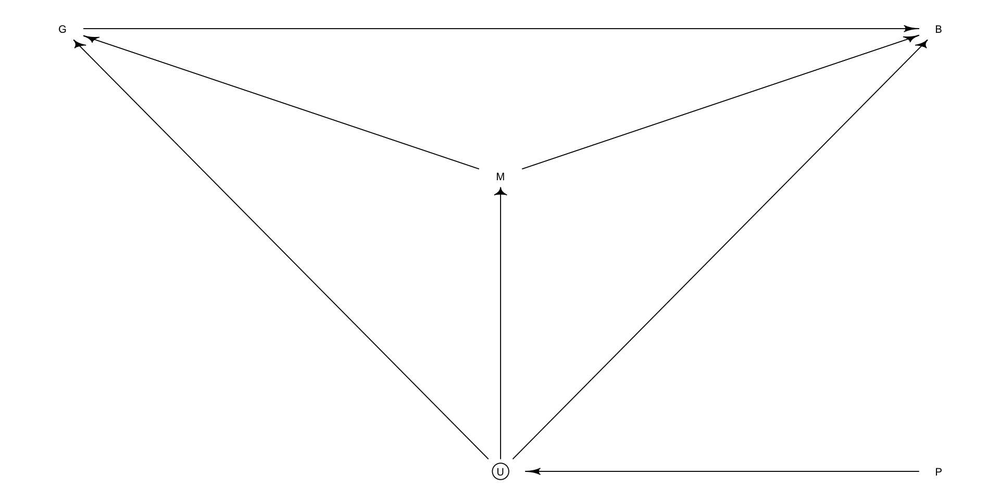

In [130]:
par(bg = 'white')
model_dag <- dagitty('dag {
P[pos="1,0"]
U[latent, pos="0,0"]
M[pos="0,-1"]
G[pos="-1,-1.5"]
B[pos="1,-1.5"]
P -> U -> M -> B <- U
M -> G <- U
G -> B
}')
drawdag(model_dag)

We're interested in $G \to B$. There is one confound we know for sure: the body mass, $M$. Is possible influences both $G$ and $B$, so we'll include it in the model. The unobserved confound $U$ could influence any of these. Finally, we let the phylogenetic relationship ($P$) influence the confound $U$. How is $P$ causal? If we travel back in time and delayed a split between two species, it could influence the expected differences in their traits. It's really the timing of the split that's causal, not the phylogeny. Of course, $P$ could also influence $G$, $B$, and $M$ directly, but we don't really care about that right now.

We also want to be sure that any association between $B$ and $G$ is not through a backdoor, so we need to check all of the paths from $G$ to $B$. There are backdoor paths through $U$ and $M$. We condition on $M$ to block the confound, but we can't condition on $U$. We would like to use $P$ to somehow reconstruct the covariation that $U$ induces between $G$ and $B$.

A [[Generalized Linear Model]] that try to include phylogenetic distance are [[Phylogenetic Regression]], and they are famously hard. The example we'll do here is the simplest method but almost surely not the best - you should use a better method for your actual studies.

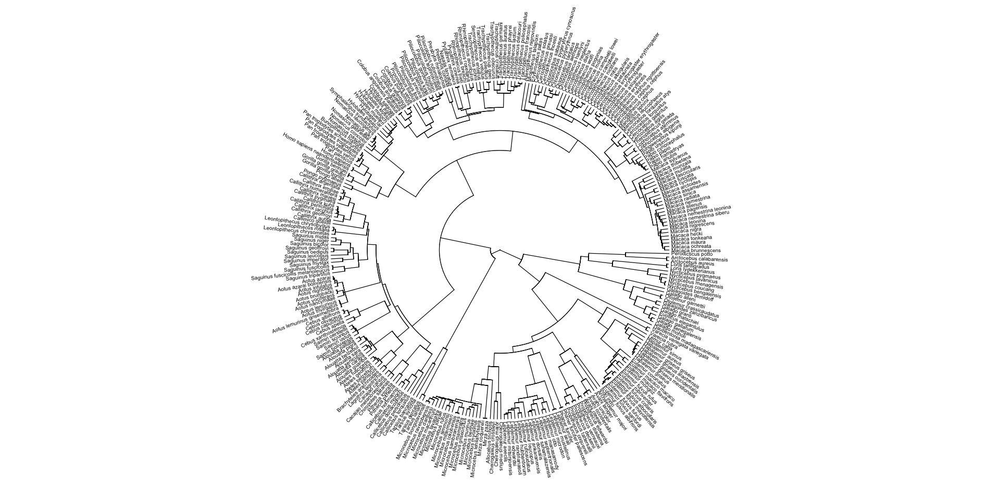

In [131]:
data(Primates301)
data(Primates301_nex)

par(bg = 'white')
plot(ladderize(Primates301_nex), type = 'fan', font = 1, no.margin = TRUE, label.offset = 1, cex = 0.5)

The above tree is what we'll use for the [[Phylogenetic Regression]].

Before we incorporate the phylogenetic information, let's run an ordinary regression analyzing log group size against log brain size and log body size. We're going to build this in a weird way to prepare us for incorporating the phylogeny.

We're going to think of each species as a vector of 301 variables. Some of those values are more similar to one another. In a typical regression, we model those similarities using predictor variables. After conditioning ont he predictor variables, to model expects correlations. We can write the model using a big multivariate outcome distribution.

$$
\begin{align*}
\textbf{B} &\sim \text{MVNormal}(\mu, \textbf{S}) \\
\mu_i &= \alpha + \beta_G G_i + \beta_M M_i \\
\end{align*}
$$

Here $\textbf{B}$ is a vector of species brain sizes and $\textbf{S}$ is a covariance matrix with as many rows and columns as there are species. In an ordinary regression this looks like

$$
\textbf{S} = \sigma^2 \textbf{I}
$$

The variable $\sigma$ is just our regular standard deviation that we've been using already. Since we multiply it by the identity matrix (all zeroes except 1 on the diagonals), we're building into the model the idea that all of the covariances are zero; they're independent.

This is a regular linear regression, but now we're thinking of it having a single, multivariate outcome.

In [132]:
# get rid of the ones for which we don't have brain size, group size, and body size.
d <- Primates301
d$name <- as.character(d$name)
dstan <- d[complete.cases(d$group_size, d$body, d$brain), ]
spp_obs <- dstan$name

# we should have 151 species with complete observations
length(spp_obs)

[1] 151

In [133]:
dat_list <- list(
    N_spp = nrow(dstan),
    M = standardize(log(dstan$body)),
    B = standardize(log(dstan$brain)),
    G = standardize(log(dstan$group_size)),
    Imat = diag(nrow(dstan))
)

m14.9 <- ulam(
    alist(
        B ~ multi_normal(mu, SIGMA),
        mu <- a + bM * M + bG * G,
        matrix[N_spp, N_spp]: SIGMA <- Imat * sigma_sq,
        a ~ normal(0, 1),
        c(bM, bG) ~ normal(0, 0.5),
        sigma_sq ~ exponential(1)
    ),
    data = dat_list,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66c13ab4.stan', line 25, column 4 to column 35)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 



Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66c13ab4.stan', line 25, column 4 to column 35)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66c13ab4.stan', line 25, column 4 to column 35)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 501 / 1000 [ 50%]  

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,-3.295177e-05,0.017950442,-0.02894346,0.02828460,1.0016603,1830.546
bG,1.243187e-01,0.023580461,0.08776255,0.16148193,1.0046110,1230.605
bM,8.923587e-01,0.023925331,0.85422579,0.93085714,1.0040424,1235.346
sigma_sq,4.757258e-02,0.005648286,0.03903431,0.05706706,0.9998794,1929.061


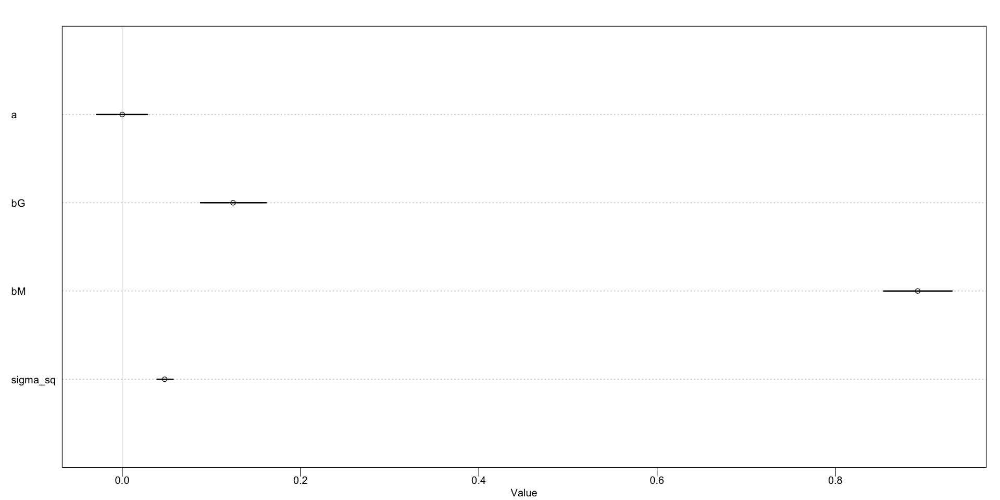

In [134]:
par(bg = 'white')
precis(m14.9)
plot(precis(m14.9))

So we see a positive relationship between the group size and brain size and a much stronger one between body mass and brain size (unsurprisingly). We can't really say anything causally here because there are *so many* confounds.

Now we're going to do two kinds of phylogenetic regression. Both involve replacing the covariance matrix with something a little more exciting.

The first is the oldest and most conservative approach: a [[Brownian Motion Model]]. This represents evolution as a random walk, which implies a very specific kind of covariance matrix. If the species traits drift randomly, then we expect the covariance between species to be **linearly related** to the distance between them - that is, species which have been separated from each other for twice as long should have 1/2 the covariance, &c. We are pretty sure that this is wrong - the traits don't evolve neutrally and they speed up / slow down in different parts of the tree.

Let's compute the implied covariance and distance matrices and then show how they're related.

In [135]:
tree_trimmed <- keep.tip(Primates301_nex, spp_obs)
Rbm <- corBrownian(phy = tree_trimmed)
V <- vcv(Rbm)
Dmat <- cophenetic(tree_trimmed)
head(V)
head(Dmat)

Warning message in Initialize.corPhyl(phy, dummy.df):
“No covariate specified, species will be taken as ordered in the data frame. To avoid this message, specify a covariate containing the species names with the 'form' argument.”


,Allenopithecus_nigroviridis,Cercopithecus_albogularis,Cercopithecus_ascanius,Cercopithecus_campbelli,Cercopithecus_cephus,Cercopithecus_diana,Cercopithecus_lhoesti,Cercopithecus_mitis,Cercopithecus_neglectus,Cercopithecus_nictitans,⋯,Galago_matschiei,Galago_moholi,Galago_senegalensis,Galagoides_demidoff,Galagoides_zanzibaricus,Otolemur_crassicaudatus,Otolemur_garnettii,Tarsius_bancanus,Tarsius_dentatus,Tarsius_syrichta
Allenopithecus_nigroviridis,73.00302,61.10812,61.10812,61.10812,61.10812,61.10812,61.10812,61.10812,61.10812,61.10812,⋯,0,0,0,0,0,0,0,4.162986,4.162986,4.162986
Cercopithecus_albogularis,61.10812,73.00302,66.57381,65.11280,66.57381,65.11280,63.15489,70.51152,65.11280,69.24038,⋯,0,0,0,0,0,0,0,4.162986,4.162986,4.162986
Cercopithecus_ascanius,61.10812,66.57381,73.00302,65.11280,70.98408,65.11280,63.15489,66.57381,65.11280,66.57381,⋯,0,0,0,0,0,0,0,4.162986,4.162986,4.162986
Cercopithecus_campbelli,61.10812,65.11280,65.11280,73.00302,65.11280,67.01574,63.15489,65.11280,67.01574,65.11280,⋯,0,0,0,0,0,0,0,4.162986,4.162986,4.162986
Cercopithecus_cephus,61.10812,66.57381,70.98408,65.11280,73.00302,65.11280,63.15489,66.57381,65.11280,66.57381,⋯,0,0,0,0,0,0,0,4.162986,4.162986,4.162986
Cercopithecus_diana,61.10812,65.11280,65.11280,67.01574,65.11280,73.00302,63.15489,65.11280,67.41451,65.11280,⋯,0,0,0,0,0,0,0,4.162986,4.162986,4.162986


,Allenopithecus_nigroviridis,Cercopithecus_albogularis,Cercopithecus_ascanius,Cercopithecus_campbelli,Cercopithecus_cephus,Cercopithecus_diana,Cercopithecus_lhoesti,Cercopithecus_mitis,Cercopithecus_neglectus,Cercopithecus_nictitans,⋯,Galago_matschiei,Galago_moholi,Galago_senegalensis,Galagoides_demidoff,Galagoides_zanzibaricus,Otolemur_crassicaudatus,Otolemur_garnettii,Tarsius_bancanus,Tarsius_dentatus,Tarsius_syrichta
Allenopithecus_nigroviridis,0.00000,23.78981,23.789805,23.78980,23.789806,23.78980,23.78981,23.789805,23.78980,23.78981,⋯,146.006,146.006,146.006,146.006,146.006,146.006,146.006,137.6801,137.6801,137.6801
Cercopithecus_albogularis,23.78981,0.00000,12.858418,15.78044,12.858419,15.78044,19.69625,4.983006,15.78044,7.52528,⋯,146.006,146.006,146.006,146.006,146.006,146.006,146.006,137.6801,137.6801,137.6801
Cercopithecus_ascanius,23.78981,12.85842,0.000000,15.78044,4.037887,15.78044,19.69625,12.858418,15.78044,12.85842,⋯,146.006,146.006,146.006,146.006,146.006,146.006,146.006,137.6801,137.6801,137.6801
Cercopithecus_campbelli,23.78980,15.78044,15.780435,0.00000,15.780436,11.97456,19.69625,15.780435,11.97456,15.78044,⋯,146.006,146.006,146.006,146.006,146.006,146.006,146.006,137.6801,137.6801,137.6801
Cercopithecus_cephus,23.78981,12.85842,4.037887,15.78044,0.000000,15.78044,19.69625,12.858419,15.78044,12.85842,⋯,146.006,146.006,146.006,146.006,146.006,146.006,146.006,137.6801,137.6801,137.6801
Cercopithecus_diana,23.78980,15.78044,15.780435,11.97456,15.780436,0.00000,19.69625,15.780435,11.17702,15.78044,⋯,146.006,146.006,146.006,146.006,146.006,146.006,146.006,137.6801,137.6801,137.6801


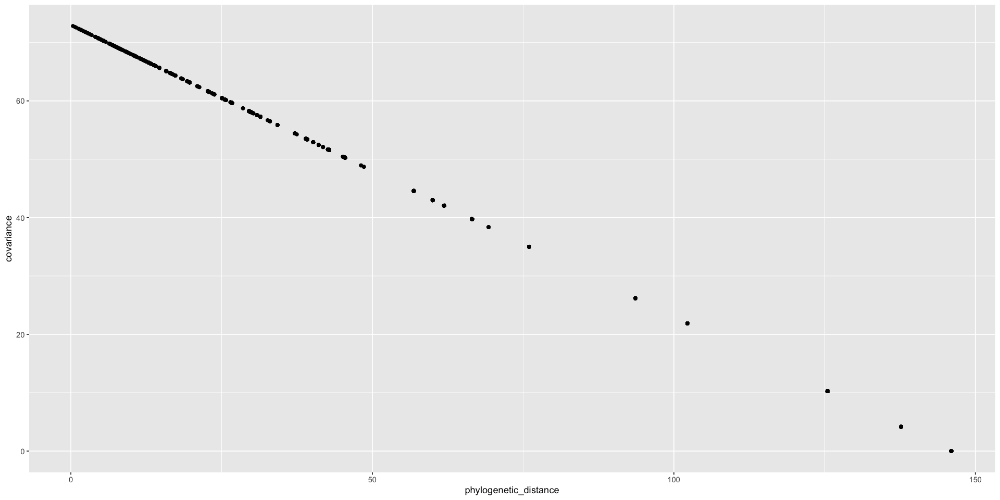

In [136]:
species <- colnames(V)
species_pairs <- combn(species, 2) # all combinations of length 2
distances_df <- data.frame(
    species1 = species_pairs[1, ],
    species2 = species_pairs[2, ]
)
distances_df$phylogenetic_distance <- apply(distances_df, 1, function(row) { 
    s1 <- row['species1']
    s2 <- row['species2']
    distance <- Dmat[s1, s2]
    distance
})
distances_df$covariance = apply(distances_df, 1, function(row) V[row['species1'], row['species2']])

ggplot(distances_df, aes(phylogenetic_distance, covariance)) +
    geom_point()

Now we need to put this into the regression. The model is otherwise unchanged; we're just changing the shape of the covariance matrix.

However, we will need to put the covariance matrix in the same order as the data.

In [137]:
# putting the species in the right order
dat_list$V <- V[spp_obs, spp_obs]

# convert to correlation matrix
dat_list$R <- dat_list$V / max(V)

# brownian motion model
m14.10 <- ulam(
    alist(
        B ~ multi_normal(mu, SIGMA),
        mu <- a + bM * M + bG * G,
        matrix[N_spp, N_spp]: SIGMA <- R * sigma_sq,
        a ~ normal(0, 1),
        c(bM, bG) ~ normal(0, 0.5),
        sigma_sq ~ exponential(1)
    ),
    data = dat_list,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e21ce5c4c.stan', line 27, column 4 to column 35)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 



Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = inf, but Covariance matrix[2,1] = inf (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e21ce5c4c.stan', line 27, column 4 to column 35)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = inf, but Covariance matrix[2,1] = inf (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e21ce5c4c.stan', line 27, column 4 to column 35)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e21ce5c4c.stan', line 27, column 4 to column 35)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 500 / 1000 [ 50%]

In [138]:
precis(m14.10)

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,-0.20386522,0.17200874,-0.47484977,0.06385980,1.003043,2504.739
bG,-0.01248191,0.02004509,-0.04449857,0.02025438,1.006052,2289.633
bM,0.69886028,0.03759692,0.63693610,0.75974211,1.004202,2145.878
sigma_sq,0.16184627,0.01955924,0.13325514,0.19526632,1.003058,2149.252


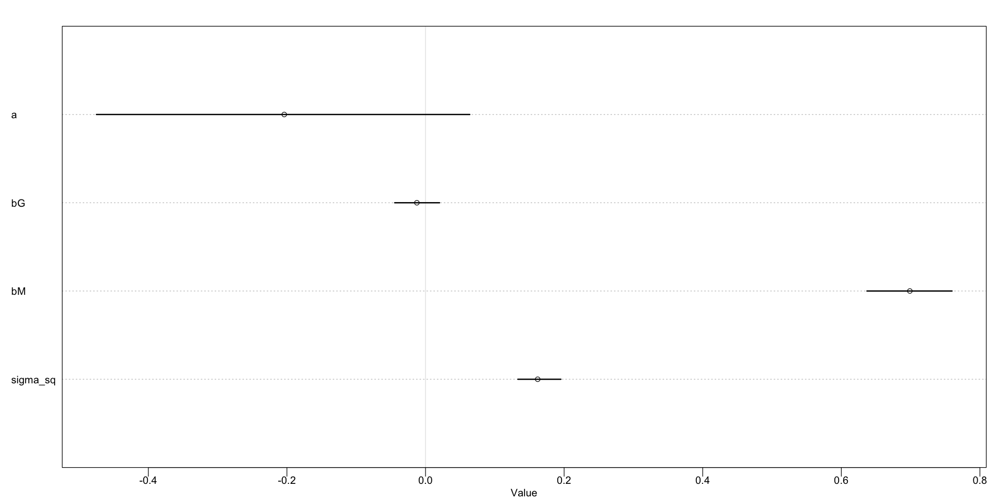

In [139]:
par(bg = 'white')
plot(precis(m14.10))

According to this model, group size probably has very little to do with brain size. Instead, the explanation seems to be that it's the mass of the animal that ha the biggest effect!

This suggests to us that there's a lot of clustering of brain size in the tree, and that that is what is giving us the group size $\to$ brain size signal.

The [[Brownian Motion Model]] is a special kind of [[Gaussian Process Model]] in which the covariance declines in a very rigid way with increasing distance (see the covariance plot above). 

There is no need to use this very rigid approach and a lot of reasons to think that evolution is not well-described by a [[Brownian Motion Model]]. One approach is to use [[Pagel's Lambda]], which is basically just scaling the species correlation by some common factor; it still uses the same unrealistic distance model.

Another common approach is to use the [[Ornstein-Uhlenbeck Process]], which is a damped Brownian motion process that tends to return tworms some mean (or means). In practice, this constrains the variation, making the relationship between phylogenetic distance and covariance non-linear.

The [[Ornstein-Ohlenbeck Process|OU Process]] defines the covariance between two species $i$, $j$ as 

$$
K(i, j) = \eta^2 \text{exp}(-\rho^2 D_{ij})
$$

This is an exponential kernel, in contrast to the quadratic kernel in the previous example. This has the effect of saying that covariance decays much more rapidly, leading to less smooth functions. It is also usually harder to fit to data, since it's so much rougher. When fitting this kind of model, you need to be very careful about your priors, which may be a bad thing (you may over-constrain them to get the model to fit). 

The [[Ornstein-Uhlenbeck Process|OU Process]] is still just a [[Gaussian Process Model]], and we can fit it in the same way as previously. The literature on [[Phylogenetic Regression]] has not emphasized this (apparently), but describing this as a Gaussian process allows us to customize the function space as our problem requires.

There is no one 'correct' way to use phylogenetic distance. If the goal is to estimate a causal effect, then it isn't good enough to reject some null model; we need to construct patterns among unmeasured confounds. It will often be true that the information in a phylogeny is inadquequate for causal inference.

To build the [[Gaussian Process Regression]], we need a distance matrix. We actually computed this earlier. Then we need a line of code to add the Gaussian process to the model. We'll use the [[Ornstein-Uhlenbeck Process|OU Process]] kernel, which is more generally known as the L1 Norm; `ulam` provides this as `cov_GPL1`.

In [140]:
# add scaled and reordered distance matrix
dat_list$Dmat <- Dmat[spp_obs, spp_obs] / max(Dmat)

m14.11 <- ulam(
    alist(
        B ~ multi_normal(mu, SIGMA),
        mu <- a + bM * M + bG * G,
        matrix[N_spp, N_spp]: SIGMA <- cov_GPL1(Dmat, etasq, rhosq, 0.01),
        a ~ normal(0, 1),
        c(bM, bG) ~ normal(0, 0.5),
        etasq ~ half_normal(1, 0.25),
        rhosq ~ half_normal(3, 0.25)
    ),
    data = dat_list,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e3e4729de.stan', line 47, column 4 to column 35)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e3e4729de.stan', line 47, column 4 to column 35)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 500 / 1000 [ 50%]

In [141]:
precis(m14.11)

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,-0.06515754,0.077896677,-0.18761591,0.06108869,1.002881,2139.718
bG,0.05017998,0.022556676,0.01357589,0.08676511,1.001231,2094.046
bM,0.83304486,0.028774223,0.78691549,0.87801904,1.001228,2052.243
etasq,0.03508739,0.006932443,0.02555869,0.04717035,1.000250,2113.593
rhosq,2.79757602,0.243679334,2.39562790,3.18810165,1.004693,2380.155


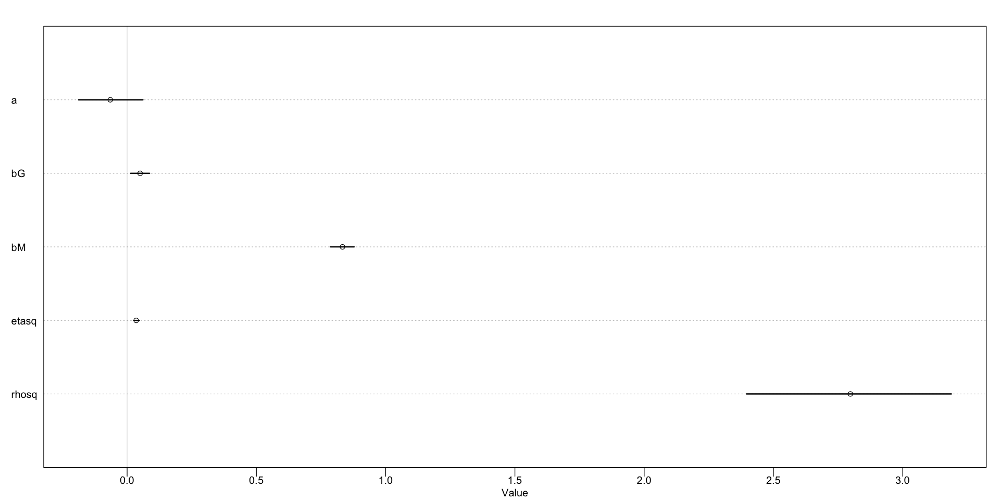

In [142]:
par(bg = 'white')
plot(precis(m14.11))

So now we have a different result! We see a weak relationship between group size and brain size again. Why? Well, the only thing that changed was the covariance model, so it must be that. The OU model expects *less* covariance, and so when we see clustering it is more likely to explain it as being the result of the non-phylogenetic data.

Let's look at the implied posterior covariance relationship implied.

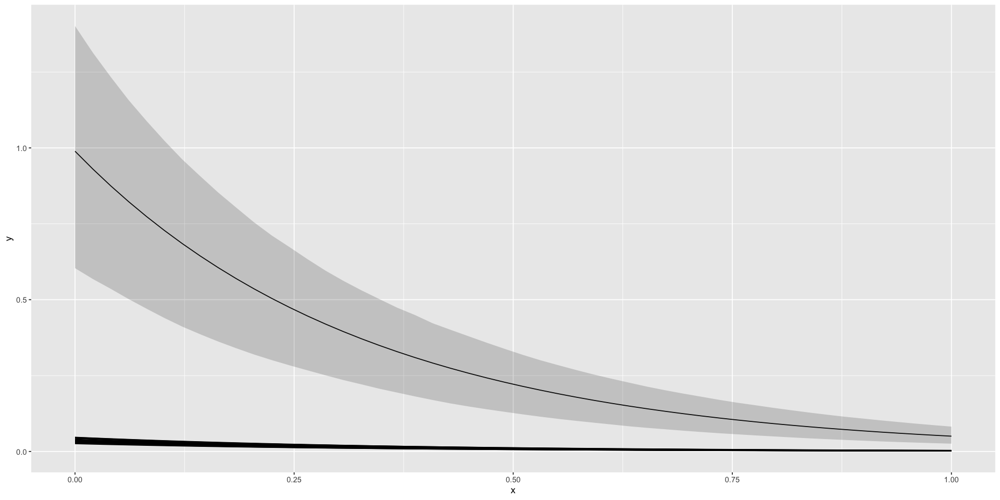

In [143]:
post <- extract.samples(m14.11)

p <- ggplot()
phylo_distances <- seq(0, max(dat_list$Dmat), length.out = 100)

# posterior
for (i in 1:30) {
    cov <- post$etasq[i] * exp(-post$rhosq[i] * phylo_distances)
    p <- p + geom_line(data = data.frame(x = phylo_distances, y = cov, run = i), mapping = aes(x, y, group = run))
}

# prior
eta <- abs(rnorm(1e3, 1, 0.25))
rho <- abs(rnorm(1e3, 3, 0.25))
d_seq <- seq(from = 0, to = 1, length.out = 50)
K <- sapply(d_seq, function(x) eta * exp(-rho * x))

# mean and PI
prior_df <- data.frame(
    x = d_seq, 
    mean = colMeans(K),
    lower = apply(K, 2, PI)[1, ],
    upper = apply(K, 2, PI)[2, ]
)
p <- p + 
    geom_line(data = prior_df, mapping = aes(x, mean)) +
    geom_ribbon(data = prior_df, mapping = aes(x, ymin = lower, ymax = upper), alpha = 0.2)

print(p)

So we see that the posterior has a lot less implied covariance than the prior. As a result, this model doesn't explain away the connection between group size and brain mass as being largely the result of phylogeny, as the previous model did.

---
**Overthinking: building custom kernels**

The `overthinking` package provides a custom `cov_GPL1` (OU model) and `cov_GPL2` (quadratic kernel) for building [[Gaussian Process]] covariance matrices, but it's not hard to just do it yourself.

For instance, if you see `standcode(m14.11)`, you can see the code for `cov_GPL1` in the `functions` block.

In [144]:
stancode(m14.11)

functions{


    matrix cov_GPL1(matrix x, real sq_alpha, real sq_rho, real delta) {
        int N = dims(x)[1];
        matrix[N, N] K;
        for (i in 1:(N-1)) {
          K[i, i] = sq_alpha + delta;
          for (j in (i + 1):N) {
            K[i, j] = sq_alpha * exp(-sq_rho * x[i,j] );
            K[j, i] = K[i, j];
          }
        }
        K[N, N] = sq_alpha + delta;
        return K;
    }
}
data{
     matrix[151,151] R;
     matrix[151,151] V;
     matrix[151,151] Imat;
     int N_spp;
     vector[151] B;
     vector[151] G;
     vector[151] M;
     matrix[151,151] Dmat;
}
parameters{
     real a;
     real bG;
     real bM;
     real<lower=0> etasq;
     real<lower=0> rhosq;
}
model{
     vector[151] mu;
     matrix[N_spp,N_spp] SIGMA;
    rhosq ~ normal( 3 , 0.25 );
    etasq ~ normal( 1 , 0.25 );
    bM ~ normal( 0 , 0.5 );
    bG ~ normal( 0 , 0.5 );
    a ~ normal( 0 , 1 );
    SIGMA = cov_GPL1(Dmat, etasq, rhosq, 0.01);
    for ( i in 1:151 ) {
        mu[i] = a + 

```stan
functions{
    matrix cov_GPL1(matrix x, real sq_alpha, real sq_rho, real delta) {
        int N = dims(x)[1];
        matrix[N, N] K;
        for (i in 1:(N-1)) {
          K[i, i] = sq_alpha + delta;
          for (j in (i + 1):N) {
            K[i, j] = sq_alpha * exp(-sq_rho * x[i,j] );
            K[j, i] = K[i, j];
          }
        }
        K[N, N] = sq_alpha + delta;
        return K;
    }
}
```

This function takes the distance matrix `x` and the parameters of the [[Gaussian Process]], and returns the covariance matrix. To change the kernel, you just change the line

```
K[i, j] = sq_alpha * exp(-sq_rho * x[i, j])
```

For instance, the quadratic kernel would just square `x[i, j]`. Then you just call this custom function inside the `model` block:

```stan
model {
    ...
    SIGMA = cov_GPL1(Dmat, etasq, rhosq, 0.01);
    ...
}
```

## Practice

**14E1** Add to the following model varying slopes on the predictor $x$

At least the way it was done in this chapter, what we want to do is to now have a multivariate distribution between the slope and the intercept. That is, both should come from a common multivariate distribution.

$$
\begin{align*}
y_i &\sim \text{Normal}(\mu_i, \sigma) \\
\mu_i &= \alpha_{\text{GROUP}[i]} + \beta x_i \\
\alpha_{\text{GROUP}} &\sim \text{Normal}(\alpha, \sigma_\alpha) \\
\alpha &\sim \text{Normal}(0, 10) \\
\beta &\sim \text{Normal}(0, 1) \\
\sigma &\sim \text{Exponential}(0, 10) \\
\sigma_\alpha &\sim \text{Exponential}(0, 10) \\
\end{align*}
$$

**Answer**
$$
\begin{align*}
y_i &\sim \text{Normal}(\mu_i, \sigma) \\
\mu_i &= \alpha_{\text{GROUP}[i]} + \textcolor{red}{\beta_{\text{GROUP}[i]}} x_i \\
\textcolor{red}{\begin{pmatrix} \alpha \\ \beta \end{pmatrix}_{\text{GROUP}}} &\textcolor{red}{\sim \text{MVNormal}\left( \begin{pmatrix}\alpha \\ \beta \end{pmatrix}, \textbf{S} \right)} \\
\textcolor{red}{\textbf{S}} &\textcolor{red}{= \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} \textbf{R} \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix}} \\
\textcolor{red}{\textbf{R}} &\textcolor{red}{= \text{LKJCorr}(2)} \\
\alpha &\sim \text{Normal}(0, 10) \\
\textcolor{red}{\beta} &\textcolor{red}{\sim \text{Normal}(0, 1)} \\
\sigma &\sim \text{Exponential}(0, 10) \\
\sigma_\alpha &\sim \text{Exponential}(0, 10) \\
\textcolor{red}{\sigma_\beta} &\textcolor{red}{\sim \text{Exponential}(0, 10)} \\
\end{align*}
$$

**14E2** Think of a situation in which varying intercepts will be positively correlated with varying slopes. Provide a mechanistic explanation for the correlation.

**Answer** What this is asking for is a case where for different groups, having a higher intercept is correlated to then also having a higher rate of change with regard to the underlying predictor. Something like a positive feedback loop. One situation where this could occur is with different groups (say, rich and poor) and the amount of money they have after starting $x$ businesses. The rich group will have a higher intercept (amount of money) to start, and will probably tend to start businesses that each generate more money each (higher slope). The mechanism that mediates this might be that with more money to start the businesses can start out larger, have a bigger reach, &c.

**14E3** When is it possible for a varying slopes model to have fewer effective parameters (as estimated by WAIC or PSIS) than the corresponding model with fixed (unpooled) slopes?

**Answer** If the varying slopes are strongly regularized toward 0, then they can count as fewer than one effective parameter, leading to fewer effective parameters overall as compared to the fixed effects version. This can happen when effectively the different 'clusters' are the same - the cluster that you're in doesn't have a strong effect on the outcome.

**14M1** Repeat the cafe robot simulation from the beginning of the chapter. This time, set `rho` to zero, so that there is no correlation between intercepts and slopes. How does the posterior distribution of the correlation reflect this change in the underlying simulation?

**Answer**

In [145]:
get_simulated_robot_data <- function(rho) {
    a <- 3.5 # average morning wait times
    b <- -1 # average difference in the afternoon wait times
    sigma_a <- 1 # std dev in intercepts
    sigma_b <- 0.5 # std dev in slopes
    # rho <- -0.7 # correlation between intercepts and slopes

    Mu <- c(a, b)

    sigmas <- c(sigma_a, sigma_b) # standard deviations
    Rho <- matrix(c(1, rho, rho, 1), nrow = 2) # correlation matrix

    # matrix multiply to get the covariance matrix
    Sigma <- diag(sigmas) %*% Rho %*% diag(sigmas)

    # simulate the data
    N_cafes <- 20

    set.seed(5)
    vary_effects <- mvrnorm(N_cafes, Mu, Sigma)
    a_cafe <- vary_effects[, 1]
    b_cafe <- vary_effects[, 2]

    set.seed(22)
    N_visits <- 10
    afternoon <- rep(0:1, N_visits * N_cafes / 2)
    cafe_id <- rep(1:N_cafes, each = N_visits)
    mu <- a_cafe[cafe_id] + b_cafe[cafe_id] * afternoon
    sigma <- 0.5 # sd within cafes
    wait <- rnorm(N_visits * N_cafes, mu, sigma)
    d <- data.frame(cafe = cafe_id, afternoon = afternoon, wait = wait)
    d
}

fit_coffee_robot_model <- function(d) {
    # now let's fit the model!
    set.seed(867530)
    robot_model <- ulam(
        alist(
            wait ~ normal(mu, sigma),
            mu <- a_cafe[cafe] + b_cafe[cafe] * afternoon,
            c(a_cafe, b_cafe)[cafe] ~ multi_normal(c(a, b), Rho, sigma_cafe),
            a ~ normal(5, 2),
            b ~ normal(-1, 0.5),
            sigma_cafe ~ exponential(1),
            sigma ~ exponential(1),
            Rho ~ lkj_corr(2)
        ),
        data = d,
        chains = 4,
        cores = 4
    )
    post <- extract.samples(robot_model)
    post
}

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6e2581d4.stan', line 17, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 



Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6e2581d4.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6e2581d4.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6e2581d4.stan', line 17, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6e2581d4.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6e2581d4.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800 / 1

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1dbbe7a0.stan', line 17, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 



Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1dbbe7a0.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1dbbe7a0.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1dbbe7a0.stan', line 17, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1dbbe7a0.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1dbbe7a0.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1

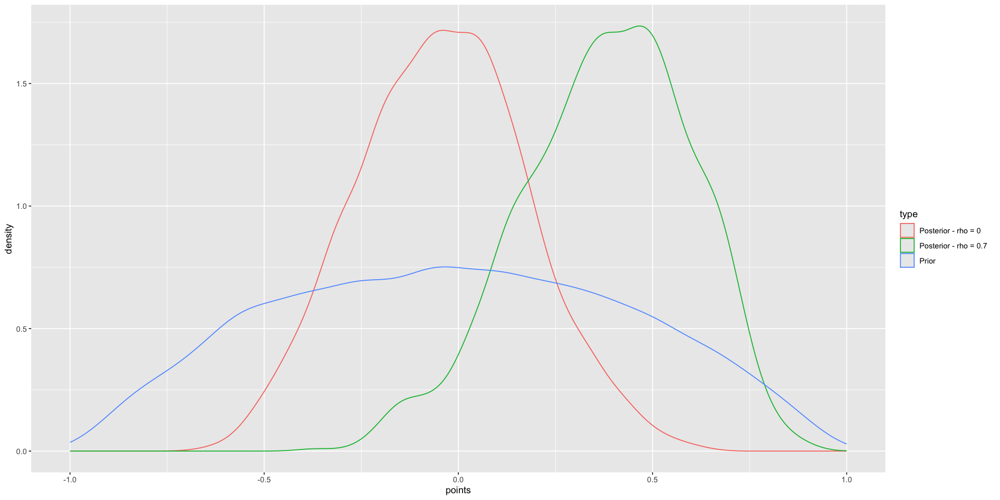

In [146]:
rho.0.data <- get_simulated_robot_data(0)
rho.0.post <- fit_coffee_robot_model(rho.0.data)

rho.0.7.data <- get_simulated_robot_data(0.7)
rho.0.7.post <- fit_coffee_robot_model(rho.0.7.data)

prior_rho <- rlkjcorr(1e4, K = 2, eta = 2)

plot_df <- rbind(
    data.frame(points = rho.0.7.post$Rho[, 1, 2], type = 'Posterior - rho = 0.7'),
    data.frame(points = rho.0.post$Rho[, 1, 2], type = 'Posterior - rho = 0'),
    data.frame(points = prior_rho[, 1, 2], type = 'Prior')
)
ggplot(plot_df, aes(points, colour = type, group = type)) + 
    geom_density() + 
    scale_x_continuous(limits = c(-1, 1))

Unsuprisingly, we are recovering our expected value of `rho`.

**14M2** Fit this multilevel model to the simulated cafe data.

$$
\begin{align*}
W_i &\sim \text{Normal}(\mu_i, \sigma) \\
\mu_i &= \alpha_{\text{CAFE}[i]} + \beta_{\text{CAFE}[i]} A_i \\
\alpha_{\text{CAFE}} &\sim \text{Normal}(\alpha, \sigma_{\alpha}) \\
\beta_{\text{CAFE}} &\sim \text{Normal}(\beta, \sigma_{\beta}) \\
\alpha &\sim \text{Normal}(0, 10) \\
\beta &\sim \text{Normal}(0, 10) \\
\sigma, \sigma_\alpha, \sigma_\beta &\sim \text{Exponenential}(1)
\end{align*}
$$

Use WAIC to compare this model to the model from the chapter, the one that uses a multi-variate Gaussian prior.

**Answer** The major difference between this model and the one that we used before (`m14.1`) is that the earlier model used a multivariate normal for the varying effects while this one does not. Effectively, it's hard-coding in a covariance of 0.

In [147]:
d <- get_simulated_robot_data(0.7)

In [148]:
# original version
set.seed(867530)
m14m2.original <- ulam(
    alist(
        wait ~ normal(mu, sigma),
        mu <- a_cafe[cafe] + b_cafe[cafe] * afternoon,
        c(a_cafe, b_cafe)[cafe] ~ multi_normal(c(a, b), Rho, sigma_cafe),
        a ~ normal(5, 2),
        b ~ normal(-1, 0.5),
        sigma_cafe ~ exponential(1),
        sigma ~ exponential(1),
        Rho ~ lkj_corr(2)
    ),
    data = d,
    chains = 4,
    cores = 4,
    log_lik = TRUE
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e64ca5985.stan', line 17, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 



Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e64ca5985.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e64ca5985.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e64ca5985.stan', line 17, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e64ca5985.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e64ca5985.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800

In [149]:
m14m2.question <- ulam(
    alist(
        wait ~ normal(mu, sigma),
        mu <- a_cafe[cafe] + b_cafe[cafe] * afternoon,
        a_cafe[cafe] ~ normal(alpha, sigma_alpha),
        b_cafe[cafe] ~ normal(beta, sigma_beta),
        alpha ~ normal(0, 10),
        beta ~ normal(0, 10),
        sigma ~ exponential(1),
        sigma_alpha ~ exponential(1),
        sigma_beta ~ exponential(1)
    ),
    data = d,
    chains = 4,
    cores = 4,
    log_lik = TRUE
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1db610e.stan', line 22, column 4 to column 41)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1db610e.stan', line 27, column 4 to column 32)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 1 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 1 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 2 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 2 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 2 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 2 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 2 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 3 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 3 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 3 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 4 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 4 Iteration: 800 / 1000 [ 80%]  (Sampling) 

In [150]:
compare(m14m2.original, m14m2.question)

,WAIC,SE,dWAIC,dSE,pWAIC,weight
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
m14m2.original,302.3289,17.83801,0.0000000,NA,31.15953,0.5967371
m14m2.question,303.1127,17.50360,0.7837762,2.071875,32.49019,0.4032629


According to WAIC both of these models are very similar to each other, but the one without the multivariate normal prior does slightly worse. My guess is that this is because that model has slightly more parameters than the one without the mvnormal distribution while having similar predictive capabilities. This is actually not expected because we know that there's a correlation of 0.7, so I would expect hard-coding a correlation of 0 would have negative effects on the predicative capability and hence increase the WAIC (since it's mis-specified).

**14M3** Re-estimate the varying slopes model for the `UCBadmit` data, now using the non-centred paramterization. Compare the efficiency of the forms of tho model, using `n_eff`. Which is better? Which chain sampled faster?

**Answer** As far as I can tell there is no varying slopes model for the `UCBAdmit` data? This must have been left in from a different version of the book or something. No worries, we can just create a new one and then non-centre it.

In [151]:
data(UCBadmit)
d <- UCBadmit
head(d)

,dept,applicant.gender,admit,reject,applications
,<fct>,<fct>,<int>,<int>,<int>
1,A,male,512,313,825
2,A,female,89,19,108
3,B,male,353,207,560
4,B,female,17,8,25
5,C,male,120,205,325
6,C,female,202,391,593


We'll create a varying slopes model analogous to the one used earlier in the chapter for the coffee-waiting robot

$$
\begin{align*}
a_i &\sim \text{Binomial}(N_i, p_i) \\
\text{logit}(p_i) &= \alpha_{\text{DEPT[i]}} + \beta_{\text{DEPT[i]}} * G \\
\begin{pmatrix} \alpha_{\text{DEPT}[i]} \\ \beta_{\text{DEPT}[i]} \end{pmatrix} &\sim \text{MVNormal}\left(\begin{pmatrix} \alpha \\ \beta \end{pmatrix}, \textbf{S} \right) \\
\textbf{S} &= \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} \textbf{R} \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} \\
\textbf{R} &\sim \text{LKJcorr}(2) \\
\alpha &\sim \text{Norma}(0, 1) \\
\beta &\sim \text{Normal}(0, 1) \\
\sigma_\alpha, \sigma_\beta &\sim \text{Exponential}(1)
\end{align*}
$$

Where $a$ is the number of admissions, $G$ is the gender (0 or 1).

In [152]:
d$dept_id <- as.integer(as.factor(d$dept))
d$G <- ifelse(d$applicant.gender == 'female', 1, 0)
d$N <- d$applications
d$a <- d$admit
model_data <- data.frame(
    dept_id = as.integer(as.factor(d$dept)),
    G = ifelse(d$applicant.gender == 'female', 1, 0),
    N = d$applications,
    a = d$admit
)

m14m3.centred <- ulam(
    alist(
        a ~ binomial(N, p),
        logit(p) <- alpha[dept_id] + beta[dept_id] * G,
        c(alpha, beta)[dept_id] ~ multi_normal(c(alpha_prior, beta_prior), Rho, sigma_dept),
        alpha_prior ~ normal(0, 1),
        beta_prior ~ normal(0, 1),
        sigma_dept ~ dexp(1),
        Rho ~ lkj_corr(2)
    ),
    data = model_data,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 1 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 1 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e352819f6.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e352819f6.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 3 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 3 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 3 Iteration: 1000 / 1000 [100%]  (Sampling) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = 3.73076e+24, but Covariance matrix[2,1] = 3.73076e+24 (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e352819f6.stan', line 26, column 4 to column 63)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = 2.06308e+24, but Covariance matrix[2,1] = 2.06308e+24 (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVn

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 4 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 4 Iteration: 800 / 1000 [ 80%]  (Sampling) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e352819f6.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 1 finished in 0.2 seconds.
Chain 2 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 2 finished in 0.2 seconds.
Chain 3 finished in 0.2 seconds.
Chain 4 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 4 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 4 finished in 0.2 seconds.

All 4 chains finished successfully.
Mean chain execution time: 0.2 seconds.
Total execution time: 0.4 seconds.



See https://mc-stan.org/misc/warnings for details.




In [153]:
# now for the non-centred version
m14m3.non_centred <- ulam(
    alist(
        a ~ binomial(N, p),
        # because now params is a matrix with a row for each department; the first column is alpha and the second is beta
        logit(p) <- params[dept_id, 1] + params[dept_id, 2] * G,
        
        # non-centred adaptive priors
        transpars> matrix[dept_id, 2]:params <- compose_noncentered(sigma_dept, L_Rho_dept, z_dept),
        matrix[2, dept_id]:z_dept ~ normal(0, 1),
        # c(alpha, beta)[dept_id] ~ multi_normal(c(alpha_prior, beta_prior), Rho, sigma_dept),
        # alpha_prior ~ normal(0, 1),
        # beta_prior ~ normal(0, 1),

        # fixed priors
        vector[2]:sigma_dept ~ dexp(1),
        cholesky_factor_corr[2]:L_Rho_dept ~ lkj_corr_cholesky(2),

        # now get the ordinary correlation matrix back
        gq> matrix[2, 2]:Rho_dept <<- Chol_to_Corr(L_Rho_dept)
    ),
    data = model_data,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e2fca7324.stan', line 18, column 4 to column 40)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e2fca7324.stan', line 18, column 4 to column 40)

Chain 1 If this warning occurs sporadically, such as for highly 

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 2 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 2 Iteration: 800 / 1000 [ 80%]  (Sampling) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e2fca7324.stan', line 18, column 4 to column 40)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e2fca7324.stan', line 18, column 4 to column 40)

Chain 2 If this warning occurs sporadically, such as for highly 

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 3 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 3 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 3 Iteration: 900 / 1000 [ 90%]  (Sampling) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e2fca7324.stan', line 18, column 4 to column 40)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e2fca7324.stan', line 18, column 4 to column 40)

Chain 3 If this warning occurs sporadically, such as for highly 

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 4 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 4 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 4 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 4 Iteration: 1000 / 1000 [100%]  (Sampling) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_cholesky_lpdf: Random variable[2] is 0, but must be positive! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e2fca7324.stan', line 18, column 4 to column 40)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 1 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 1 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 1 finished in 0.3 seconds.
Chain 2 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 2 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 2 finished in 0.3 seconds.
Chain 3 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 3 finished in 0.3 seconds.
Chain 4 finished in 0.3 seconds.

All 4 chains finished successfully.
Mean chain execution time: 0.3 seconds.
Total execution time: 0.3 seconds.



So the centred version took about 11s and this one took about 10s; the actual execution took about 0.4 vs. 0.3 seconds. So not a huge speed up.

In terms of the effective number of samples `ess_bulk`, let's take a look.

In [154]:
precis(m14m3.centred, depth = 3)
precis(m14m3.non_centred, depth = 3)

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
beta[1],0.80096889,0.26556840,0.3609460,1.2236132,1.0059364,556.0106
beta[2],0.25391274,0.32696049,-0.2472936,0.7998322,1.0068513,1629.2949
beta[3],-0.07669034,0.14089887,-0.3048714,0.1439448,1.0018868,1225.3372
beta[4],0.08955011,0.14027616,-0.1391687,0.3161078,0.9992612,1349.9590
beta[5],-0.12562113,0.17944380,-0.4196334,0.1625701,1.0037380,1457.2332
beta[6],0.03076250,0.28360976,-0.4270596,0.4825431,1.0055566,501.0069
alpha[1],0.51144910,0.06938588,0.3995401,0.6216898,1.0050449,1818.7455
alpha[2],0.52567869,0.08350333,0.3945451,0.6604829,1.0012146,1680.1272
alpha[3],-0.57025766,0.11401006,-0.7447053,-0.3870611,1.0009468,1181.4142


,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
"z_dept[1,1]",0.40498121,0.12802478,0.2250853,0.6317053,1.0052403,493.3327
"z_dept[2,1]",1.75936322,0.66550786,0.7788556,2.8598327,1.0008117,1367.6861
"z_dept[1,2]",0.41734558,0.13402977,0.2339034,0.6587807,1.0049855,526.5976
"z_dept[2,2]",0.25762502,0.76909234,-0.9606154,1.4818629,1.0012431,1572.7511
"z_dept[1,3]",-0.42546083,0.14758425,-0.6862066,-0.2127643,1.0061536,527.8700
"z_dept[2,3]",-0.22757854,0.45354169,-0.9656536,0.4720181,1.0027018,1497.6612
"z_dept[1,4]",-0.53369659,0.16075204,-0.8044193,-0.2937699,1.0069008,539.4971
"z_dept[2,4]",0.22359284,0.46537770,-0.4782691,0.9641281,1.0024761,1697.2491
"z_dept[1,5]",-0.75701305,0.23653491,-1.1779462,-0.4177256,1.0072885,485.1409


It's a bit tricky to see since there are different parameters in the models, but if we just compare the ones that are common (e.g. `sigma_dept`) we see that the centred version actually seems to be doing a bit better. Apparently this is something that happens; sometimes the centred version works better and other times the non-centred version does. You just have to check!

**14M4** Use WAIC to compare the Gaussian process model of Oceanic tools to the models fit to the same data in Chapter 11. pay special attention to the effective number of parameters, as estimated by WAIC.

**Answer**

In [155]:
data(islandsDistMatrix)
data(Kline2)
d <- Kline2
d$society <- 1:10 # index observations
gp_dat_list <- list(
    T = d$total_tools,
    P = d$population,
    society = d$society,
    Dmat = islandsDistMatrix
)

# distances, measured in thousands of kilometres
Dmat <- islandsDistMatrix
# since this is a symmetrical matrix, we are just setting the column names to the short form of the island names...
colnames(Dmat) <- c("Ml", "Ti", "SC", "Ya", "Fi", "Tr", "Ch", "Mn", "To", "Ha")


chapter_11_dat_list <- list(
    T = d$total_tools,
    P = scale(log(d$population)),
    cid = ifelse(d$contact == "high", 2, 1)
)

# intercept only
m14m4.11.9 <- ulam(
    alist(
        T ~ dpois(lambda),
        log(lambda) <- a,
        a ~ dnorm(3, 0.5)
    ),
    data = chapter_11_dat_list,
    chains = 4,
    log_lik = TRUE
)

# interaction model
m14m4.11.10 <- ulam(
    alist(
        T ~ dpois(lambda),
        log(lambda) <- a[cid] + b[cid] * P,
        a[cid] ~ dnorm(3, 0.5),
        b[cid] ~ dnorm(0, 0.2)
    ),
    data = chapter_11_dat_list,
    chains = 4,
    log_lik = TRUE
)

m14m4.gp <- ulam(
    alist(
        T ~ dpois(lambda),
        lambda <- (a * P ^ b / g) * exp(k[society]),

        #non-centred Gaussian Process prior
        transpars> vector[10]: k <<- L_SIGMA * z,
        vector[10]: z ~ normal(0, 1),
        transpars> matrix[10, 10]: L_SIGMA <<- cholesky_decompose(SIGMA),
        transpars> matrix[10, 10]: SIGMA <- cov_GPL2(Dmat, etasq, rhosq, 0.01) ,

        c(a, b, g) ~ dexp(1),
        etasq ~ dexp(2),
        rhosq ~ dexp(0.5)
    ),
    data = gp_dat_list,
    chains = 4,
    cores = 4,
    iter = 2000,
    log_lik = TRUE
)

Running MCMC with 4 sequential chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 1 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 1 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 1 Iteration: 900 / 1000 [ 90%]  (Sampling) 
Chain 1 Iteration: 1000 / 1000 [100%]  (Sampling) 
Chain 1 finished in 0.0 seconds.
Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 5

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e196ed007.stan', line 51, column 4 to column 26)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e196ed007.stan', line 51, column 4 to column 26)

Chain 2 If this warning occurs sporadically, such as for highly constrained 

Chain 3 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 3 Iteration:  100 / 2000 [  5%]  (Warmup) 
Chain 4 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 4 Iteration:  100 / 2000 [  5%]  (Warmup) 
Chain 1 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 2 Iteration:    1 / 2000 [  0%]  (Warmup) 
Chain 2 Iteration:  100 / 2000 [  5%]  (Warmup) 


Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e196ed007.stan', line 51, column 4 to column 26)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: poisson_lpmf: Rate parameter[3] is nan, but must be nonnegative! (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e1

Chain 3 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 4 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 4 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 1 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 1 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 2 Iteration:  200 / 2000 [ 10%]  (Warmup) 
Chain 3 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 4 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 1 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 2 Iteration:  300 / 2000 [ 15%]  (Warmup) 
Chain 3 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 4 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 1 Iteration:  600 / 2000 [ 30%]  (Warmup) 
Chain 3 Iteration:  500 / 2000 [ 25%]  (Warmup) 
Chain 3 Iteration:  600 / 2000 [ 30%]  (Warmup) 
Chain 4 Iteration:  600 / 2000 [ 30%]  (Warmup) 
Chain 1 Iteration:  700 / 2000 [ 35%]  (Warmup) 
Chain 2 Iteration:  400 / 2000 [ 20%]  (Warmup) 
Chain 3 Iteration:  700 / 2000 [ 35%]  (Warmup) 
Chain 4 Iteration:  700 / 2000 [ 35%]  (Warmup) 
Chain 1 Iteration:  

In [156]:
compare(m14m4.11.9, m14m4.11.10, m14m4.gp)

,WAIC,SE,dWAIC,dSE,pWAIC,weight
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
m14m4.gp,67.51852,2.249086,0.00000,NA,4.051401,9.997117e-01
m14m4.11.10,83.82113,12.336906,16.30262,12.18508,6.297276,2.882749e-04
m14m4.11.9,140.69506,31.903681,73.17654,32.82285,7.607089,1.287630e-16


So according to WAIC, the GP model is the best by quite a bit. In terms of the `n_eff`, let's take a look!

In [157]:
precis(m14m4.11.9, depth = 2)
precis(m14m4.11.10, depth = 2)
precis(m14m4.gp, depth = 3)

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,3.539122,0.0513638,3.459514,3.623557,1.007641,742.2367


,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],3.3218248,0.08677348,3.18127735,3.4527092,1.000123,1700.107
a[2],3.6084669,0.07506816,3.48637635,3.7256805,0.999665,2345.335
b[1],0.3777373,0.05115156,0.29398809,0.4607352,1.001124,1691.432
b[2],0.1918630,0.16167023,-0.06743153,0.4514215,1.001199,1954.953


,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
z[1],-0.440375727,0.77365500,-1.689393e+00,0.78034433,1.000722,2222.421
z[2],0.399495371,0.77067843,-8.044887e-01,1.63714060,1.001198,3279.679
z[3],-0.224837321,0.79246215,-1.458431e+00,1.05117375,1.001446,3002.527
z[4],0.961419493,0.63637162,-3.497991e-02,1.99190985,1.000605,2140.496
z[5],0.368941578,0.67403762,-6.475846e-01,1.48705825,1.001310,2106.506
z[6],-1.080806680,0.67787083,-2.208887e+00,-0.03735372,1.000985,2595.353
z[7],0.330334806,0.58963331,-5.929395e-01,1.26878655,1.000464,2561.335
z[8],-0.398324783,0.69640789,-1.515442e+00,0.66322333,1.000183,2964.460
z[9],0.768524052,0.65788349,-2.788578e-01,1.84694545,1.000526,2532.584


Interestingly (and somewhat unexpectedly), the `n_eff` for the GP model is substantially better than for the others.

**14M5** Modify the phylogenetic distance example to use group size as the outcome and brain size as the predictor. Assuming brain size influences group size, what is your estimate of the effect? How does phylogeny influence the estimate?

**Answer**

In [158]:
data(Primates301)
data(Primates301_nex)

d <- Primates301
d$name <- as.character(d$name)
dstan <- d[complete.cases(d$group_size, d$body, d$brain), ]
spp_obs <- dstan$name

In [159]:
dat_list <- list(
    N_spp = nrow(dstan),
    M = standardize(log(dstan$body)),
    B = standardize(log(dstan$brain)),
    G = standardize(log(dstan$group_size)),
    Imat = diag(nrow(dstan))
)

# change this so that it's the group size as the outcome and brain size as the predictor
# this is initially the one where we assume independence (no effect of phylogeny)
m14m5.1 <- ulam(
    alist(
        G ~ multi_normal(mu, SIGMA),
        mu <- a + bM * M + bB * B,
        matrix[N_spp, N_spp]: SIGMA <- Imat * sigma_sq,
        a ~ normal(0, 1),
        c(bM, bB) ~ normal(0, 0.5),
        sigma_sq ~ exponential(1)
    ),
    data = dat_list,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e490465f6.stan', line 25, column 4 to column 35)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e490465f6.stan', line 25, column 4 to column 35)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e490465f6.stan', line 25, column 4 to column 35)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 500 / 1000 [ 50%]

,mean,sd,5.5%,94.5%,rhat,ess_bulk
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,-0.001154176,0.05700995,-0.09417231,0.089374543,1.002607,1405.6391
bB,0.994009430,0.20131404,0.65486916,1.300480450,1.004470,949.3868
bM,-0.324637101,0.20026297,-0.62815001,0.005281367,1.004148,958.4618
sigma_sq,0.523624146,0.06100433,0.43423987,0.628845990,1.004604,1347.2367


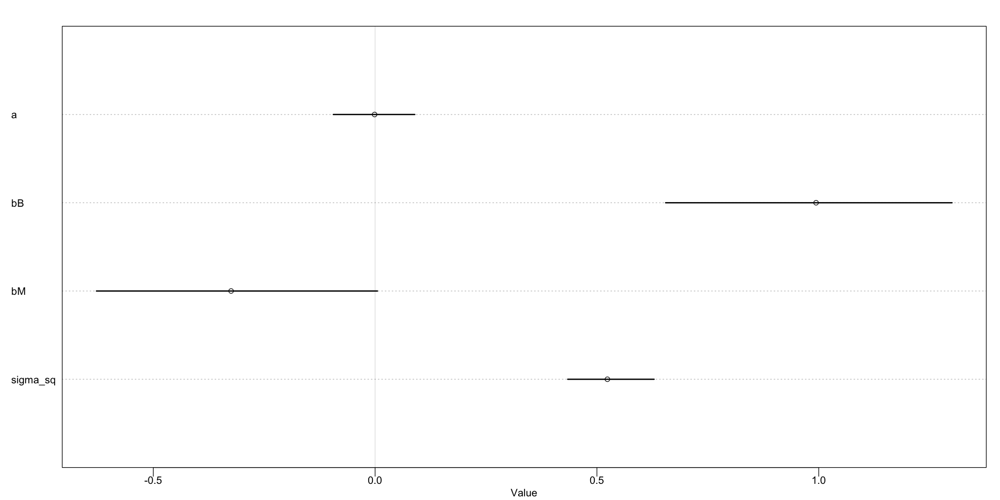

In [160]:
precis(m14m5.1)
par(bg = 'white')
plot(precis(m14m5.1, depth = 3))

So according to this model (no phylogenetic information), body mass has a negative effect on group size (probably - it does overlap zero a bit), but we are very sure in the model that the brain size has an effect on the group size.

Now let's see what happens if we use a Brownian motion model for the effect of phylogeny.

In [161]:
tree_trimmed <- keep.tip(Primates301_nex, spp_obs)
Rbm <- corBrownian(phy = tree_trimmed)
V <- vcv(Rbm)
Dmat <- cophenetic(tree_trimmed)

# putting the species in the right order
dat_list$V <- V[spp_obs, spp_obs]

# convert to correlation matrix
dat_list$R <- dat_list$V / max(V)

m14m5.2 <- ulam(
    alist(
        G ~ multi_normal(mu, SIGMA),
        mu <- a + bM * M + bB * B,
        matrix[N_spp, N_spp]: SIGMA <- R * sigma_sq,
        a ~ normal(0, 1),
        c(bM, bB) ~ normal(0, 0.5),
        sigma_sq ~ exponential(1)
    ),
    data = dat_list,
    chains = 4,
    cores = 4
)

Warning message in Initialize.corPhyl(phy, dummy.df):
“No covariate specified, species will be taken as ordered in the data frame. To avoid this message, specify a covariate containing the species names with the 'form' argument.”


Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = inf, but Covariance matrix[2,1] = inf (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eb4fae35.stan', line 27, column 4 to column 35)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 



Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = inf, but Covariance matrix[2,1] = inf (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eb4fae35.stan', line 27, column 4 to column 35)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 500 / 1000 [ 50%]

               mean        sd         5.5%     94.5%      rhat ess_bulk
a        -0.4886340 0.5631716 -1.406757200 0.4113543 1.0014305 1414.786
bB       -0.0703176 0.2534907 -0.472277045 0.3343095 1.0008372 1137.608
bM        0.3422881 0.2175190  0.005537557 0.6941979 0.9995998 1113.489
sigma_sq  2.7024264 0.3048784  2.251829750 3.2228586 1.0032376 1706.963


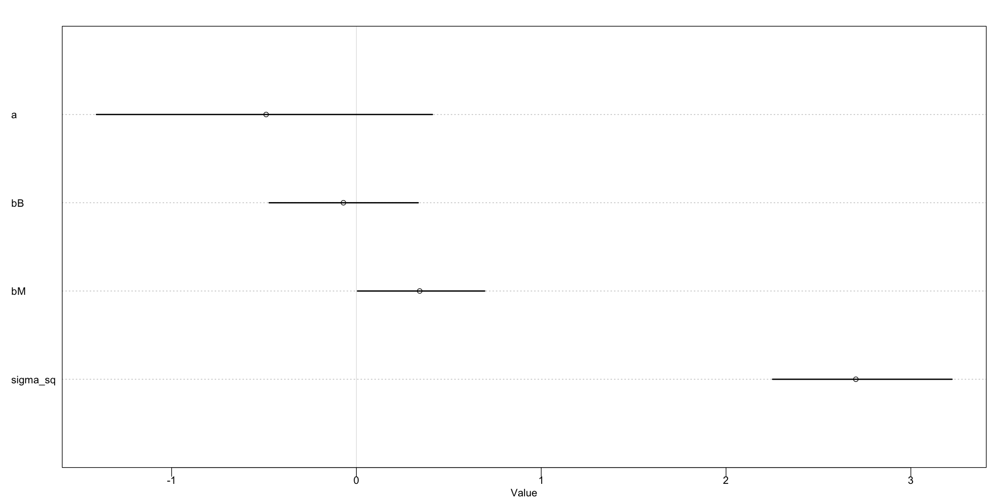

In [162]:
pre <- precis(m14m5.2)
print(pre)
par(bg = 'white')
plot(pre)

Very interesting! Now when we use a Brownian motion model, we are much less convinced. We see an effect of the mass (kind of - it's small if anything), but then we're pretty sure that there actually is now effect of the brain size on the group size, in contrast to the earlier model. Also, the sigma_sq (variance) is much higher than in the previous models, indicating that we just think there's a lot more uncertainty here.

Now let's try the [[Ornstein-Uhlenbeck Model]].

In [163]:
# add scaled and reordered distance matrix
dat_list$Dmat <- Dmat[spp_obs, spp_obs] / max(Dmat)

m14m5.3 <- ulam(
    alist(
        G ~ multi_normal(mu, SIGMA),
        mu <- a + bM * M + bB * B,
        matrix[N_spp, N_spp]: SIGMA <- cov_GPL1(Dmat, etasq, rhosq, 0.01),
        a ~ normal(0, 1),
        c(bM, bB) ~ normal(0, 0.5),
        etasq ~ half_normal(1, 0.25),
        rhosq ~ half_normal(3, 0.25)
    ),
    data = dat_list,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6cad1b84.stan', line 47, column 4 to column 35)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 



Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 
Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e6cad1b84.stan', line 47, column 4 to column 35)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 



Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 500 / 1000 [ 50%]

            mean        sd       5.5%      94.5%     rhat ess_bulk
a     -0.5154773 0.3517945 -1.0878916 0.03543221 1.001044 1833.422
bB     0.1907505 0.2573096 -0.2273488 0.59954717 1.002535 1284.625
bM     0.1791398 0.2266440 -0.1766897 0.53889482 1.002300 1283.109
etasq  0.9324909 0.1192965  0.7566146 1.13954220 1.001493 1574.290
rhosq  3.0170675 0.2463211  2.6223713 3.40400505 1.001980 1430.800


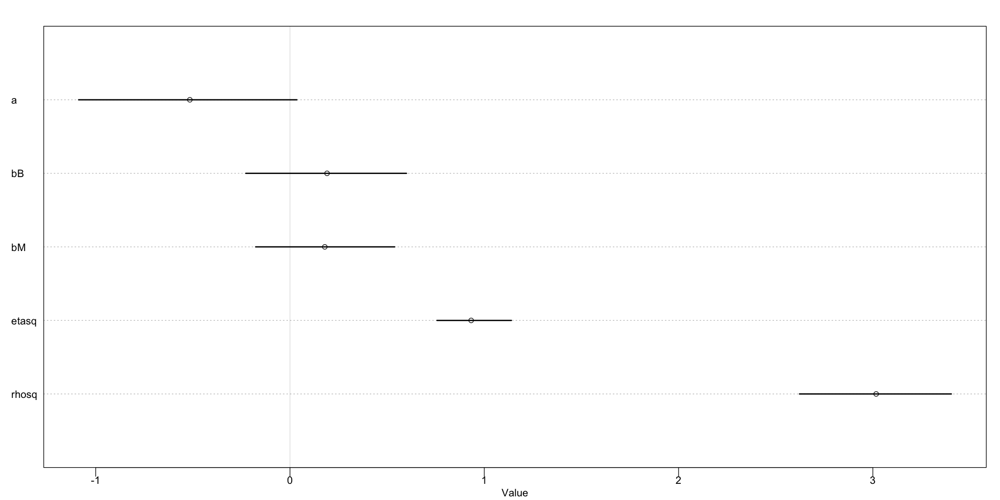

In [164]:
pre <- precis(m14m5.3, depth = 3)
print(pre)
par(bg = 'white')
plot(pre)


OK, so here again we're not convinced that the brain size influences the group size.

Now let's compare all of these!

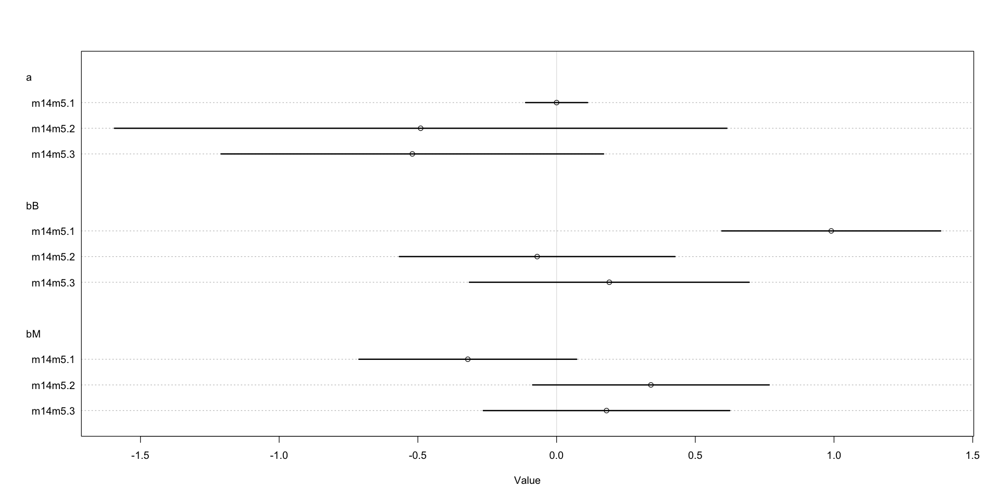

In [165]:
par(bg = 'white')
plot(coeftab(m14m5.3, m14m5.2, m14m5.1), pars = c("a", "bB", "bM"))

Basically, whenever we added in the phylogenetic information, our predictor variable for the effect of brain size on group size was close to zero, whereas without the phylogenetic information it was positive. That tells us that probably the relationship between brain size and group size is a happenstance of evolution (the same groups happened to have large group sizes and large brains) rather than it being a causal factor.

Of course, it's also biology so who knows.

**14H1** Let's revisit the Bangladesh fertility data, `data(bangladesh)`, from the practice problems for [[Chapter 13]]. Fit a model with both varying intercept by `district_id` and varying slopes of `urban` by `district_id`. You are still preicting `use.contraception` Inspect the correlation between the intercepts and slopes. Can you interpret this correlation in terms of what it tells you about the patterns of contracepting use in the sample? It might help to plot the mean (or median) varying effect estimates for both the intercept and slopes, by district. Then you can visualize the correlation and maybe more easily think through what it means to have a particular correlation. Plotting predicted propoertion of women using contraception, with urban women on one axis and rural on the other, might also help.

**Answer**

In [166]:
data(bangladesh)
d <- bangladesh

# there's an issue with the districts where one is missing for whatever reason, so we need to sort that out before we can use the district as an index variable
district_ids <- as.integer(as.factor(d$district))
d$district_id < - as.integer(as.factor(d$district))
head(d)

logical(0)

,woman,district,use.contraception,living.children,age.centered,urban
,<int>,<int>,<int>,<int>,<dbl>,<int>
1,1,1,0,4,18.4400,1
2,2,1,0,1,-5.5599,1
3,3,1,0,3,1.4400,1
4,4,1,0,4,8.4400,1
5,5,1,0,1,-13.5590,1
6,6,1,0,1,-11.5600,1


Our model here is 

$$
\begin{align*}
C &\sim \text{Binomial}(1, p) \\
\text{logit}(p_i) &= \alpha_{\text{DISTRICT}[i]} + \beta_{\text{DISTRICT}[i]} * U \\
\begin{pmatrix} \alpha \\ \beta \end{pmatrix}_{\text{DISTRICT}[i]} &\sim \text{MVNormal}\left(\begin{pmatrix} \bar{\alpha} \\ \bar{\sigma}\end{pmatrix}, \textbf{S}\right) \\
\textbf{S} &= \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} \textbf{R} \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} \\
\textbf{R} &\sim \text{LKJCorr}(2) \\
\bar{\sigma} &\sim \text{Exponential}(1) \\
\end{align*}
$$

In [167]:
bangladesh_data <- list(
    district_id = district_ids,
    C = d$use.contraception,
    U = d$urban
)

m14h1.1 <- ulam(
    alist(
        C ~ dbinom(1, p),
        logit(p) <- alpha[district_id] + beta[district_id] * U,
        c(alpha, beta)[district_id] ~ multi_normal(c(a_bar, b_bar), Rho, Sigma),
        a_bar ~ normal(0, 1),
        b_bar ~ normal(0, 1),
        Rho ~ lkj_corr(2),
        Sigma ~ exponential(1)
    ),
    chains = 4,
    cores = 4,
    data = bangladesh_data
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e7fa2dea8.stan', line 17, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e7fa2dea8.stan', line 17, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable t

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e7fa2dea8.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e7fa2dea8.stan', line 17, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e7fa2dea8.stan', line 17, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e7fa2dea8.stan', line 17, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable t

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e7fa2dea8.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e7fa2dea8.stan', line 17, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]

4 matrix parameters hidden. Use depth=3 to show them.



                 mean         sd        5.5%       94.5%      rhat  ess_bulk
beta[1]    1.06277691 0.39273298  0.44893966  1.68974510 1.0002616 1918.4930
beta[2]    0.64333304 0.68255886 -0.43409535  1.74675360 1.0029688 2575.7978
beta[3]    0.97280839 0.79565466 -0.22041576  2.27949055 1.0015528 1750.5981
beta[4]    1.64450510 0.65134462  0.68747040  2.76835870 1.0013497  913.0935
beta[5]    0.62388839 0.61286226 -0.33971949  1.59959000 1.0034682 2604.8963
beta[6]    1.32365425 0.53756265  0.50395534  2.21927390 1.0055170 1435.8456
beta[7]    0.83090563 0.70501424 -0.25576506  1.95488385 0.9996955 3398.9857
beta[8]    0.95289422 0.64119638 -0.03548506  2.01855960 1.0000147 2223.2899
beta[9]    1.04691542 0.66562159  0.03689371  2.15076915 1.0018854 2239.5167
beta[10]   1.24155458 0.75003933  0.13653250  2.49111330 1.0005489 1617.4090
beta[11]   1.66159071 0.80188811  0.46472678  3.01616705 1.0056127 1011.5938
beta[12]   0.47559773 0.59918165 -0.50127850  1.38002985 1.0078207 2710.4271

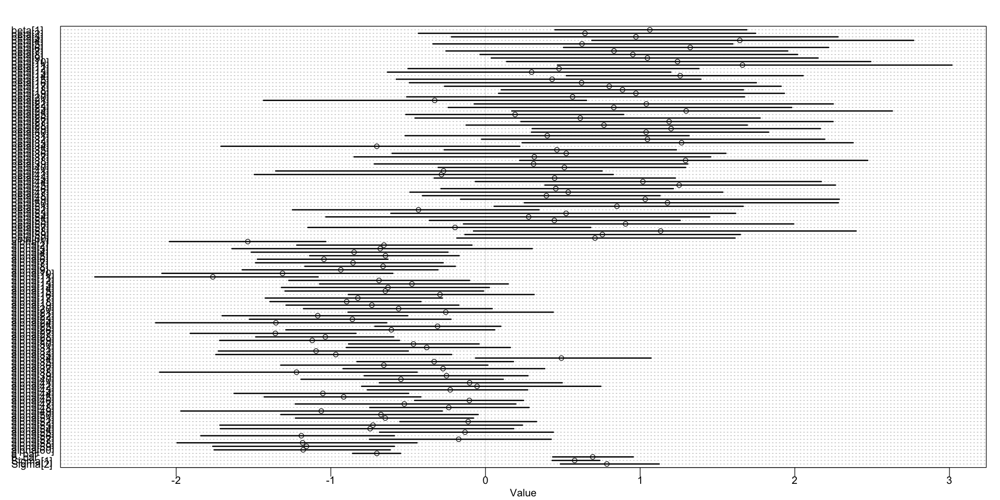

In [168]:
pre <- precis(m14h1.1, depth = 2)
print(pre)
par(bg = 'white')
plot(pre)

If we're interested in the correlation between the intercept and the slope, that's the sigma parameter

In [169]:
post <- extract.samples(m14h1.1)
sapply(post, head)

1.539460,0.6332230,0.4898280,1.247830,1.011420000,1.29891,-0.0949535,0.438298,1.158800,2.570080,⋯,0.825027,-0.027866,0.141860,1.976480,-0.202417,0.562769,0.130328,0.331756,1.0748300,0.819553
1.412600,0.6322780,1.3817200,1.303270,0.599822000,1.38368,1.8294100,-0.185547,0.375115,1.002000,⋯,0.758163,-0.731553,0.322167,-0.143360,0.580950,1.125130,-0.340083,1.590570,0.7556650,0.592539
1.379070,0.0390323,-0.0629754,1.359200,-0.000989731,1.13783,-0.2300920,1.275010,1.034720,0.544045,⋯,0.522482,-0.364260,-0.116494,1.402520,0.277349,-0.183684,-0.298171,-0.482801,-0.0624797,0.586127
1.208630,-0.2999560,0.3814880,1.338940,0.133340000,1.46267,-0.3213560,1.477170,0.318810,0.339146,⋯,1.390960,-0.450011,0.747025,-0.521822,0.148602,-0.352553,-0.305348,0.730416,-0.1155230,0.674835
0.985888,0.7479700,2.0971700,1.210060,1.156130000,1.07496,1.0072300,1.176560,0.108278,0.792037,⋯,0.509229,0.182975,-0.497671,0.996003,0.435153,0.377058,-0.804645,0.975300,0.3097220,-0.711212
0.321061,0.2241300,-0.1648870,0.846696,0.165623000,0.83225,-0.0348451,0.323003,1.031810,0.516959,⋯,0.756506,-0.406206,0.395152,0.558730,1.189710,0.240668,0.666483,0.283008,-0.1297320,1.490840
-2.06346,-0.905308,-0.0769077,-0.546111,-0.856532,-1.218790,0.0537204,-0.857679,-1.455040,-1.946760,⋯,-0.432803,-0.0116957,-0.193793,-1.279890,0.1251150,-0.475278,0.1886400,-0.716793,-1.447870,-1.512910
-1.56630,-0.538976,-0.7424980,-1.072490,-0.455302,-1.219170,-1.3588000,-0.286516,-0.362721,-1.381700,⋯,-0.600052,0.0576019,-0.446026,0.366506,-0.6301540,-1.268860,0.0827706,-1.132090,-1.029220,-0.878681
-1.98530,-0.624890,0.0444087,-0.122666,-0.707433,-0.832679,-0.9215250,-0.552525,-1.226850,-0.985372,⋯,-0.710911,-0.2149540,-0.171533,-0.861840,-0.0348292,-0.927730,-0.3829220,-1.258170,-0.944223,-1.413360
-1.60336,-0.579724,-0.6077810,-0.791864,-0.495026,-1.378370,-0.6704850,-0.432940,-0.546340,-0.683519,⋯,-0.587966,-0.1492040,-1.089180,-1.071680,-0.0938884,-1.002540,0.2918600,-0.754751,-0.539513,-0.814279
-1.67823,-0.836155,-0.4010120,-0.458963,-0.545192,-0.919308,-0.5823730,-0.129374,-0.343660,-1.412700,⋯,-0.802288,-0.3985350,0.283444,-0.642459,0.1539600,-1.000090,-0.1420740,-1.665950,-1.128800,-0.754885


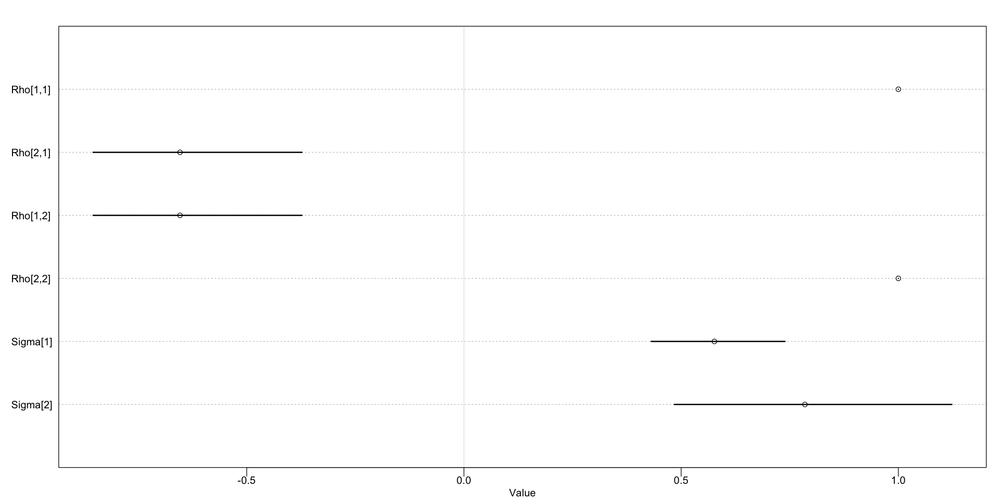

In [170]:
par(bg = 'white')
plot(precis(m14h1.1, depth = 3, pars = c("Rho", "Sigma")))

So we see a negative relationship between the intercept and the slope - that is, if there's a higher baseline use of contraception, then moving to an urban area won't make as much of a difference. I suppose that that makes sense.

NOTE: Sigma is a vector of standard deviations for the multivariate normal (So `Sigma[1]` $= \sigma_\alpha$ and `Sigma[2]`$ = \sigma_\beta$)

In [171]:
stancode(m14h1.1)

data{
    array[1934] int C;
    array[1934] int U;
    array[1934] int district_id;
}
parameters{
     vector[60] beta;
     vector[60] alpha;
     real a_bar;
     real b_bar;
     corr_matrix[2] Rho;
     vector<lower=0>[2] Sigma;
}
model{
     vector[1934] p;
    Sigma ~ exponential( 1 );
    Rho ~ lkj_corr( 2 );
    b_bar ~ normal( 0 , 1 );
    a_bar ~ normal( 0 , 1 );
    {
    array[60] vector[2] YY;
    vector[2] MU;
    MU = [ a_bar , b_bar ]';
    for ( j in 1:60 ) YY[j] = [ alpha[j] , beta[j] ]';
    YY ~ multi_normal( MU , quad_form_diag(Rho , Sigma) );
    }
    for ( i in 1:1934 ) {
        p[i] = alpha[district_id[i]] + beta[district_id[i]] * U[i];
        p[i] = inv_logit(p[i]);
    }
    C ~ binomial( 1 , p );
}



NOTE: it is extremely confusing, but the `multi_normal` above *is not* the [[Stan]] `multi_normal`. The one above is from statistical rethinking and takes three parameters, whereas the [[Stan]] one takes the regular two parameters of the matrix of means and the variance / covariance matrix.

OK, so now let's look at the different varying effects (intercept and slope).

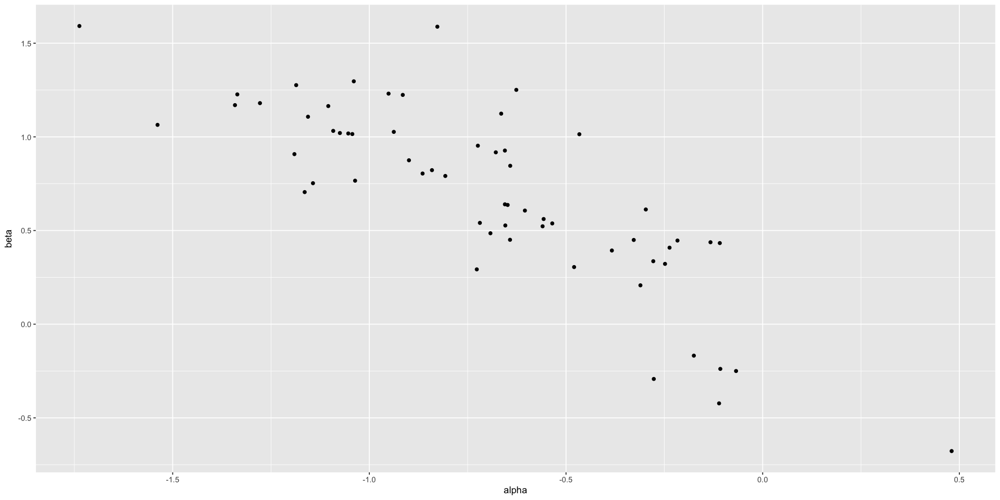

In [172]:
alpha_medians <- apply(post$alpha, 2, median)
beta_medians <- apply(post$beta, 2, median)
plot_df <- data.frame(
    alpha = alpha_medians,
    beta = beta_medians
)
ggplot(plot_df, aes(alpha, beta)) +
    geom_point()

So this is basically what we expected - if we see a higher baseline use of contraceptives ($\alpha$) then we expect a lower change moving from rural $\to$ urban.

Now let's take a look for each district and figure out the expected proportion using contraceptives in rural vs. urban settings.

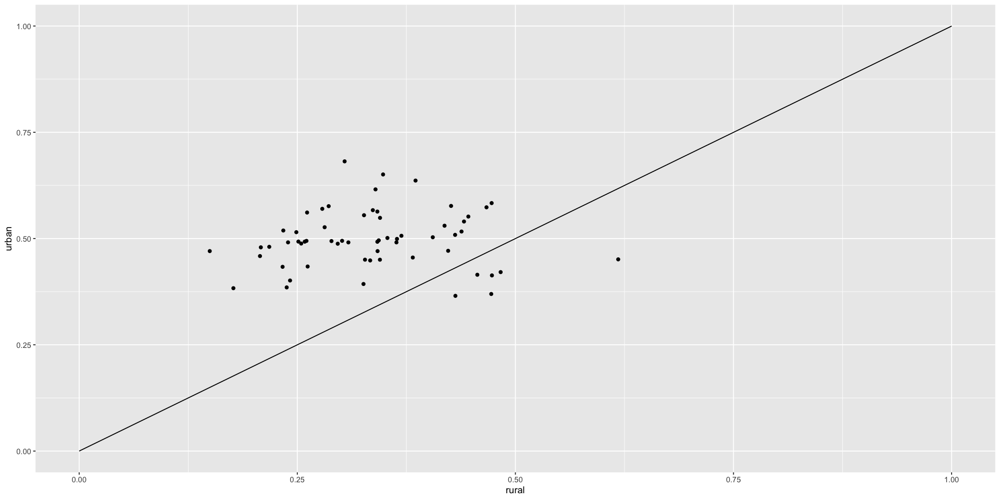

In [173]:
# first get the proportion for the rural (basically just the inverse logit of the alpha parameter)
rural_ps <- inv_logit(post$alpha)
median_rural_proportions <- apply(rural_ps, 2, median)

# now the urban ones
urban_ps <- inv_logit(post$alpha + post$beta)
median_urban_proportions <- apply(urban_ps, 2, median)

# now plot them
plot_df <- data.frame(rural = median_rural_proportions, urban = median_urban_proportions)
ggplot(plot_df, aes(rural, urban))  +
    geom_point() +
    geom_segment(data = data.frame(x = 0, y = 0, xend = 1, yend = 1), aes(x, y, xend = xend, yend = yend))

Hmmm... I'm not sure what to say about this plot. Basically, urban contraceptive use is fairly consistently higher than rural?

**14H2** Now consider the predictor variables `age.centered` and `living.children`, also contained in `data(bangladesh)`. Suppose that age influences contraceptive use (changing attitudes) and number of children (older people have had more time to have kids). Number of children may also directly influence contraceptive use. Draw a [[DAG]] that reflects these hypothetical relationships. Then build models needed to evaluate the [[DAG]]. You will need at least two models. Retain `district` and `urban`, as in 14H1. What do you conclude about the causal influence of age and children?

**Answer** First, let's draw the [[DAG]].

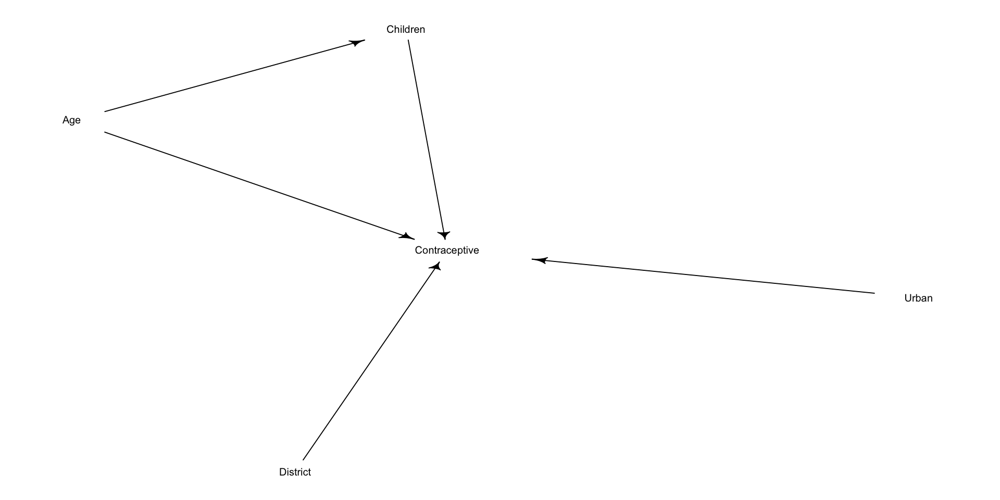

In [174]:
par(bg = 'white')
dag.14h2 <- dagitty('dag{
Age
Children
Urban
District
Contraceptive
Age -> Contraceptive
Age -> Children
Children -> Contraceptive
Urban -> Contraceptive
District -> Contraceptive
}')
drawdag(dag.14h2)

I'm going to do two models - one where we cluster the effects of age and children on district, and one where we don't.

The first model will be

$$
\begin{align*}
C &\sim \text{Binomial}(1, p) \\
\text{logit}(p_i) &= \alpha_{\text{DISTRICT}[i]} + \beta_{\text{DISTRICT}[i]} * U + \gamma * I + \delta * A\\
\begin{pmatrix} \alpha \\ \beta \end{pmatrix}_{\text{DISTRICT}[i]} &\sim \text{MVNormal}\left(\begin{pmatrix} \bar{\alpha} \\ \bar{\beta} \end{pmatrix}, \textbf{S}\right) \\
\textbf{S} &= \begin{pmatrix}
\sigma_\alpha & 0 \\ 
0 & \sigma_\beta \\
\end{pmatrix} 
\textbf{R}
\begin{pmatrix}
\sigma_\alpha & 0 \\ 
0 & \sigma_\beta \\
\end{pmatrix} \\
\textbf{R} &\sim \text{LKJCorr}(2) \\
\bar\alpha, \bar\beta, &\sim \text{Normal}(0, 1) \\
\gamma, \delta &\sim \text{Normal}(0, 1) \\
\sigma_\alpha, \sigma_\beta, &\sim \text{Exponential}(1) \\
\end{align*}
$$

Where
- $C$ - contraceptive use
- $U$ - urban or not
- $I$ - number of children
- $A$ - age

In [175]:
bangladesh_data <- list(
    district_id = district_ids,
    C = d$use.contraception,
    U = d$urban,
    I = d$living.children,
    A = d$age.centered
)

m14h2.1 <- ulam(
    alist(
        C ~ dbinom(1, p),
        logit(p) <- alpha[district_id] + beta[district_id] * U + gamma * I + delta * A,
        c(alpha, beta)[district_id] ~ multi_normal(c(a_bar, b_bar), Rho, Sigma),
        c(gamma, delta) ~ normal(0, 1),
        c(a_bar, b_bar, g_bar, d_bar) ~ normal(0, 1),
        Rho ~ lkj_corr(2),
        Sigma ~ exponential(1)
    ),
    chains = 4,
    cores = 4,
    data = bangladesh_data
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...



Chain 1 Rejecting initial value:

Chain 1   Log probability evaluates to log(0), i.e. negative infinity.

Chain 1   Stan can't start sampling from this initial value.



Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66ccb15d.stan', line 23, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66ccb15d.stan', line 23, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable t

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66ccb15d.stan', line 23, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66ccb15d.stan', line 23, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66ccb15d.stan', line 23, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable t

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66ccb15d.stan', line 23, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e66ccb15d.stan', line 23, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 500 / 1000 [ 50%]

                mean        sd      5.5%       94.5%      rhat  ess_bulk
alpha[1]  -2.8092501 0.3596762 -3.388715 -2.24131425 1.0043873  842.7482
alpha[2]  -1.8381560 0.3983230 -2.506244 -1.23990670 1.0031754 1435.4807
alpha[3]  -1.7613622 0.6352212 -2.766556 -0.75768787 1.0000027 1867.8797
alpha[4]  -2.0385827 0.4503120 -2.770976 -1.32833560 1.0015353  947.8705
alpha[5]  -1.8261124 0.3460247 -2.394788 -1.30070680 1.0013645  965.3130
alpha[6]  -2.1965815 0.3176393 -2.705350 -1.70956000 1.0043520  813.6473
alpha[7]  -2.0103698 0.4462909 -2.722686 -1.32293425 1.0040136 1078.8990
alpha[8]  -1.7556795 0.3457120 -2.330072 -1.21089230 1.0037310  970.8890
alpha[9]  -2.1624005 0.4084593 -2.815652 -1.52481415 1.0015650 1134.8081
alpha[10] -2.3983321 0.5073793 -3.265668 -1.65989865 1.0010739 1389.4513
alpha[11] -2.8167006 0.5157782 -3.655416 -2.05134270 1.0019751 1125.3982
alpha[12] -1.8703332 0.3888145 -2.505830 -1.27725835 1.0029512 1134.3352
alpha[13] -1.5997386 0.4318052 -2.286735 -0.9268902

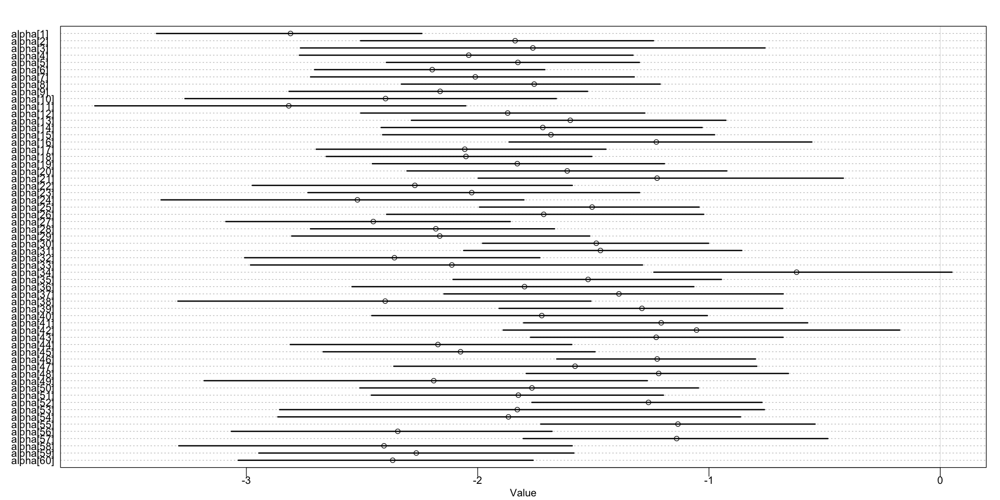

            mean          sd       5.5%       94.5%     rhat ess_bulk
gamma  0.4093863 0.053816200  0.3235441  0.49878054 1.012646 327.8554
delta -0.0291788 0.007415138 -0.0408105 -0.01719314 1.004389 617.1882


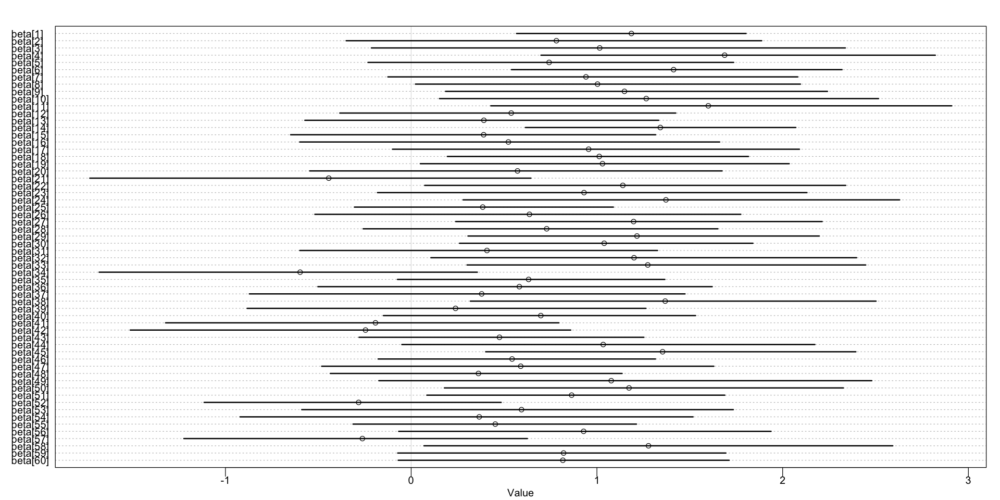

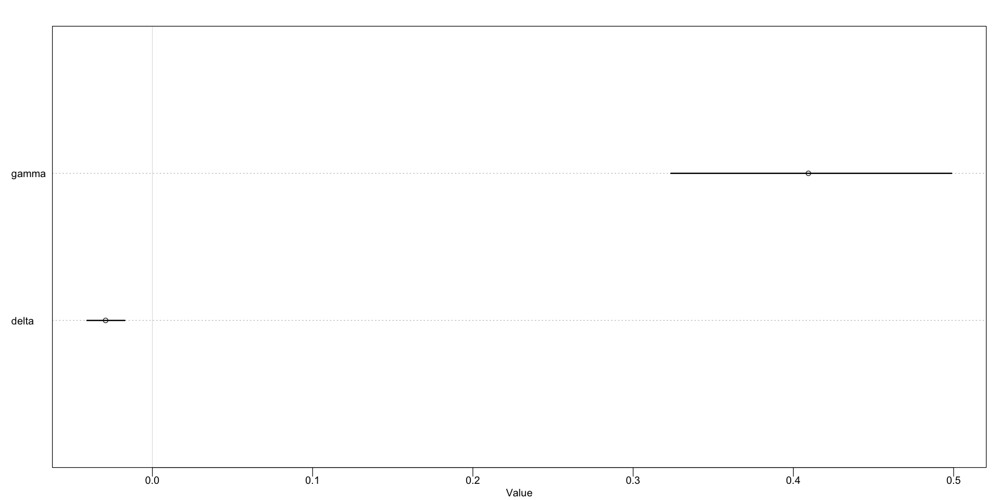

In [176]:
par(bg = 'white')
for (var in list("alpha", "beta", c("gamma", "delta"))) {
    pre <- precis(m14h2.1, depth = 3, pars = var)
    print(pre)
    plot(pre)
}

So when we don't cluster these new variables, we are under the impression that having surviving children is positively correlated with a higher use of contraceptives, while being older is *negatively* correlated. This tells us that people with more children are generally more likely to use contraceptives, while older people are generally *less* likely to.


The next model will cluster those new ones by district:

$$
\begin{align*}
C &\sim \text{Binomial}(1, p) \\
\text{logit}(p_i) &= \alpha_{\text{DISTRICT}[i]} + \beta_{\text{DISTRICT}[i]} * U + \gamma_{\text{DISTRICT}[i]} * I + \delta_{\text{DISTRICT}[i]} * A\\
\begin{pmatrix} \alpha \\ \beta \\ \gamma \\ \delta \end{pmatrix}_{\text{DISTRICT}[i]} &\sim \text{MVNormal}\left(\begin{pmatrix} \bar{\alpha} \\ \bar{\beta} \\ \bar{\gamma} \\ \bar{\delta} \end{pmatrix}, \textbf{S}\right) \\
\textbf{S} &= \begin{pmatrix}
\sigma_\alpha & 0 & 0 & 0 \\ 
0 & \sigma_\beta & 0 & 0 \\
0 & 0 & \sigma_\gamma & 0 \\
0 & 0 & 0 & \sigma_\delta \\
\end{pmatrix} 
\textbf{R} 
\begin{pmatrix}
\sigma_\alpha & 0 & 0 & 0 \\ 
0 & \sigma_\beta & 0 & 0 \\
0 & 0 & \sigma_\gamma & 0 \\
0 & 0 & 0 & \sigma_\delta \\
\end{pmatrix} \\
\textbf{R} &\sim \text{LKJCorr}(2) \\
\bar\alpha, \bar\beta, \bar\gamma, \bar\delta &\sim \text{Normal}(0, 1) \\
\sigma_\alpha, \sigma_\beta, \sigma_\gamma, \sigma_\delta &\sim \text{Exponential}(1) \\
\end{align*}
$$

Where
- $C$ - contraceptive use
- $U$ - urban or not
- $I$ - number of children
- $A$ - age

In [177]:
m14h2.2 <- ulam(
    alist(
        C ~ dbinom(1, p),
        logit(p) <- alpha[district_id] + beta[district_id] * U + gamma[district_id] * I + delta[district_id] * A,
        c(alpha, beta, gamma, delta)[district_id] ~ multi_normal(c(a_bar, b_bar, g_bar, d_bar), Rho, Sigma),
        c(a_bar, b_bar, g_bar, d_bar) ~ normal(0, 1),
        Rho ~ lkj_corr(2),
        Sigma ~ exponential(1)
    ),
    chains = 4,
    cores = 4,
    data = bangladesh_data
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...



Chain 1 Rejecting initial value:

Chain 1   Log probability evaluates to log(0), i.e. negative infinity.

Chain 1   Stan can't start sampling from this initial value.



Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e238322f9.stan', line 23, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e238322f9.stan', line 23, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable t

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e238322f9.stan', line 23, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e238322f9.stan', line 23, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e238322f9.stan', line 23, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e238322f9.stan', line 23, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable t

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e238322f9.stan', line 23, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e238322f9.stan', line 23, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 1 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]

See https://mc-stan.org/misc/warnings for details.


See https://mc-stan.org/misc/warnings for details.




                mean        sd      5.5%      94.5%     rhat  ess_bulk
alpha[1]  -2.6816422 0.4664854 -3.437036 -1.9502472 1.032484  196.2531
alpha[2]  -1.8841159 0.4835631 -2.649705 -1.1270114 1.007899  418.7344
alpha[3]  -1.7969742 0.6761748 -2.881890 -0.7478787 1.007612  658.7356
alpha[4]  -2.1428125 0.5158786 -2.960748 -1.3596491 1.006761  353.8951
alpha[5]  -1.8115746 0.4055277 -2.430682 -1.1620088 1.002767  581.5734
alpha[6]  -2.2131174 0.3871979 -2.850319 -1.6088002 1.011802  517.9895
alpha[7]  -1.9760965 0.4734451 -2.757868 -1.2443865 1.003740  652.3806
alpha[8]  -1.8513527 0.4161639 -2.538430 -1.2469333 1.008947  373.9472
alpha[9]  -2.1853627 0.4997877 -2.991470 -1.4341291 1.012224  358.1817
alpha[10] -2.3458107 0.5644036 -3.289618 -1.5175835 1.003985  892.4626
alpha[11] -2.7941925 0.5578649 -3.718541 -1.9520656 1.007181  413.8925
alpha[12] -1.7353801 0.4674171 -2.432823 -0.9664138 1.008215  370.5978
alpha[13] -1.6776691 0.4574413 -2.443087 -0.9739829 1.003141  658.1235
alpha[

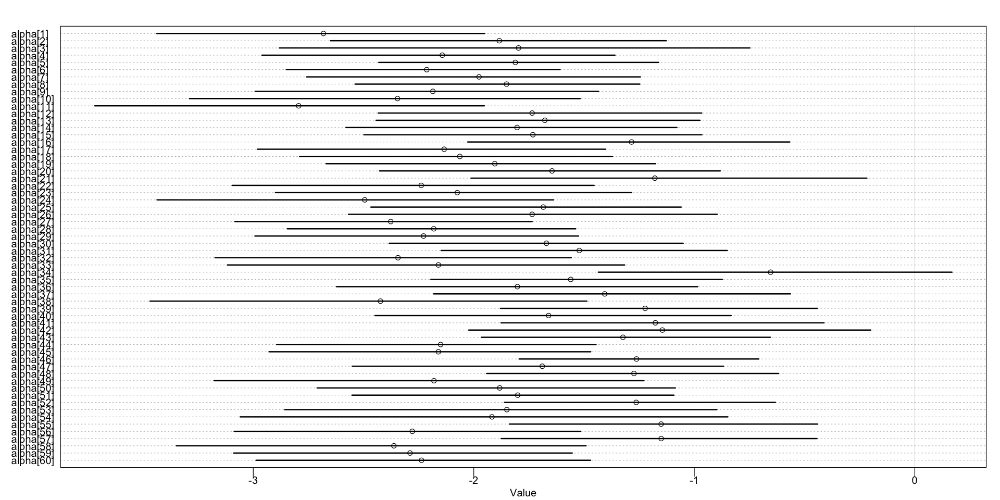

               mean         sd      5.5%     94.5%     rhat  ess_bulk
gamma[1]  0.3730778 0.10400252 0.1944497 0.5236743 1.039977 117.74746
gamma[2]  0.4289743 0.10814387 0.2652418 0.6022287 1.010769 309.00446
gamma[3]  0.4319458 0.10997996 0.2593604 0.6051033 1.014683 297.29411
gamma[4]  0.4559474 0.11456538 0.2917349 0.6475371 1.012981 199.70042
gamma[5]  0.4039031 0.09715344 0.2358339 0.5511826 1.013341 300.54722
gamma[6]  0.4146918 0.09952752 0.2594692 0.5726248 1.024123 225.18335
gamma[7]  0.3920933 0.10844430 0.2087696 0.5530933 1.008723 303.94304
gamma[8]  0.4552745 0.11208762 0.2961653 0.6459656 1.020439 182.67209
gamma[9]  0.4112355 0.10545972 0.2470337 0.5739761 1.015507 297.66399
gamma[10] 0.3978908 0.11496968 0.1984664 0.5697711 1.014431 311.49081
gamma[11] 0.4095775 0.12572465 0.2133296 0.6076956 1.015921 268.32981
gamma[12] 0.3614626 0.11124899 0.1546835 0.5045341 1.021334 211.06479
gamma[13] 0.4349291 0.10114274 0.2851068 0.6090542 1.010628 261.73254
gamma[14] 0.4433075 

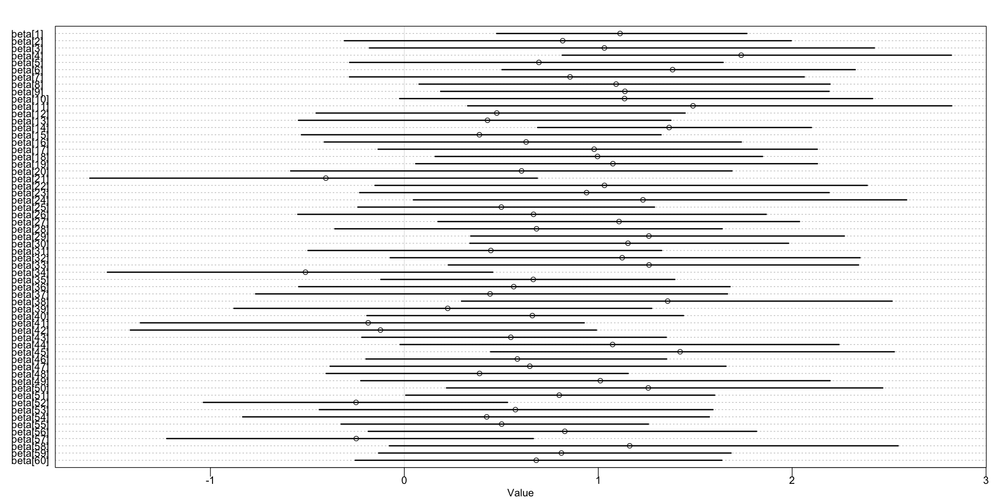

                 mean         sd        5.5%         94.5%     rhat  ess_bulk
delta[1]  -0.03957733 0.01820885 -0.07126714 -0.0130235855 1.045221 153.66251
delta[2]  -0.02809156 0.01835564 -0.05438876  0.0019813010 1.039478 404.48563
delta[3]  -0.03091710 0.01912311 -0.05997653  0.0008597255 1.035893 651.18488
delta[4]  -0.02990916 0.01717564 -0.05767451 -0.0032529286 1.031628 612.99004
delta[5]  -0.03546956 0.01627647 -0.06349842 -0.0111828315 1.040010 302.22612
delta[6]  -0.03678571 0.01617948 -0.06425418 -0.0136461605 1.034108 237.12572
delta[7]  -0.03302279 0.01800364 -0.06191766 -0.0062100275 1.040415 576.45126
delta[8]  -0.02380490 0.01778732 -0.04672039  0.0089011902 1.015864 283.28180
delta[9]  -0.03332451 0.01707544 -0.06164754 -0.0076979317 1.029338 376.23012
delta[10] -0.03656099 0.02018264 -0.07165802 -0.0085807576 1.042008 251.88025
delta[11] -0.03586672 0.01962702 -0.06891033 -0.0062379997 1.048244 469.73112
delta[12] -0.03043736 0.01703004 -0.05607667 -0.0017402872 1.035

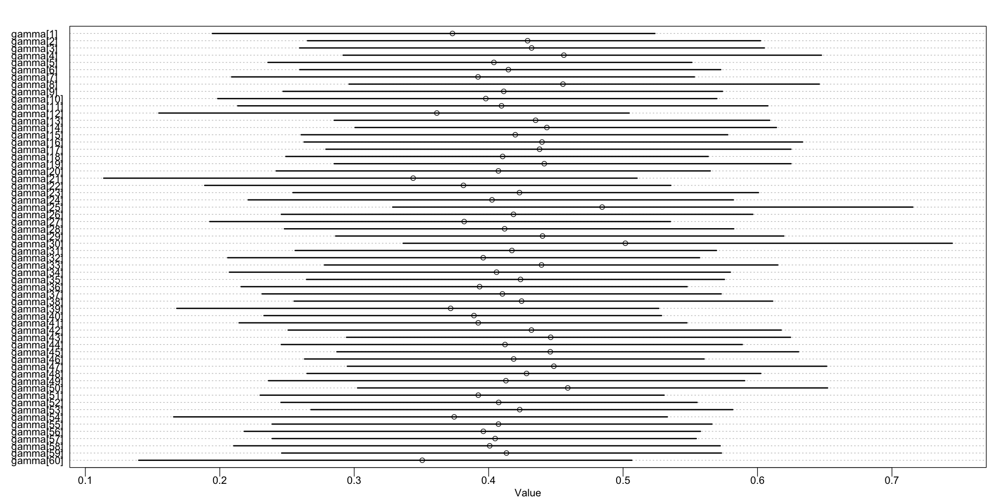

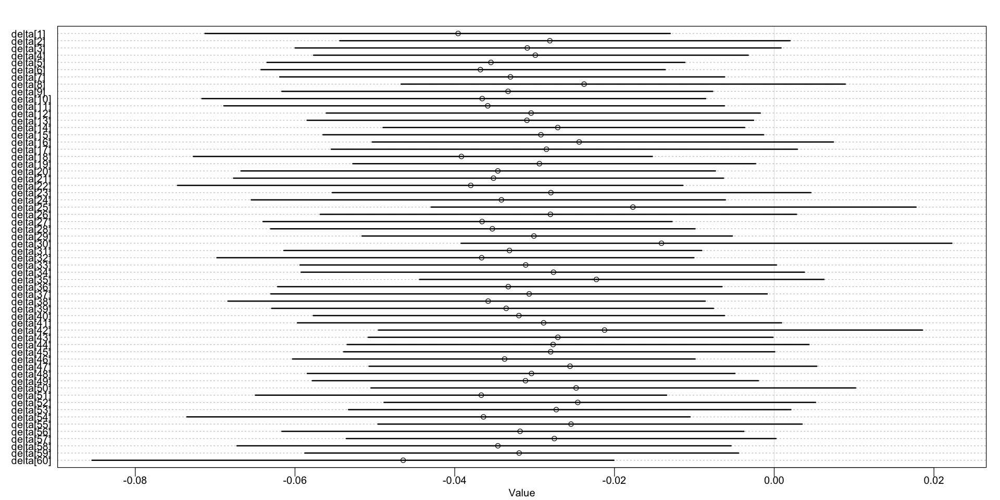

In [178]:
par(bg = 'white')
for (relevant_var in c("alpha", "beta", "gamma", "delta")) {
    pre <- precis(m14h2.2, depth = 3, pars = relevant_var)
    print(pre)
    plot(pre)
}

Admittedly, this is a crude model and I'm not super confident that I've specified it correctly. Given the number of divergent transitions I should probably use a non-centred model, but I'm finding that very difficult. Probably I should look into actually doing this.

Regardless, from this it seems that children fairly reliably have a positive impact on contraceptive use (the more children you have the more likely you are to use contraception). On the other hand, age seems to almost always have a *negative* affect - that is, the older you are the *less* likely you are to use contraception (even accounting for the effect of children). My almost completely uneducated guess would be that this is related to changing attitudes, but what do I know. Also, I'm a little surprised since I would have expected that there would be a positive effect simply based on the fact that once you're past childbearing age you are probably not taking contraception...

**14H3** Modify any models from 14H2 that contained that children variable and model the variable now as a monotonic ordered category, like education from the week we did ordered categories. Education in that example had 8 categories. Children here will have fewer, since no one in the sample had 8 children. So modify the code appropriately. What do you conclude about the causal influence of each additional child on use of contraception?

**Answer** First, let's get an idea of how many children people have:

In [179]:
min(d$living.children)
max(d$living.children)

[1] 1

[1] 4

First we'll change the model where we don't cluster the effect of children

$$
\begin{align*}
C &\sim \text{Binomial}(1, p) \\
\text{logit}(p_i) &= \alpha_{\text{DISTRICT}[i]} + \beta_{\text{DISTRICT}[i]} * U + \gamma * \sum_{j = 1}^I \epsilon_j + \delta * A\\
\begin{pmatrix} \alpha \\ \beta \end{pmatrix}_{\text{DISTRICT}[i]} &\sim \text{MVNormal}\left(\begin{pmatrix} \bar{\alpha} \\ \bar{\beta} \end{pmatrix}, \textbf{S}\right) \\
\textbf{S} &= \begin{pmatrix}
\sigma_\alpha & 0 \\ 
0 & \sigma_\beta \\
\end{pmatrix} 
\textbf{R}
\begin{pmatrix}
\sigma_\alpha & 0 \\ 
0 & \sigma_\beta \\
\end{pmatrix} \\
\textbf{R} &\sim \text{LKJCorr}(2) \\
\bar\alpha, \bar\beta, &\sim \text{Normal}(0, 1) \\
\gamma, \delta &\sim \text{Normal}(0, 1) \\
\sigma_\alpha, \sigma_\beta, &\sim \text{Exponential}(1) \\
\epsilon &\sim \text{Dirichlet}(2)
\end{align*}
$$

Where
- $C$ - contraceptive use
- $U$ - urban or not
- $I$ - number of children
- $A$ - age

In [180]:
bangladesh_data$dirichlet_prior <- c(2, 2, 2)
bangladesh_data$I <- as.integer(bangladesh_data$I)
sapply(bangladesh_data, head)
m14h3.1 <- ulam(
    alist(
        C ~ dbinom(1, p),
        logit(p) <- alpha[district_id] + beta[district_id] * U + gamma * sum(epsilon_j[1:I]) + delta * A,
        c(alpha, beta)[district_id] ~ multi_normal(c(a_bar, b_bar), Rho, Sigma),
        c(gamma, delta) ~ normal(0, 1),
        c(a_bar, b_bar) ~ normal(0, 1),
        Rho ~ lkj_corr(2),
        Sigma ~ exponential(1),
        vector[4]: epsilon_j <<- append_row(0, epsilon),
        simplex[3]: epsilon ~ dirichlet(dirichlet_prior)
    ),
    chains = 4,
    cores = 4,
    data = bangladesh_data
)

$district_id
[1] 1 1 1 1 1 1

$C
[1] 0 0 0 0 0 0

$U
[1] 1 1 1 1 1 1

$I
[1] 4 1 3 4 1 1

$A
[1]  18.4400  -5.5599   1.4400   8.4400 -13.5590 -11.5600

$dirichlet_prior
[1] 2 2 2

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eeba58da.stan', line 26, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eeba58da.stan', line 26, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eeba58da.stan', line 26, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eeba58da.stan', line 26, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eeba58da.stan', line 26, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eeba58da.stan', line 26, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eeba58da.stan', line 26, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450eeba58da.stan', line 26, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable typ

Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 300 / 1000 [ 30

                  mean          sd        5.5%       94.5%      rhat  ess_bulk
beta[1]     1.10891254 0.398095949  0.50321428  1.76903730 1.0007441 1458.0222
beta[2]     0.78902674 0.720062285 -0.35198479  1.91719700 1.0019087 2445.7387
beta[3]     1.03439842 0.803346487 -0.16317327  2.29896180 0.9999085 2194.6893
beta[4]     1.65605206 0.648850901  0.69470388  2.75126645 0.9996217  953.3613
beta[5]     0.71375174 0.622133873 -0.30964877  1.67646275 1.0012216 2292.3196
beta[6]     1.42290877 0.569790138  0.58005483  2.38914000 1.0012296 1591.6837
beta[7]     0.90085278 0.711273712 -0.20645986  2.06294880 1.0013377 1787.0328
beta[8]     1.04403065 0.648934709  0.02728262  2.11964620 1.0027289 1487.6464
beta[9]     1.15473804 0.671382289  0.14876130  2.24498740 1.0013274 1876.7389
beta[10]    1.20002891 0.793253360  0.02266755  2.53854285 1.0015865 1594.3613
beta[11]    1.57635846 0.801390372  0.34167599  2.92401120 1.0003495 1219.5989
beta[12]    0.53858770 0.606088781 -0.43491978  1.45

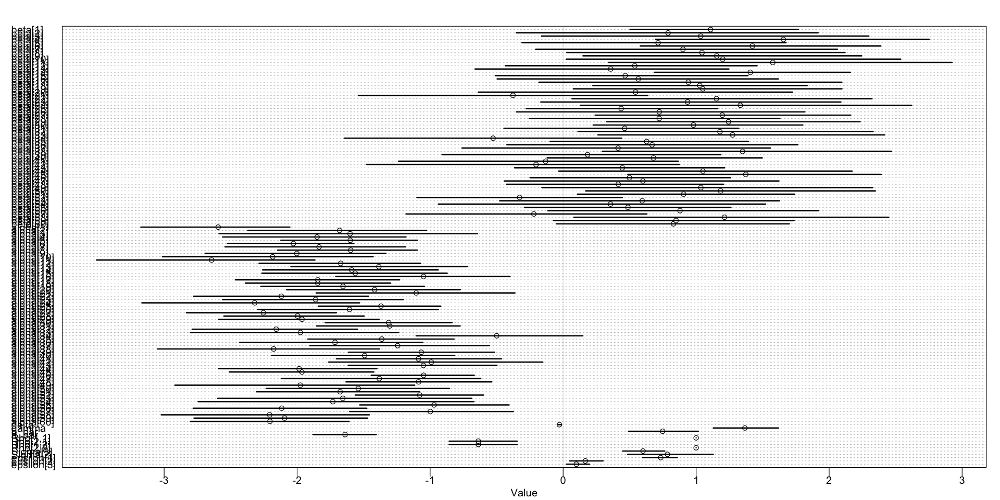

In [181]:
par(bg = 'white')
pre <- precis(m14h3.1, depth = 3)
print(pre)
plot(pre)

                 mean         sd       5.5%     94.5%     rhat  ess_bulk
epsilon[1] 0.73400132 0.08145736 0.59682458 0.8585001 1.002208 2664.7364
epsilon[2] 0.16660613 0.07918355 0.04905287 0.3000538 1.002462 2374.3245
epsilon[3] 0.09939256 0.05567841 0.02427896 0.1988424 1.000380 3055.1037
gamma      1.36612395 0.15546128 1.12885865 1.6198058 1.002070  612.4354


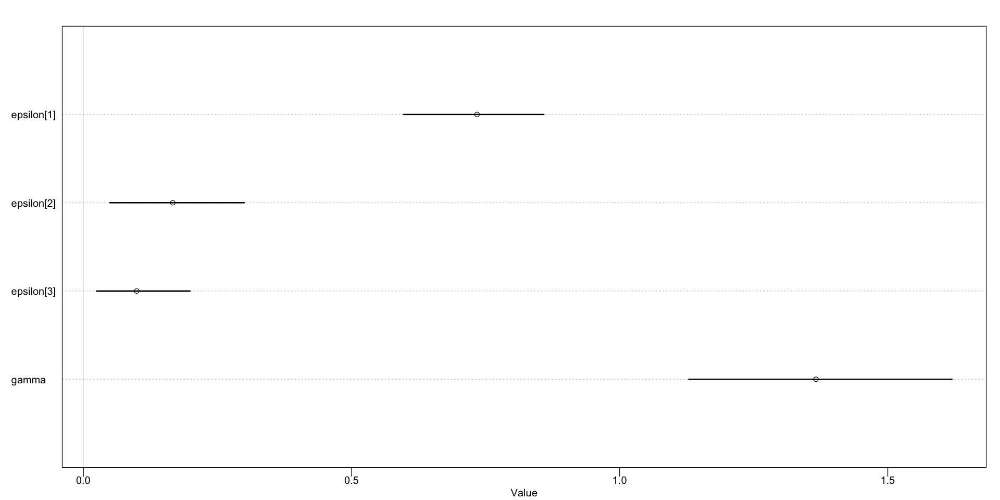

In [182]:
par(bg = 'white')
pre <- precis(m14h3.1, depth = 3, pars = c("epsilon", "gamma"))
print(pre)
plot(pre)

So from this we see that having a larger number of children increases the chances that you use contraception, but it looks there's some diminishing returns (that is, the effect of the third child, `epsilon[2]`, is less than the first, `epsilon[1]`).

Let's see if we get the same effect with the clustered model.

In [183]:
m14h3.2 <- ulam(
    alist(
        C ~ dbinom(1, p),
        logit(p) <- alpha[district_id] + beta[district_id] * U + gamma[district_id] * sum(epsilon_j[1:I]) + delta[district_id] * A,
        c(alpha, beta, gamma, delta)[district_id] ~ multi_normal(c(a_bar, b_bar, g_bar, d_bar), Rho, Sigma),
        c(a_bar, b_bar, g_bar, d_bar) ~ normal(0, 1),
        Rho ~ lkj_corr(2),
        Sigma ~ exponential(1),
        vector[4]: epsilon_j <<- append_row(0, epsilon),
        simplex[3]: epsilon ~ dirichlet(dirichlet_prior)
    ),
    chains = 4,
    cores = 4,
    data = bangladesh_data
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...



Chain 1 Rejecting initial value:

Chain 1   Log probability evaluates to log(0), i.e. negative infinity.

Chain 1   Stan can't start sampling from this initial value.

Chain 1 Rejecting initial value:

Chain 1   Log probability evaluates to log(0), i.e. negative infinity.

Chain 1   Stan can't start sampling from this initial value.



Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e34eb3320.stan', line 28, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e34eb3320.stan', line 28, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable t

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e34eb3320.stan', line 28, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 

Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e34eb3320.stan', line 28, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable t

Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e34eb3320.stan', line 28, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e34eb3320.stan', line 28, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable t

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e34eb3320.stan', line 28, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e34eb3320.stan', line 28, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 3 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 3 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 1 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 600 / 1000 [ 60%]

See https://mc-stan.org/misc/warnings for details.


See https://mc-stan.org/misc/warnings for details.


See https://mc-stan.org/misc/warnings for details.




                  mean          sd         5.5%         94.5%      rhat
delta[1]   -0.03492483 0.015995241 -0.063647652 -1.201583e-02 1.0237887
delta[2]   -0.02730103 0.017627101 -0.054804885  1.786169e-03 1.0285865
delta[3]   -0.02991019 0.017502705 -0.057876218 -3.749505e-03 1.0189979
delta[4]   -0.02954340 0.017460627 -0.058064221 -1.958024e-03 1.0282365
delta[5]   -0.03398128 0.015945921 -0.061615158 -1.119891e-02 1.0327425
delta[6]   -0.03447027 0.015952806 -0.063266552 -1.189022e-02 1.0342072
delta[7]   -0.03051218 0.016643623 -0.057876112 -6.194886e-03 1.0332757
delta[8]   -0.02410843 0.016231669 -0.047887452  2.463369e-03 1.0223385
delta[9]   -0.03069097 0.016073982 -0.057140039 -6.365951e-03 1.0259864
delta[10]  -0.03339472 0.016993860 -0.062521110 -9.087011e-03 1.0293781
delta[11]  -0.03258583 0.018921604 -0.062918710 -4.724265e-03 1.0412994
delta[12]  -0.02710939 0.016210875 -0.051562213 -4.133757e-04 1.0237836
delta[13]  -0.02913272 0.016629587 -0.055346322 -4.381896e-03 1.

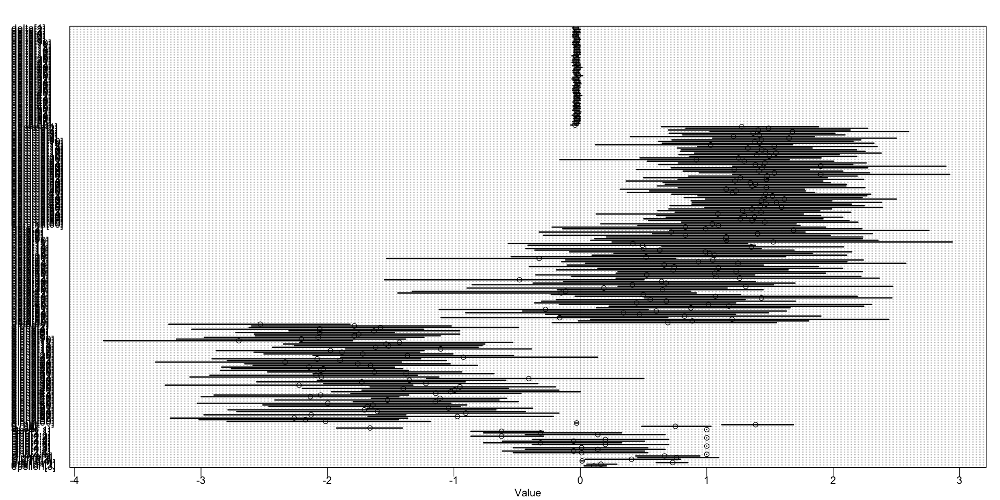

In [184]:
par(bg = 'white')
pre <- precis(m14h3.2, depth = 3)
print(pre)
plot(pre)

                mean         sd        5.5%     94.5%     rhat   ess_bulk
epsilon[1] 0.7307499 0.07784944  0.59960379 0.8498456 1.003412 1141.98975
epsilon[2] 0.1627039 0.07320158  0.05136665 0.2884225 1.001539 1302.38109
epsilon[3] 0.1065462 0.05567417  0.02956892 0.2052433 1.002964 2201.54697
gamma[1]   1.2767284 0.38973519  0.64174514 1.8831036 1.019030  249.66966
gamma[2]   1.4897445 0.45871541  0.83520146 2.2720383 1.037462  294.27817
gamma[3]   1.4076282 0.47329742  0.69685741 2.1342526 1.026632  834.45255
gamma[4]   1.6770633 0.52065846  1.02655100 2.5962176 1.033806  164.60784
gamma[5]   1.3668880 0.40252306  0.70212102 2.0144749 1.019652  735.37457
gamma[6]   1.4151134 0.39847885  0.81023982 2.0931713 1.021476  547.77273
gamma[7]   1.2111745 0.47728279  0.39621489 1.8527780 1.020733  258.86125
gamma[8]   1.6507954 0.46598550  1.04637890 2.4996836 1.026328  193.69856
gamma[9]   1.4328213 0.46210547  0.72484074 2.2185278 1.040663  553.18730
gamma[10]  1.3807449 0.49387414  0.620

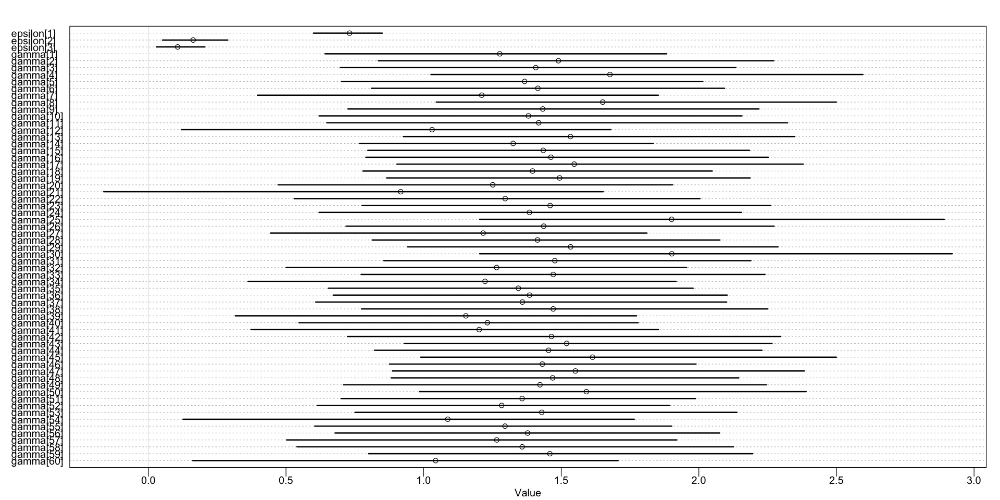

In [185]:
par(bg = 'white')
pre <- precis(m14h3.2, depth = 3, pars = c("epsilon", "gamma"))
print(pre)
plot(pre)

This is a bit messier than the previous one, but in general we reach the same conclusion - children overall positively affect contraceptive use, but there are diminishing returns (each child affects the probability less than the one before it).

**14H4** Varying effects models are useful for modelling time series, as well as spatial clustering. In a time series, the observations cluster by entities that have continuity through time, such as individuals. Since observations within individuals are likely highly correlated, the multilevel structure can help quote a lot. You'll use the data in `data(Oxboys)`, which is 234 height measurements on 26 boys from an Oxford Boys Club (I think these were like youth athletic leagues), at 9 different ages (centred and standardized) per boy. You'll be interested in predicting `height`, using `age`, clustered by `Subject` (individual boy). Fit a model with varying intercepts and slopes (on age), clustered by Subject. Present and interpret the parameter estimates. Which varying effect contributes more variation to the heights, the intercept or the slope?

**Answer**

In [186]:
data(Oxboys)
d <- Oxboys
head(d)

,Subject,age,height,Occasion
,<int>,<dbl>,<dbl>,<int>
1,1,-1.0000,140.5,1
2,1,-0.7479,143.4,2
3,1,-0.4630,144.8,3
4,1,-0.1643,147.1,4
5,1,-0.0027,147.7,5
6,1,0.2466,150.2,6


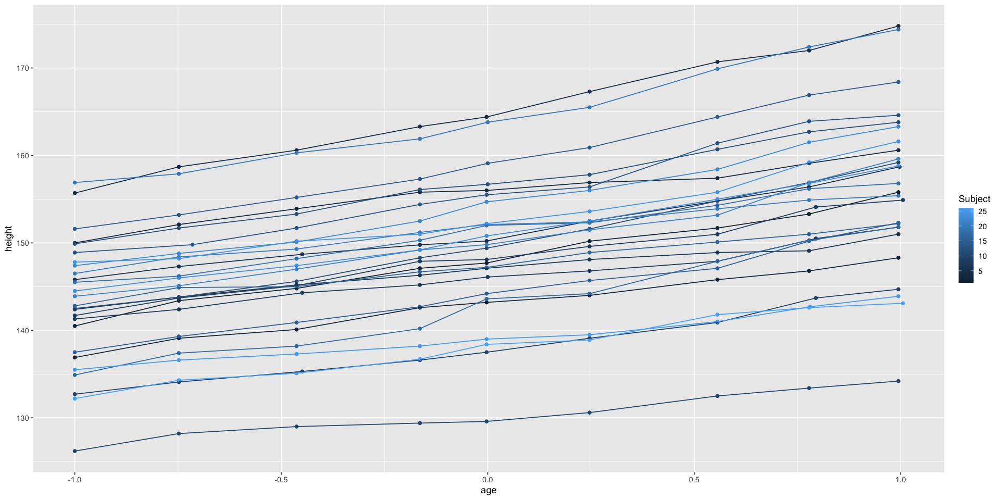

In [187]:
ggplot(d, aes(age, height, group = Subject, colour = Subject)) +
    geom_point() +
    geom_line()

So our model will look something like

$$
\begin{align*}
H_i &\sim \text{Normal}(\mu_i, \sigma_i) \\
\mu_i &= \alpha_{\text{SUBJECT}[i]} + \beta_{\text{SUBJECT}[i]} * A_i \\
\begin{pmatrix} \alpha \\ \beta \end{pmatrix}_{\text{SUBJECT[i]}} &\sim \text{MVNormal}\left(\begin{pmatrix} \bar\alpha \\ \bar\beta \end{pmatrix}, \textbf{S} \right) \\
\textbf{S} &= \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} \textbf{R} \begin{pmatrix} \sigma_\alpha & 0 \\ 0 & \sigma_\beta \end{pmatrix} \\
\textbf{R} &\sim \text{LKJCorr}(2) \\
\bar\alpha &\sim \text{Normal}(150, 10) \\
\bar\beta &\sim \text{Normal}(0, 1) \\
\sigma, \sigma_\alpha, \sigma_\beta &\sim \text{Exponential}(1)
\end{align*}
$$

- $H$ is the height
- $A$ is the age (normalized)

In [188]:
oxboys_data <- list(
    subject = d$Subject,
    A = d$age,
    H = d$height
)

m14h4 <- ulam(
    alist(
        H ~ normal(mu, sigma),
        mu <- a[subject] + b[subject] * A,
        c(a, b)[subject] ~ multi_normal(c(a_bar, b_bar), Rho, Sigma),
        Rho ~ lkj_corr(2),
        Sigma ~ exponential(1),
        a_bar ~ normal(150, 10),
        b_bar ~ normal(0, 1),
        sigma ~ exponential(1)
    ),
    data = oxboys_data,
    chains = 4,
    cores = 4
)

Running MCMC with 4 parallel chains, with 1 thread(s) per chain...

Chain 1 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e77a1a843.stan', line 21, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 1 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 1 

Chain 1 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 1 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e77a1a843.stan', line 21, column 4 to column 24)

Chain 1 If this warning occurs sporadically, such as for highly constrained variable t

Chain 2 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 2 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 2 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e77a1a843.stan', line 21, column 4 to column 24)

Chain 2 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 2 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 2 



Chain 3 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e77a1a843.stan', line 21, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 3 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 3 

Chain 3 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 3 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e77a1a843.stan', line 21, column 4 to column 24)

Chain 3 If this warning occurs sporadically, such as for highly constrained variable t

Chain 4 Iteration:   1 / 1000 [  0%]  (Warmup) 


Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e77a1a843.stan', line 21, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,

Chain 4 but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Chain 4 

Chain 4 Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:

Chain 4 Exception: lkj_corr_lpdf: Correlation matrix is not positive definite. (in '/var/folders/86/1fgck35j5s9g7_r3_8y8txcc0000gn/T/Rtmp7eVnZL/model-450e77a1a843.stan', line 21, column 4 to column 24)

Chain 4 If this warning occurs sporadically, such as for highly constrained variable t

Chain 2 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 1 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 2 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 2 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 2 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 3 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 3 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 4 Iteration: 100 / 1000 [ 10%]  (Warmup) 
Chain 4 Iteration: 200 / 1000 [ 20%]  (Warmup) 
Chain 2 Iteration: 600 / 1000 [ 60%]  (Sampling) 
Chain 2 Iteration: 700 / 1000 [ 70%]  (Sampling) 
Chain 2 Iteration: 800 / 1000 [ 80%]  (Sampling) 
Chain 3 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 3 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 300 / 1000 [ 30%]  (Warmup) 
Chain 4 Iteration: 400 / 1000 [ 40%]  (Warmup) 
Chain 4 Iteration: 500 / 1000 [ 50%]  (Warmup) 
Chain 4 Iteration: 501 / 1000 [ 50%]  (Sampling) 
Chain 2 Iteration: 900 / 1000 

                mean         sd        5.5%       94.5%      rhat ess_bulk
b[1]       7.1060181 0.32351761   6.5971220   7.6182911 1.0038765 4530.425
b[2]       5.4226675 0.32435664   4.9009124   5.9417800 1.0041853 4391.104
b[3]       4.8956572 0.32984161   4.3833331   5.4197405 0.9994648 3514.439
b[4]       9.2817412 0.32849070   8.7655930   9.8002408 1.0041356 3468.939
b[5]       6.2531360 0.32737270   5.7386958   6.7690393 1.0033854 4030.345
b[6]       4.0627254 0.33059032   3.5157413   4.5711960 1.0023694 3897.017
b[7]       5.0306789 0.33335916   4.4901107   5.5699770 1.0073578 3761.833
b[8]       6.4422414 0.32306441   5.9166444   6.9583907 1.0036015 3373.434
b[9]       5.9418050 0.33754601   5.3894907   6.5011685 1.0032368 3887.668
b[10]      3.7165219 0.34089488   3.1704488   4.2516213 1.0017735 4022.057
b[11]      8.3735557 0.33428816   7.8240906   8.8970990 1.0052444 2848.390
b[12]      7.0268908 0.33710863   6.4766158   7.5697336 1.0061681 4236.710
b[13]      8.4069093 0.32

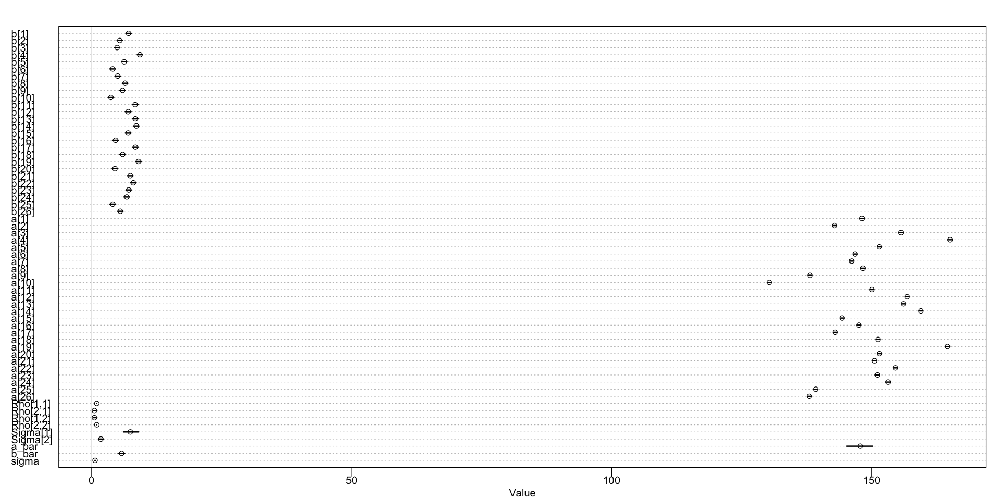

In [189]:
par(bg = 'white')
pre <- precis(m14h4, depth = 3)
print(pre)
plot(pre)

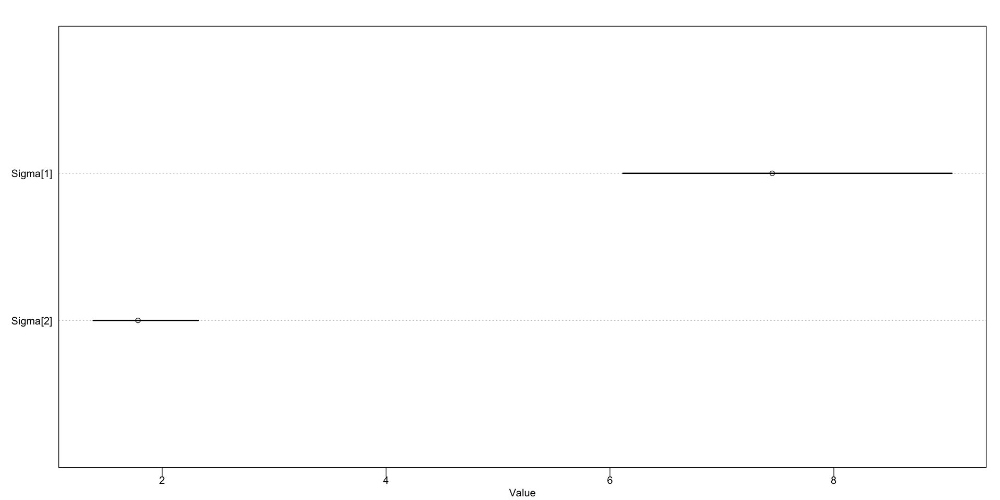

In [190]:
par(bg = 'white')
plot(precis(m14h4, depth = 3, pars="Sigma"))

Unexpectedly, it's the difference in the $\alpha$ paramater (`\Sigma[1]`) that is giving us more variation.

**14H5** Now consider the correlation between the varying intercepts and slopes. Can you explain its value? How would this estimated correlation influence your predictions about a new sample of boys?

**Answer**

              mean        sd      5.5%     94.5%      rhat ess_bulk
Rho[1,1] 1.0000000 0.0000000 1.0000000 1.0000000        NA       NA
Rho[2,1] 0.5381523 0.1413333 0.2902174 0.7407049 0.9999478 2878.383
Rho[1,2] 0.5381523 0.1413333 0.2902174 0.7407049 0.9999478 2878.383
Rho[2,2] 1.0000000 0.0000000 1.0000000 1.0000000        NA       NA


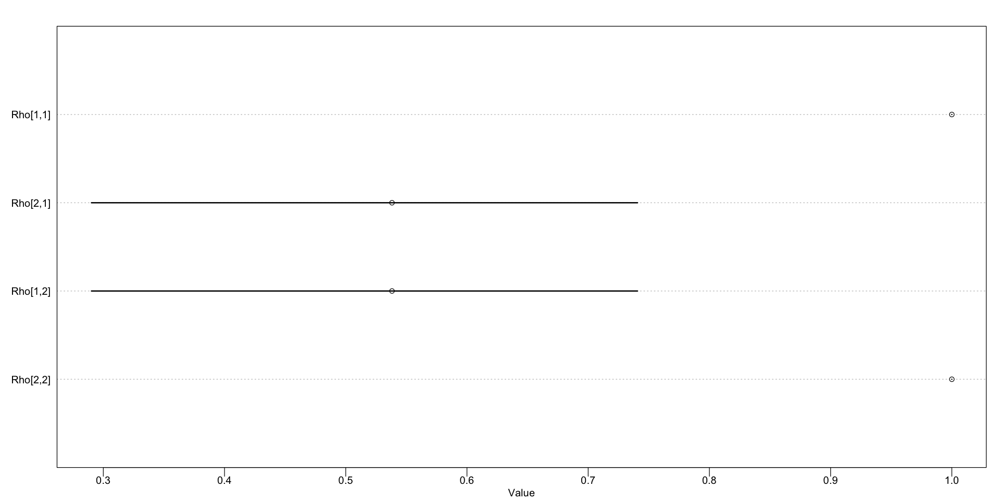

In [191]:
par(bg = 'white')
pre <- precis(m14h4, depth = 3, pars = "Rho")
print(pre)
plot(pre)

So the correlation between the intercept and the slope parameter is probably positive, with a mean of around 0.5. This tells us that if we see a boy come in who is taller than average, we also expect him to be growing faster than average.

**14H6** Use `mvrnorm` (in `library(MASS)`) or `rmnnorm` (in `library(mvtnorm)`) to simulate a new sample of boys, based on the posterior mean values of the parameters. That is, try to simulate varying intercepts and slopes, using the relevant parameter estimates, and then plot the predicted trends of height on age, one trend for each simulated boy you produce. A sample of 10 simulated boys is plenty, to illustrate the lesson. You can ignore uncertainty in the posterior, just to make the problem a little bit easier. But if you want to include the uncertainty about the parameters, go for it. Note that you can construct an arbitrary variance-covariance matrix to pass to either `mvrnorm` or `rmvnorm` with something like

```R
s <- matrix(c(sa^2, sa * sb * rho, sa * sb * rho, sb^2), nrow = 2)
```

where `sa` is the standard deviation of the first variable, `sb` is the standard deviation of the second variable, and `rho` is the correlation.

**Answer** I'm going to start by ignoring any uncertainty in the parameter values.

In [192]:
post <- extract.samples(m14h4)

num_boys <- 10
ages <- seq(from = -1, to = 1, length.out = 20)

sigma <- mean(post$sigma)
a_bar <- mean(post$a_bar)
b_bar <- mean(post$b_bar)
mv_mean <- c(a_bar, b_bar)
sa <- mean(post$Sigma[, 1])
sb <- mean(post$Sigma[, 2])
rho <- mean(post$Rho[, 1, 2])
mv_sigma <- matrix(c(sa ^ 2, sa * sb * rho, sa * sb * rho, sb^2), nrow = 2)

simulated_data <- data.frame(subject = integer(), age = numeric(), height = numeric())

for (subject in 1:num_boys) {
    params <- rmvnorm(1, mean = mv_mean, sigma = mv_sigma)
    mu <- params[1] + params[2] * ages
    heights <- rnorm(length(mu), mu, sigma)
    subject_data <- data.frame(
        subject = subject,
        age = ages,
        height = heights
    )
    simulated_data <- rbind(
        simulated_data,
        subject_data
    )
}

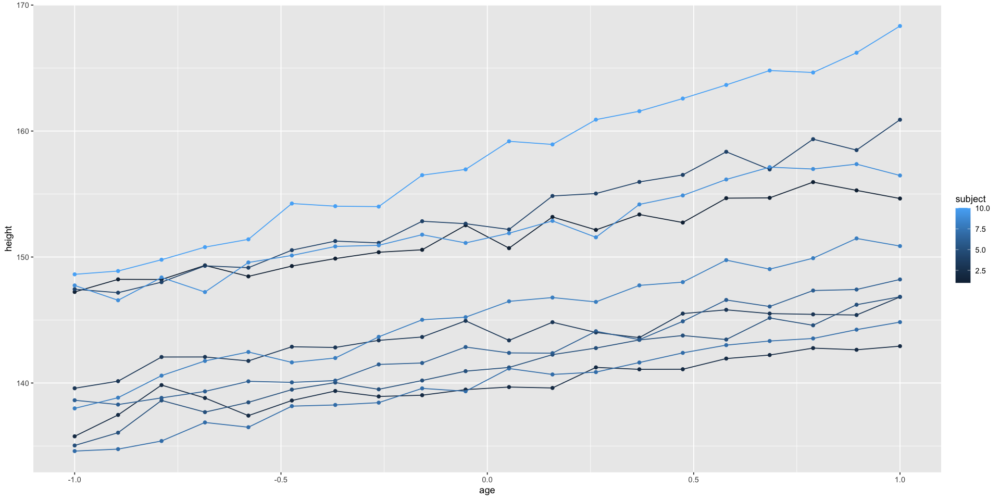

In [193]:
ggplot(simulated_data, aes(age, height, group = subject, colour = subject)) +
    geom_point() +
    geom_line()